# QVAP: Análise de dados 

Neste relatório tratamos e exploramos as respostas à consulta pública disponível em: https://contribua.org/project/QVAP/. A consulta pública foi a ferramenta de pesquisa utilizada para colher a opinião dos consumidores acerca da impressão de sustentabilidade em embalagens alimentícias. Antes de proceguir com a leitura deste relatório, recomenda-se fortemente a leitura completa da tese de doutorado da aluna Thamyres Oliveira Clementino da UFPE (https://futuro_link).

## Introdução

Inicialmente,  foi feita uma análise mais visual dos dados, como se comportam por grupo social, qual a relação entre cada atributo e o que cada respondente afirmou separadamente.

Em seguida, aplicamos diversos modelos de predição aos dados tratados afim de isolar aquele mais acurado. Para tal, estratégias de Aprendizagem de Máquina Automatizada foram aplicados com o intuito de obter resultados mais confiáveis.

Por fim, aplicamos um modelo de explicação e justificação de dados. Tal abordagem foi útil para descrever quais atributos estavam relacionados a cada resultado.



In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import sklearn
import tpot
import lime
from tpot import TPOTClassifier

from tpot import TPOTRegressor
from sklearn import metrics

In [2]:
import json
import warnings
import sys
from platform import python_version

In [3]:
import pylab as pl
import matplotlib
import matplotlib.pyplot as plt
from scipy.stats import skew
from scipy.stats.stats import pearsonr

In [4]:
%config InlineBackend.figure_format = 'retina' #set 'png' on notebooks

pd.options.mode.chained_assignment = None
seed=101
np.random.seed(seed)

In [5]:
# Definindo a classe color para melhoria dos prints
class color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

In [6]:
# Versões utilizadas
print('Python version is {}.'.format(python_version()))
print('Scikit-learn version is {}.'.format(sklearn.__version__))
print('TPOT version is {}.'.format(tpot.__version__))

Python version is 3.6.9.
Scikit-learn version is 0.21.3.
TPOT version is 0.11.0.


## Os Dados

Campos presente em cada registro de resposta do questionário, correspondendo a uma pergunta:

1. task_run__calibration: None
2. task_run__created: Data e hora de início da pergunta
3. task_run__external_uid: ID do usuário respondente
4. task_run__finish_time: Data e hora de início da resposta
5. task_run__id: ID interno da plataforma contribua.org
6. task_run__info: Links para cada as imágens de cada uma das embalagens avaliada e dados do questionário socioeconômico, além das respostas para as questões discursivas, em formato JSON
7. task_run__project_id: ID do projeto na plataforma contribua.org
8. task_run__task_id: ID da tarefa/pergunta
9. task_run__timeout: Tempo de resposta
10. task_run__user_id: ID do usuário respondente indentificado (apenas caso tenha conta na plataforma contribua.org)
11. task_run__user_ip: IP do computador do respondente
12. task_runinfo__id: ID da instância do questionário
13. task_runinfo__order: Posição da pergunta no questionário sendo respondido (1, 2, 3,.. ,15)
14. task_runinfo__question: Texto da pergunda ("Qual das embalagens lhe parece mais sustentável?")
15. task_runinfo__theLess: Embalagem entendida como menos sustentável (URL)
16. task_runinfo__theMost: Embalagem entendida como mais sustentável (URL)
17. task_runinfo__url_first: Primeira embalagem comparada (URL)
18. task_runinfo__url_fourth: Quarta embalagem comparada (URL)
19. task_runinfo__url_second: Segunda embalagem comparada (URL)
20. task_runinfo__url_third: Terceira embalagem comparada (URL)

Como é possível observar, cada registro de resposta replica todo o questionário socioeconômico e as duas perguntas discursivas. Aqueles que responderam "não" à primeira pergunta discursiva tiveram suas respostas descartadas.



In [7]:
tasks4 = pd.read_json('data/tasks4.json')#, lines=True)
tasks5 = pd.read_json('data/tasks5.json')#, lines=True)

In [8]:
packagings = pd.read_csv('data/packagings.csv')

In [9]:
info4=pd.io.json.json_normalize(tasks4['info'])
info5=pd.io.json.json_normalize(tasks5['info'])

tasks4=tasks4.join(info4, rsuffix='_info')

tasks5=tasks5.join(info5, rsuffix='_info')

tasks = pd.concat([tasks4,tasks5])

In [10]:
tasks

,info,external_uid,user_id,task_id,created,finish_time,calibration,user_ip,timeout,project_id,...,userProfile.city,userProfile.educ,userProfile.age,userProfile.background_02,userProfile.background_01,userProfile.state,userProfile.opinion,userProfile.sex,userProfile.email,userProfile.clas
0,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70306,2019-08-21T00:28:23.491380,2019-08-21 00:32:04.850937,NaN,187.183.202.214,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,socrateslg@gmail.com,media
1,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70307,2019-08-21T00:32:05.021768,2019-08-21 00:32:30.468938,NaN,187.183.202.214,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,socrateslg@gmail.com,media
2,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70308,2019-08-21T00:32:30.631919,2019-08-21 00:32:40.130400,NaN,187.183.202.214,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,socrateslg@gmail.com,media
3,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70309,2019-08-21T00:32:40.274861,2019-08-21 00:32:48.542194,NaN,187.183.202.214,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,socrateslg@gmail.com,media
4,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70310,2019-08-21T00:32:48.718667,2019-08-21 00:32:54.215483,NaN,187.183.202.214,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,socrateslg@gmail.com,media
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1409,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70540,2019-11-21T18:46:52.415280,2019-11-21 18:47:16.119306,NaN,177.37.156.1,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,arilittle2@gmail.com,media baixa
1410,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70653,2019-11-21T18:47:16.324373,2019-11-21 18:47:38.408154,NaN,177.37.156.1,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,arilittle2@gmail.com,media baixa
1411,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,70592,2019-11-21T18:47:38.615391,2019-11-21 18:47:55.436913,NaN,177.37.156.1,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,,M,arilittle2@gmail.com,media baixa
1412,{'url_second': 'https://drive.google.com/uc?ex...,NaN,NaN,69928,2019-11-21T18:47:55.674506,2019-11-21 18:54:48.970070,NaN,177.37.156.1,NaN,644,...,Campina Grande,superior completo,37,yes,yes,Paraíba,"O material da embalagem, ou a aparência desse...",M,arilittle2@gmail.com,media baixa


### Informações socio 

1. Escolaridade

In [11]:
recipe = tasks['userProfile.educ'].value_counts()
[i + ': ' + x.__str__() for i,x in recipe.iteritems()]

['superior completo: 742',
 'especializacao: 596',
 'mestrado: 494',
 'superior incompleto: 331',
 'doutorado: 303',
 'medio: 115',
 'fundamental: 20',
 'pos-doutorado: 6',
 'tecnico: 1']

In [10]:
tasks_grouped = tasks.groupby(['userProfile.email']).first()
len(tasks_grouped)

112

In [11]:


tasks_male_age_1 = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)
tasks_male_age_2 = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)
tasks_female_age_1 = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)
tasks_female_age_2 = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)


tasks_age_1 = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)
tasks_age_2 = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)

tasks_male = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)
tasks_female = pd.DataFrame([],columns=tasks.columns).set_index(['userProfile.email'],drop=True)


In [12]:
#gera bases de dados alternativas como exercício para implementação do aplicativo
ages = tasks_grouped.sort_values(by=['userProfile.age'])

half = len(ages)/2
count = 0
for i,v in ages.iterrows():
    if(count<half):
        tasks_age_1=tasks_age_1.append(tasks.loc[tasks['userProfile.email'] == i])
        if(v['userProfile.sex'] == 'F'):
            tasks_female_age_1=tasks_female_age_1.append(tasks.loc[tasks['userProfile.email'] == i])
            tasks_female=tasks_female.append(tasks.loc[tasks['userProfile.email'] == i])
        elif(v['userProfile.sex'] == 'M'):
            tasks_male_age_1=tasks_male_age_1.append(tasks.loc[tasks['userProfile.email'] == i])
            tasks_male=tasks_male.append(tasks.loc[tasks['userProfile.email'] == i])
    else:
        tasks_age_2=tasks_age_2.append(tasks.loc[tasks['userProfile.email'] == i])
        if(v['userProfile.sex'] == 'F'):
            tasks_female_age_2=tasks_female_age_2.append(tasks.loc[tasks['userProfile.email'] == i])
            tasks_female=tasks_female.append(tasks.loc[tasks['userProfile.email'] == i])
        elif(v['userProfile.sex'] == 'M'):
            tasks_male_age_2=tasks_male_age_2.append(tasks.loc[tasks['userProfile.email'] == i])
            tasks_male=tasks_male.append(tasks.loc[tasks['userProfile.email'] == i])
    count = count + 1
        
    

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\pandas\core\frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


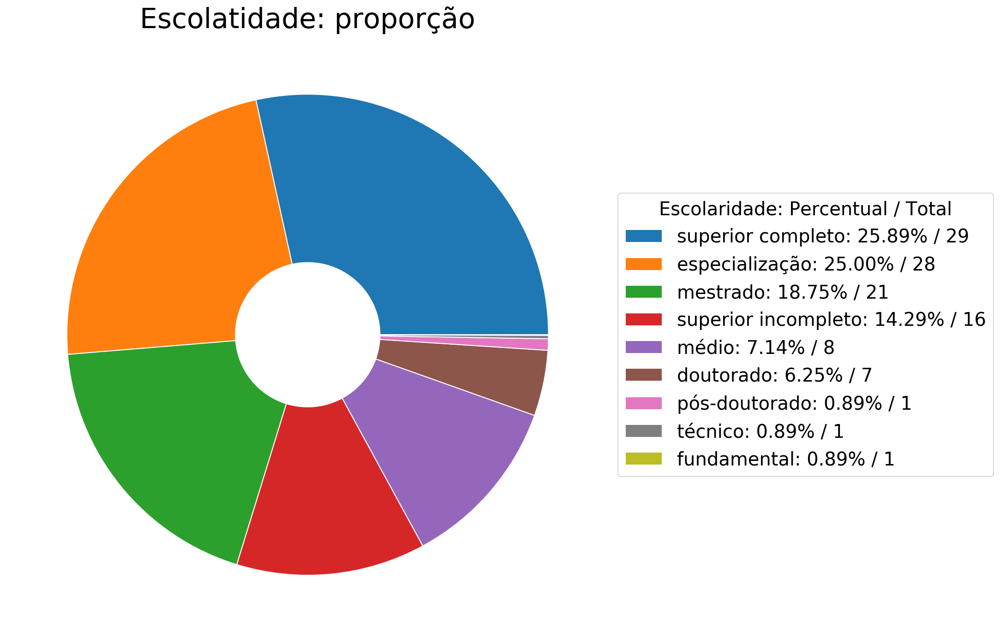

In [63]:
#my_circle = plt.Circle((0,0),0.4,color='white')
#tasks['userProfile.educ'].value_counts().plot(kind='pie', title='Escolaridade', autopct='%.2f%%', pctdistance=0.65,colors=['blue','skyblue'])
recipe = tasks_grouped['userProfile.educ'].value_counts()

def perc(sum_, me):
    absolute = me*100/sum_
    return "{:.2f}%".format(absolute)
sum_ = sum(recipe)
labels = [i for i,x in recipe.iteritems()]
labels_aux = labels.copy()
for i in range(len(labels_aux)):
    if labels_aux[i] == 'especializacao':
        labels[i] = 'especialização'
    elif labels_aux[i] == 'tecnico':
        labels[i] = 'técnico'
    elif labels_aux[i] == 'medio':
        labels[i] = 'médio'
    elif labels_aux[i] == 'pos-doutorado':
        labels[i] = 'pós-doutorado'
labels = [i + ': ' + perc(sum_,x).__str__() + ' / ' + x.__str__() for i,x in zip(labels,recipe)]# [recipe[0][x] + ': ' + perc(sum_,recipe[1][x]).__str__() for x in range(len(recipe[1]))]

fig, ax = plt.subplots(figsize=(24, 12), subplot_kw=dict(aspect="equal"))

def func(pct, allvals):
    absolute = int(pct/100.*np.sum(allvals))
    return "{:.1f}%\n({:d} g)".format(pct, absolute)

wedges, texts = ax.pie(tasks['userProfile.educ'].value_counts(), wedgeprops=dict(width=0.7, edgecolor='w'))



ax.legend(wedges, labels,
          title="Escolaridade: Percentual / Total",
          loc="center left",
          fontsize=20,
          bbox_to_anchor=(1, 0, 0.5, 1))

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")

ax.get_legend().get_title().set_fontsize(20)
ax.set_title("Escolatidade: proporção",fontsize=30)

plt.savefig('escolaridade.png')
#plt.show()

2. Gênero

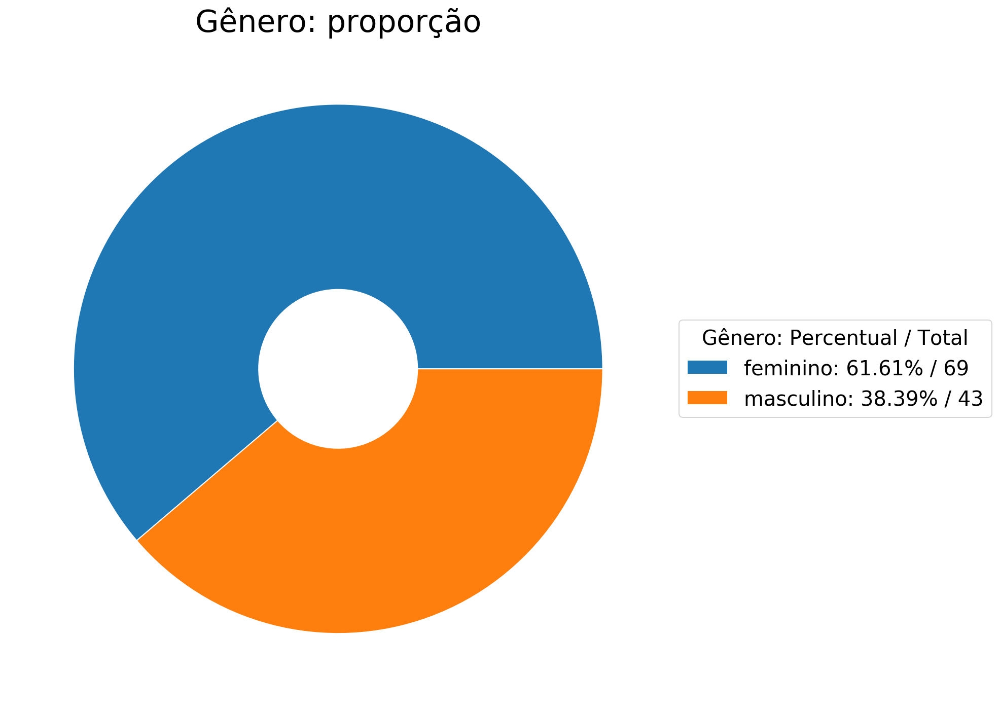

In [16]:
#my_circle = plt.Circle((0,0),0.4,color='white')
#tasks['userProfile.educ'].value_counts().plot(kind='pie', title='Escolaridade', autopct='%.2f%%', pctdistance=0.65,colors=['blue','skyblue'])
recipe = tasks_grouped['userProfile.sex'].value_counts()

sum_ = sum(recipe)
names='masculino','feminino'
labels = [('feminino' if i == 'F' else 'masculino') + ': ' + perc(sum_,x).__str__() + ' / ' + x.__str__() for i,x in recipe.iteritems()]# [recipe[0][x] + ': ' + perc(sum_,recipe[1][x]).__str__() for x in range(len(recipe[1]))]

fig, ax = plt.subplots(figsize=(24, 12), subplot_kw=dict(aspect="equal"))

wedges, texts = ax.pie(tasks['userProfile.sex'].value_counts(), wedgeprops=dict(width=0.7, edgecolor='w'))



ax.legend(wedges, labels,
          title="Gênero: Percentual / Total",#labels=names, 
          loc="center left",
          fontsize=20,
          bbox_to_anchor=(1, 0, 0.5, 1))

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")

ax.get_legend().get_title().set_fontsize(20)
ax.set_title("Gênero: proporção",
          fontsize=30)

plt.savefig('genero.png')
#plt.show()

3. Estado (Unidade Federativa)

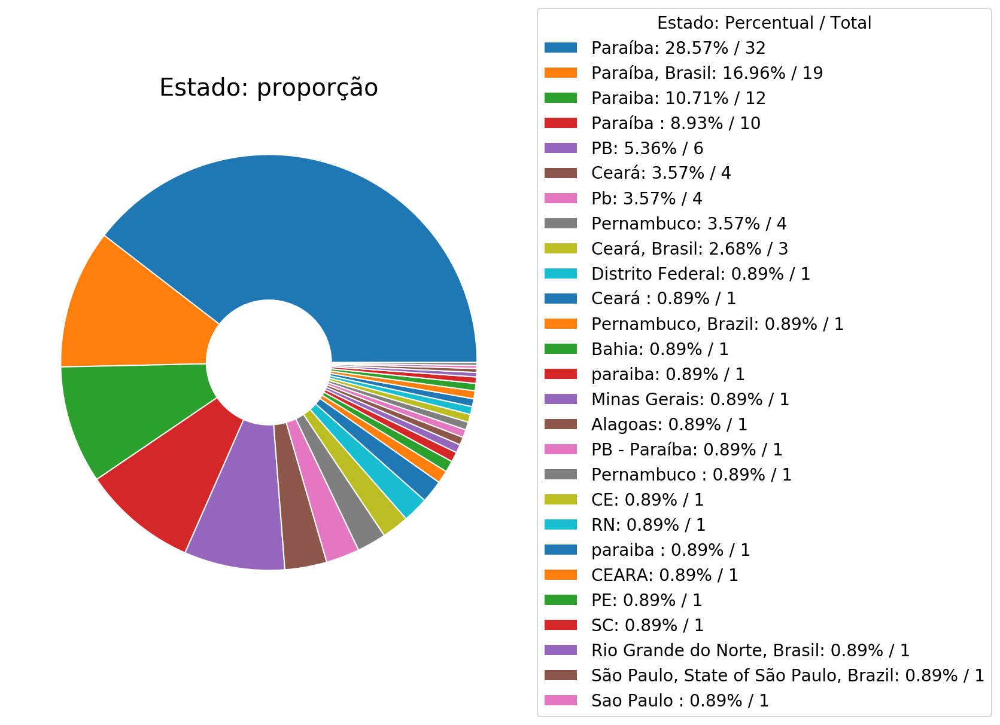

In [17]:
#my_circle = plt.Circle((0,0),0.4,color='white')
#tasks['userProfile.educ'].value_counts().plot(kind='pie', title='Escolaridade', autopct='%.2f%%', pctdistance=0.65,colors=['blue','skyblue'])
recipe = tasks_grouped['userProfile.state'].value_counts()

sum_ = sum(recipe)
labels = [i + ': ' + perc(sum_,x).__str__() + ' / ' + x.__str__() for i,x in recipe.iteritems()]# [recipe[0][x] + ': ' + perc(sum_,recipe[1][x]).__str__() for x in range(len(recipe[1]))]

fig, ax = plt.subplots(figsize=(16, 8), subplot_kw=dict(aspect="equal"))
#names='Campina Grande','Outras'
wedges, texts = ax.pie(tasks['userProfile.state'].value_counts(), wedgeprops=dict(width=0.7, edgecolor='w'))



ax.legend(wedges, labels,
          title="Estado: Percentual / Total", 
          loc="center left",
          fontsize=14,
          bbox_to_anchor=(1, 0, 0.5, 1))

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")

ax.get_legend().get_title().set_fontsize(14)
ax.set_title("Estado: proporção",
          fontsize=20)

plt.savefig('estado.png')
#plt.show()

3. Pergunta Discrimitava 01 (Você conhece algum destes termos: Sustentabilidade, valor ambiental ou orientação ecológica?)

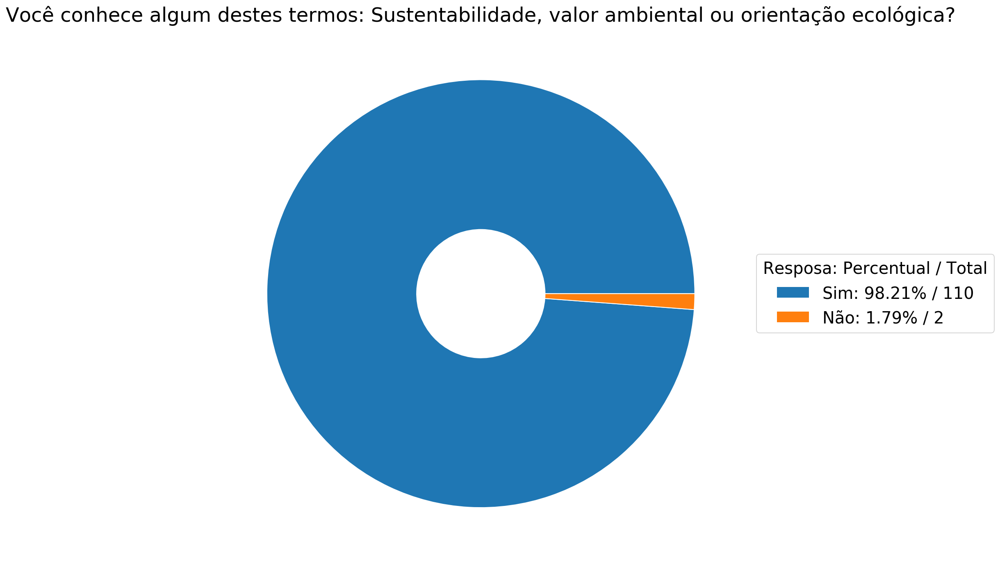

In [18]:
#my_circle = plt.Circle((0,0),0.4,color='white')
#tasks['userProfile.educ'].value_counts().plot(kind='pie', title='Escolaridade', autopct='%.2f%%', pctdistance=0.65,colors=['blue','skyblue'])
recipe = tasks_grouped['userProfile.background_01'].value_counts()

names='Sim','Não'
sum_ = sum(recipe)
labels = [('Sim' if i == 'yes' else 'Não') + ': ' + perc(sum_,x).__str__() + ' / ' + x.__str__() for i,x in recipe.iteritems()]# [recipe[0][x] + ': ' + perc(sum_,recipe[1][x]).__str__() for x in range(len(recipe[1]))]

fig, ax = plt.subplots(figsize=(24, 12), subplot_kw=dict(aspect="equal"))

wedges, texts = ax.pie(tasks['userProfile.background_01'].value_counts(), wedgeprops=dict(width=0.7, edgecolor='w'))



ax.legend(wedges, labels,
          title="Resposa: Percentual / Total",#labels=names, 
          loc="center left",
          fontsize=20,
          bbox_to_anchor=(1, 0, 0.5, 1))

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")

ax.get_legend().get_title().set_fontsize(20)
ax.set_title("Você conhece algum destes termos: Sustentabilidade, valor ambiental ou orientação ecológica?",
          fontsize=24)

plt.savefig('background_01.png')
#plt.show()

4. Pergunta discriminativa 02 (Você sabe o que são embalagens ecologicamente sustentáveis?)

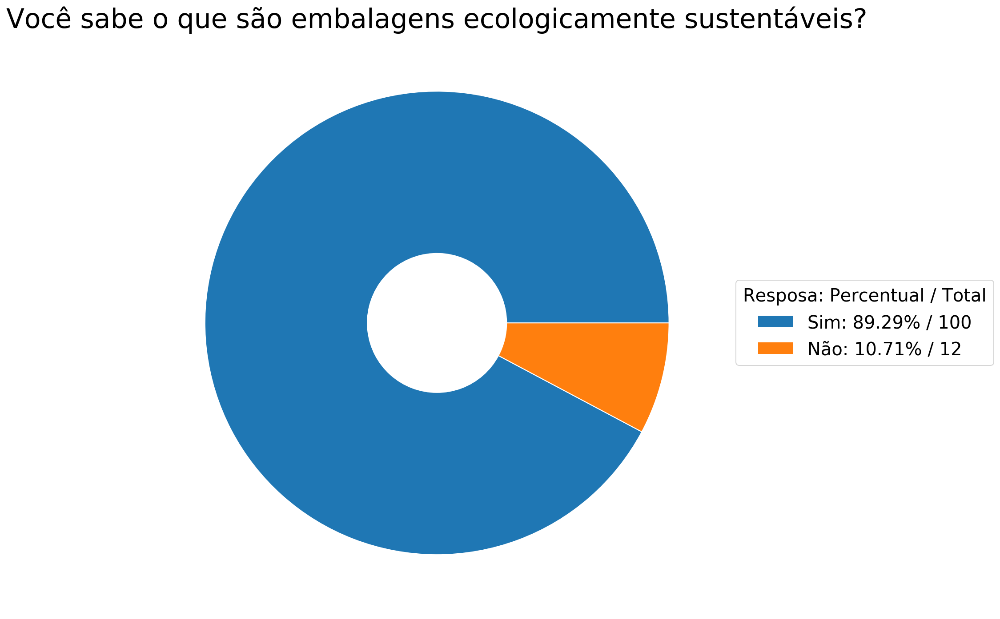

In [19]:
#my_circle = plt.Circle((0,0),0.4,color='white')
#tasks['userProfile.educ'].value_counts().plot(kind='pie', title='Escolaridade', autopct='%.2f%%', pctdistance=0.65,colors=['blue','skyblue'])
recipe = tasks_grouped['userProfile.background_02'].value_counts()

sum_ = sum(recipe)
names='Sim','Não'
labels = [('Sim' if i == 'yes' else 'Não') + ': ' + perc(sum_,x).__str__() + ' / ' + x.__str__() for i,x in recipe.iteritems()]# [recipe[0][x] + ': ' + perc(sum_,recipe[1][x]).__str__() for x in range(len(recipe[1]))]

fig, ax = plt.subplots(figsize=(24, 12), subplot_kw=dict(aspect="equal"))

wedges, texts = ax.pie(tasks['userProfile.background_02'].value_counts(), wedgeprops=dict(width=0.7, edgecolor='w'))



ax.legend(wedges, labels,
          title="Resposa: Percentual / Total",#labels=names, 
          loc="center left",
          fontsize=20,
          bbox_to_anchor=(1, 0, 0.5, 1))

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")
ax.get_legend().get_title().set_fontsize(20)

ax.set_title("Você sabe o que são embalagens ecologicamente sustentáveis?",fontsize=30)

plt.savefig('background_02.png')
#plt.show()

5. Faixa Etária

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\ipykernel_launcher.py:45: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.


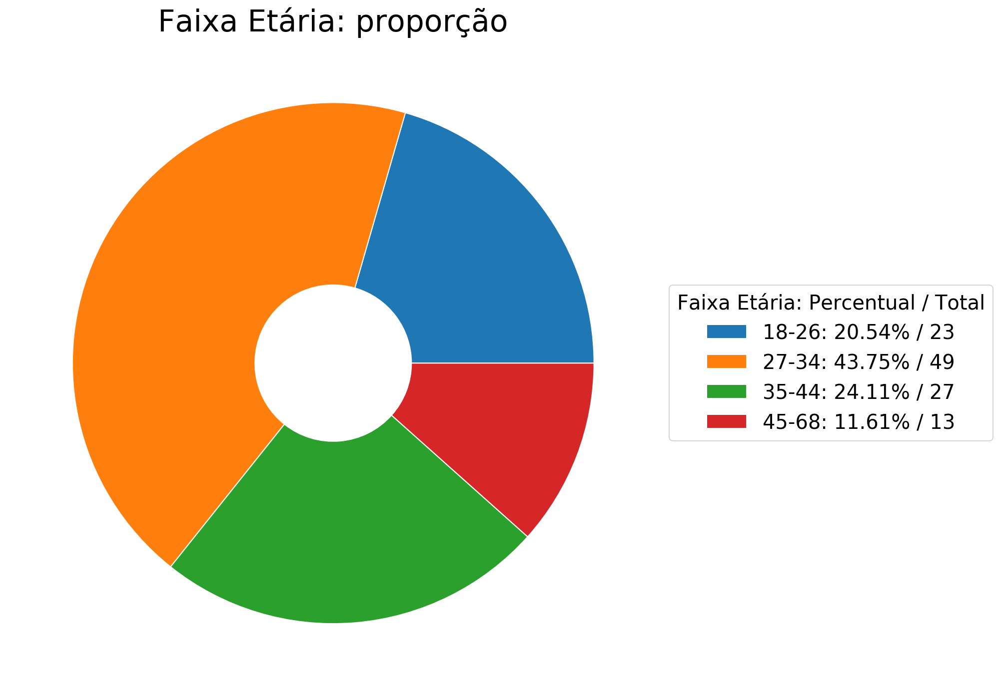

In [21]:
#my_circle = plt.Circle((0,0),0.4,color='white')
#tasks['userProfile.educ'].value_counts().plot(kind='pie', title='Escolaridade', autopct='%.2f%%', pctdistance=0.65,colors=['blue','skyblue'])

values = tasks_grouped['userProfile.age'].value_counts().sort_index()

total = len(values)#len(tasks['userProfile.age'].unique())

itens = total // 4
grupo = 1
count = 0
label = ''
soma = 0

labels = []
somas = []

for i, x in values.iteritems():

    count = count + 1
    soma = soma + x
    
    if count >= itens:
        label = label + i.__str__()
        labels.append(label)
        #soma = soma + x
        somas.append(soma)
        count = 0
        label = ''
        soma = 0
    elif count == 1:
        label = i.__str__() + "-"

    
    
values = pd.DataFrame({'labels':labels,'somas':somas})


recipe = values.set_index('labels',drop=True)

sum_ = sum(recipe['somas'])
labels = [i.__str__() + ': ' + perc(sum_,x.values[0]).__str__() + ' / ' + x[0].__str__() for i,x in recipe.iterrows()]# [recipe[0][x] + ': ' + perc(sum_,recipe[1][x]).__str__() for x in range(len(recipe[1]))]

fig, ax = plt.subplots(figsize=(24, 12), subplot_kw=dict(aspect="equal"))
#names='masculino','feminino'
wedges, texts = ax.pie(recipe, wedgeprops=dict(width=0.7, edgecolor='w'))



ax.legend(wedges, labels,
          title="Faixa Etária: Percentual / Total",#labels=names, 
          loc="center left",
          fontsize=20,
          bbox_to_anchor=(1, 0, 0.5, 1))

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")


ax.get_legend().get_title().set_fontsize(20)

ax.set_title("Faixa Etária: proporção",fontsize=30)


plt.savefig('faixa_etaria.png')
#plt.show()

## Análise de indicadores técnicos

In [14]:
'''Determina a ordem de preferência entre uma embalagem e outra.
Cada resposta gera 6 ordens de preferências. Quando o usuário define 'theMost' ele coloca aquela embalagem à frente das outras três (três ordens de preferência).
O oposto ocorre quando o usuário define a embalegem 'theLess', colocando-a atrás das outras três em três ordens de preferência.
Este método define uma ordem de preferência de cada vez, precisando ser chamado seis vezes.'''
def return_comparisons_2(tasks, theMost, theLess, result, task_test = None):
    
    if task_test is not None:
        tasks_test = pd.DataFrame(data=[elem for index, elem in tasks.iterrows() if task_test in [elem['url_first'], elem['url_second'], elem['url_third'], elem['url_fourth']] ],columns=tasks.columns)

    else:
        tasks_test = pd.DataFrame(columns=tasks.columns)

    comparisons_test = tasks_test.loc[:, [theMost, theLess, 'userProfile.email']]
    comparisons_comparisons = tasks.loc[:, [theMost, theLess, 'userProfile.email']]
    
    comparisons_test = comparisons_test[comparisons_test[theMost]!=comparisons_test[theLess]]
    comparisons_comparisons = comparisons_comparisons[comparisons_comparisons[theMost]!=comparisons_comparisons[theLess]]
    comparisons_test.columns = ["theMost", "theLess", 'userProfile.email']
    comparisons_comparisons.columns = ["theMost", "theLess", 'userProfile.email']
    
    comparisons_test['result']=result
    comparisons_comparisons['result']=result

    return (comparisons_comparisons, comparisons_test)

def return_all_comparisons_2(data, task_test = None):
    
    #recupera todas as comparações onde a primeira, segunda, terceira ou quata URL não foram escolhidas como 'theMost'
    comparisons_1, tests_1 = return_comparisons_2(data, 'theMost', 'url_first', True, task_test)
    comparisons_2, tests_2 = return_comparisons_2(data, 'theMost', 'url_second', True, task_test)
    comparisons_3, tests_3 = return_comparisons_2(data, 'theMost', 'url_third', True, task_test)
    comparisons_4, tests_4 = return_comparisons_2(data, 'theMost', 'url_fourth', True, task_test)

    #recupera todas as comparações onde a primeira, segunda, terceira ou quata URL não foram escolhidas como 'theLess'
    comparisons_5, tests_5 = return_comparisons_2(data, 'theLess', 'url_first', False, task_test)
    comparisons_6, tests_6 = return_comparisons_2(data, 'theLess', 'url_second', False, task_test)
    comparisons_7, tests_7 = return_comparisons_2(data, 'theLess', 'url_third', False, task_test)
    comparisons_8, tests_8 = return_comparisons_2(data, 'theLess', 'url_fourth', False, task_test)

    #concatena todas as comprações (ordens de precedência)
    comparisons_aux = [comparisons_1, comparisons_2, comparisons_3, comparisons_4, comparisons_5, comparisons_6, comparisons_7, comparisons_8]
    #eliminar no futuro
    tests_aux = [tests_1, tests_2, tests_3, tests_4, tests_5, tests_6, tests_7, tests_8]

    comparisons_train = pd.concat(comparisons_aux,sort=False,ignore_index=True)
    comparisons_tests = pd.concat(tests_aux,sort=False,ignore_index=True)
    comparisons_train.reset_index(drop=True,inplace=True)
    comparisons_tests.reset_index(drop=True,inplace=True)
    
    if(task_test is None):
        return comparisons_train
    else:
        return comparisons_train,comparisons_tests

In [15]:
'''Inclui os atributos de cada URL no dataframe (direto do dataframe packagings), além de adicionar a URL no index do dataframe (não admite multi índex)'''
def set_attributes(data,uRL_name):
    aux_packagings = packagings.copy()
    aux_packagings.columns = aux_packagings.columns.str.cat(["_"+uRL_name if x != 'id' and x != 'URL' else "" for x in aux_packagings.columns], sep ="")
    result = aux_packagings.set_index('URL').join(data.set_index(uRL_name), how='inner', lsuffix='_'+uRL_name)
    return result

In [16]:
'''Inclui os atributos de cada URL no dataframe (direto do dataframe packagings), além de adicionar a URL no index do dataframe (gerando um index multiplo ou não)'''
def set_attributes_2(data,uRL_name,multiple_idx=False):
    index = data.sort_values(by=[uRL_name]).index
    aux_packagings = packagings.copy()
    aux_packagings.columns = aux_packagings.columns.str.cat(["_"+uRL_name if x != 'id' and x != 'URL' else "" for x in aux_packagings.columns], sep ="")
    result = aux_packagings.set_index('URL',drop=True).join(data.sort_values(by=[uRL_name]).set_index(uRL_name,drop=True), how='right', lsuffix='_'+uRL_name)
    if(multiple_idx):
        index = pd.MultiIndex.from_frame(pd.DataFrame(data={index.name: index, uRL_name: result.index}))#, names=['URL', uRL_name])
        return result.set_index(index)
    else:
        result[uRL_name] = result.index

        return result.set_index(uRL_name)#.drop([uRL_name], axis=1)

A partir daqui iniciaremos o tratamento concreto dos dados. O código abaixo transforma as `tasks` de cada linha de dados da nossa base, em relações de precedência entre duas embalagens (`theMost` é melhor que `theLess`)

In [17]:

packagin_index = 1211#aleatório

packaging_column = 'url_first'#aleatório

tasks.loc[packagin_index].at[packaging_column]

# #recupera todas as comparações onde a primeira, segunda, terceira ou quata URL não foram escolhidas como 'theMost'
# comparisons_1, tests_1 = return_comparisons_2(tasks, 'theMost', 'url_first', True, tasks.loc[packagin_index].at[packaging_column])
# comparisons_2, tests_2 = return_comparisons_2(tasks, 'theMost', 'url_second', True, tasks.loc[packagin_index].at[packaging_column])
# comparisons_3, tests_3 = return_comparisons_2(tasks, 'theMost', 'url_third', True, tasks.loc[packagin_index].at[packaging_column])
# comparisons_4, tests_4 = return_comparisons_2(tasks, 'theMost', 'url_fourth', True, tasks.loc[packagin_index].at[packaging_column])

# #recupera todas as comparações onde a primeira, segunda, terceira ou quata URL não foram escolhidas como 'theLess'
# comparisons_5, tests_5 = return_comparisons_2(tasks, 'theLess', 'url_first', False, tasks.loc[packagin_index].at[packaging_column])
# comparisons_6, tests_6 = return_comparisons_2(tasks, 'theLess', 'url_second', False, tasks.loc[packagin_index].at[packaging_column])
# comparisons_7, tests_7 = return_comparisons_2(tasks, 'theLess', 'url_third', False, tasks.loc[packagin_index].at[packaging_column])
# comparisons_8, tests_8 = return_comparisons_2(tasks, 'theLess', 'url_fourth', False, tasks.loc[packagin_index].at[packaging_column])

# #concatena todas as comprações (ordens de precedência)
# comparisons_aux = [comparisons_1, comparisons_2, comparisons_3, comparisons_4, comparisons_5, comparisons_6, comparisons_7, comparisons_8]
# #eliminar no futuro
# tests_aux = [tests_1, tests_2, tests_3, tests_4, tests_5, tests_6, tests_7, tests_8]

# comparisons_train = pd.concat(comparisons_aux,sort=False,ignore_index=True)
# comparisons_tests = pd.concat(tests_aux,sort=False,ignore_index=True)
# comparisons_train.reset_index(drop=True,inplace=True)
# comparisons_tests.reset_index(drop=True,inplace=True)

comparisons_train,comparisons_tests = return_all_comparisons_2(tasks, tasks.loc[packagin_index].at[packaging_column])

comparisons_train_male_age_1   = return_all_comparisons_2(tasks_male_age_1, None)
comparisons_train_male_age_2   = return_all_comparisons_2(tasks_male_age_2, None)
comparisons_train_female_age_1 = return_all_comparisons_2(tasks_female_age_1, None)
comparisons_train_female_age_2 = return_all_comparisons_2(tasks_female_age_2, None)
comparisons_train_age_1        = return_all_comparisons_2(tasks_age_1, None)
comparisons_train_age_2        = return_all_comparisons_2(tasks_age_2, None)
comparisons_train_male         = return_all_comparisons_2(tasks_male, None)
comparisons_train_female       = return_all_comparisons_2(tasks_female, None)

def get_data(index):
    if(index == 1):
        return comparisons_train_male_age_1
    elif(index == 2):
        return comparisons_train_female_age_1
    elif(index == 3):
        return comparisons_train_male_age_2
    elif(index == 4):
        return comparisons_train_female_age_2
    elif(index == 5):
        return comparisons_train_age_1
    elif(index == 6):
        return comparisons_train_age_2
    elif(index == 7):
        return comparisons_train_male
    elif(index == 8):
        return comparisons_train_female
    else:
        return None


O código abaixo converte as `URLs` simples no conjunto complet ode atributos da embalagem menos sustentável e da mais sustentável (`theLess`e `theMost`, respectivamente)

In [18]:
def most_and_less(data):
    ready = set_attributes_2(data,"theMost",False)
    ready = set_attributes_2(ready,"theLess",True)
    return ready

# comparisons_train_ready = set_attributes_2(comparisons_train,"theMost",False)
# comparisons_train_ready = set_attributes_2(comparisons_train_ready,"theLess",True)
comparisons_train_ready = most_and_less(comparisons_train)

comparisons_train_male_age_1_ready = most_and_less(get_data(1))
comparisons_train_male_age_2_ready = most_and_less(get_data(3))
comparisons_train_female_age_1_ready = most_and_less(get_data(2))
comparisons_train_female_age_2_ready = most_and_less(get_data(4))
comparisons_train_age_1_ready = most_and_less(get_data(5))
comparisons_train_age_2_ready = most_and_less(get_data(6))
comparisons_train_male_ready = most_and_less(get_data(7))
comparisons_train_female_ready = most_and_less(get_data(8))



def get_data_ready(index):
    if(index == 1):
        return comparisons_train_male_age_1_ready
    elif(index == 2):
        return comparisons_train_female_age_1_ready
    elif(index == 3):
        return comparisons_train_male_age_2_ready
    elif(index == 4):
        return comparisons_train_female_age_2_ready
    elif(index == 5):
        return comparisons_train_age_1_ready
    elif(index == 6):
        return comparisons_train_age_2_ready
    elif(index == 7):
        return comparisons_train_male_ready
    elif(index == 8):
        return comparisons_train_female_ready
    else:
        return None

comparisons_train_ready

id_theLess  \
theMost                                            theLess                                                          
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...           6   
                                                   https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           6   
...                                                                                                           ...   
                                                   https://drive.google.com/uc?export=view&id=1zx-...           1   
                                                   https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=1Zsl... https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=142D... https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=1DM6... https://drive.google.com/uc?export=view&id=1zx-...           1   

                                                                                                      shape_theLess  \
theMost                                            theLess                                                            
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
...                                                                                                             ...   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=1Zsl... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=142D... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=1DM6... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   

                                                                                                      material_theLess  \
theMost                                            theLess                                                               
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
                                                   https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
...                                                                                                                ...   
                                                   https:

In [19]:
#recupera os dados do perfil sociocultural (via join)
#útil para analisar os resultados por perfil sociocultural (pode não servir)
comparisons_train_with_profile = comparisons_train_ready.join(tasks.loc[:,['userProfile.email','userProfile.city', 'userProfile.educ', 'userProfile.age', 'userProfile.state', 'userProfile.sex', 'userProfile.clas']].set_index('userProfile.email').groupby('userProfile.email').first(), on='userProfile.email', rsuffix='.profile')
comparisons_train_with_profile



id_theLess  \
theMost                                            theLess                                                          
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...           6   
                                                   https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           6   
...                                                                                                           ...   
                                                   https://drive.google.com/uc?export=view&id=1zx-...           1   
                                                   https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=1Zsl... https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=142D... https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=1DM6... https://drive.google.com/uc?export=view&id=1zx-...           1   

                                                                                                      shape_theLess  \
theMost                                            theLess                                                            
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
...                                                                                                             ...   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=1Zsl... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=142D... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=1DM6... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   

                                                                                                      material_theLess  \
theMost                                            theLess                                                               
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
                                                   https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
...                                                                                                                ...   
                                                   https:

In [21]:
#criar um método que retorne uma contagem pronta e agrupada por caracerística do perfil
#útil para analisar os resultados por perfil sociocultural (pode não servir)


'''Incrementa a pontuação de cada feature como uma contagem de sucessos simples'''
def counter_(data, factor):

    #cria a lista de features

    features_ = pd.DataFrame(columns=['nome','valor','score','occurrences','final.score'])
    cols = packagings.columns.drop(['id','URL'])
    for i in range(len(cols)):
        aux = packagings.loc[:][cols[i]].unique()
        for j in range(len(aux)):
            for v in data[factor].unique():
                features_ = features_.append(pd.DataFrame({'nome':[cols[i]],'valor':[aux[j]], factor: [v], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0}))

    for i,v in data.iterrows():
        count = -1
        if(v['result']):
            count = -count
        for x in data.columns:

            if(x.find('_theLess')>=0):
                aux = features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor]),'valor']
                if(len(aux)>0):
                    if(aux[0]==v[x]):
                        features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor]),'score'] = features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor])]['score'] - count
                        features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor]),'occurrences'] = features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor])]['occurrences'] + 1

            elif(x.find('_theMost')>=0):
                aux = features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor]),'valor']
                if(len(aux)>0):
                    if(aux[0]==v[x]):
                        features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor]),'score'] = features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor])]['score'] + count
                        features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor]),'occurrences'] = features_.loc[(features_['valor']==v[x])&(features_[factor]==v[factor])]['occurrences'] + 1

    return features_

In [20]:
#isola atributos de cada embalagem na base de testes iniciais (pode não ser utilizado)
comparisons_tests_ready = set_attributes_2(comparisons_tests,"theMost",False)
comparisons_tests_ready = set_attributes_2(comparisons_tests_ready,"theLess", True)
comparisons_tests_ready

id_theLess  \
theMost                                            theLess                                                          
https://drive.google.com/uc?export=view&id=1B5t... https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           6   
                                                   https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=1B5t... https://drive.google.com/uc?export=view&id=10Jz...           6   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           6   
...                                                                                                           ...   
https://drive.google.com/uc?export=view&id=1hwI... https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=1AIP... https://drive.google.com/uc?export=view&id=1zx-...           1   
                                                   https://drive.google.com/uc?export=view&id=1zx-...           1   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=1zx-...           1   
                                                   https://drive.google.com/uc?export=view&id=1zx-...           1   

                                                                                                      shape_theLess  \
theMost                                            theLess                                                            
https://drive.google.com/uc?export=view&id=1B5t... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=1B5t... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
...                                                                                                             ...   
https://drive.google.com/uc?export=view&id=1hwI... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=1AIP... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   

                                                                                                      material_theLess  \
theMost                                            theLess                                                               
https://drive.google.com/uc?export=view&id=1B5t... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
                                                   https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=1B5t... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
...                                                                                                                ...   
https://drive.google.com/uc?export=view&id=1hwI... https:

No código abaixo teremos os preparativos para criar uma lista de embalagens poderadas por susas percepções de sustentabilidade

In [21]:
#aqui apenas criamos a lista de scores, onde cada embalagem é pontuada em função da precedência em relação e número de ocorrências
firsts = pd.DataFrame(data={'name': tasks['url_first'], 'value': tasks['url_first'], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0})
seconds = pd.DataFrame(data={'URL': tasks['url_second'], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0})
thirds = pd.DataFrame(data={'URL': tasks['url_third'], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0})
fourths = pd.DataFrame(data={'URL': tasks['url_fourth'], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0})

scores_aux = [firsts, seconds, thirds, fourths]
scores = pd.concat(scores_aux,sort=False)

scores.sort_values("URL", inplace = True) 
scores_2 = scores.copy()
scores.drop_duplicates(subset ="URL", 
                     inplace = True) 

scores.reset_index(drop=True,inplace=True)
scores.reindex(['URL'])
scores

,name,value,score,occurrences,final.score,URL
0,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=10J...
1,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=113...
2,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=11N...
3,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=125...
4,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=12X...
...,...,...,...,...,...,...
60,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=1v4...
61,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=1vz...
62,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=1wF...
63,NaN,NaN,0.0,0,0.0,https://drive.google.com/uc?export=view&id=1zx...


In [22]:

results = tasks.loc[:, ['theMost', 'url_first','url_second','url_third','url_fourth','theLess']]
     
'''Aqui cada vez que a embalagem é apontada como mais sustentável 'theMost', ganha dois pontos.
Se não for apontada como menos sustentável, ganha um ponto.
Se for apontada como menos sustentável, perde um ponto.
[Apresentar referências para este sistema]
[Pode ser uma boa usar a pontuação de torneio, sendo 3 para mais, 1 para indiferente e zero para menos]
[Dividir pelo número de ocorrências pode ser uma boa também]'''
count = 0
for index_results, row_results in results.iterrows():
    for index_scores, row_scores in scores.iterrows():
        if row_results['theMost'] == row_scores['URL']:
            row_scores['score'] = row_scores['score'] + 2         
        if row_results['url_first'] == row_scores['URL']:
            count = count + 1
            row_scores['occurrences'] = row_scores['occurrences'] + 1
            row_scores['score'] = row_scores['score'] + 1 
        if row_results['url_second'] == row_scores['URL']:
            count = count + 1
            row_scores['occurrences'] = row_scores['occurrences'] + 1
            row_scores['score'] = row_scores['score'] + 1    
        if row_results['url_third'] == row_scores['URL']:
            count = count + 1
            row_scores['occurrences'] = row_scores['occurrences'] + 1
            row_scores['score'] = row_scores['score'] + 1     
        if row_results['url_fourth'] == row_scores['URL']:
            count = count + 1
            row_scores['occurrences'] = row_scores['occurrences'] + 1
            row_scores['score'] = row_scores['score'] + 1    
        if row_results['theLess'] == row_scores['URL']:
            row_scores['score'] = row_scores['score'] - 1    
        scores[index_scores:index_scores+1]['score'] = row_scores['score']
        scores[index_scores:index_scores+1]['occurrences'] = row_scores['occurrences']
    
scores['final.score'] = scores['score'].divide(scores['occurrences'], fill_value = 1)
scores

,name,value,score,occurrences,final.score,URL
0,NaN,NaN,162.0,149,1.087248,https://drive.google.com/uc?export=view&id=10J...
1,NaN,NaN,214.0,162,1.320988,https://drive.google.com/uc?export=view&id=113...
2,NaN,NaN,257.0,135,1.903704,https://drive.google.com/uc?export=view&id=11N...
3,NaN,NaN,303.0,150,2.020000,https://drive.google.com/uc?export=view&id=125...
4,NaN,NaN,350.0,242,1.446281,https://drive.google.com/uc?export=view&id=12X...
...,...,...,...,...,...,...
60,NaN,NaN,103.0,117,0.880342,https://drive.google.com/uc?export=view&id=1v4...
61,NaN,NaN,147.0,123,1.195122,https://drive.google.com/uc?export=view&id=1vz...
62,NaN,NaN,182.0,164,1.109756,https://drive.google.com/uc?export=view&id=1wF...
63,NaN,NaN,88.0,118,0.745763,https://drive.google.com/uc?export=view&id=1zx...


In [23]:
#Inclui os atributos de cada embalagem no datagram 'scores', gerando o 'scores_ready'
scores_ready = set_attributes(scores,"URL")
scores_ready=scores_ready.fillna(0)

In [26]:
scores_ready.head(60)

,id,shape_URL,material_URL,surface_URL,color_URL,constitution_URL,name,value,score,occurrences,final.score
URL,,,,,,,,,,,
https://drive.google.com/uc?export=view&id=1hwIG7voqAtG8Kpt3ntnhrPeZqjksG0ho,63,Orgânica,Vidro,Fosca,Neutra,Ordem,0,0,222.0,187,1.187166
https://drive.google.com/uc?export=view&id=1V6Ll04rBT6lSAVGdnXPEZpYZ1mMFqhvi,62,Orgânica,Vidro,Fosca,Neutra,Complexidade,0,0,189.0,160,1.181250
https://drive.google.com/uc?export=view&id=1_2if1BxHQvLhvXGcU7qPxtlr8_xKAM02,61,Orgânica,Vidro,Fosca,Intensa,Ordem,0,0,267.0,200,1.335000
https://drive.google.com/uc?export=view&id=1vzX7cDR4FzfTWoMQ_nuU6Fgdm7JNTcFb,60,Orgânica,Vidro,Fosca,Intensa,Complexidade,0,0,147.0,123,1.195122
https://drive.google.com/uc?export=view&id=12Xt1FjGTRXeL3p0Lq6yPA505H2ZSuFM4,59,Orgânica,Vidro,Brilhosa,Neutra,Ordem,0,0,350.0,242,1.446281
https://drive.google.com/uc?export=view&id=1im4nu1mLLAfHcwosuFwAHFm3SrYG6RpK,58,Orgânica,Vidro,Brilhosa,Neutra,Complexidade,0,0,253.0,181,1.397790
https://drive.google.com/uc?export=view&id=1AIPKMMAjqjvvraJZM7hYWuiaoAD02TTZ,57,Orgânica,Vidro,Brilhosa,Intensa,Ordem,0,0,263.0,180,1.461111
https://drive.google.com/uc?export=view&id=18D-a2wgiQxg2blRghVploCq-_0-fsLrm,56,Orgânica,Vidro,Brilhosa,Intensa,Complexidade,0,0,223.0,146,1.527397
https://drive.google.com/uc?export=view&id=1EEoy5MeYhOUKHledvLYolZ2rEGj2XLw_,55,Orgânica,Polímero,Fosca,Neutra,Ordem,0,0,180.0,138,1.304348


In [70]:
#mede o valor de cada característica (outros códigos já fazem isto, remover)
types = pd.DataFrame({'caracteristica':[],'valor':[],'qvp':[]})

In [71]:
#mede o valor de cada característica (outros códigos já fazem isto, remover)
for i,v in scores_ready.iterrows():
    for x in scores_ready.columns:
        if(x == 'id' or x == 'final.score' or x == 'occurrences' or x == 'score'):
            continue
        if(len(types.loc[types['valor']==v[x]])==0):
            types.loc[len(types)]=[x,v[x],v['final.score']]
        else:
            types.loc[types['valor']==v[x]] = [x,v[x],types.loc[types['valor']==v[x]]['qvp'] + v['final.score']]

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\pandas\core\ops\__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


In [72]:
types

,caracteristica,valor,qvp
0,shape_URL,Orgânica,39.623799
1,material_URL,Vidro,21.016880
2,surface_URL,Fosca,41.705095
3,color_URL,Neutra,42.325659
4,constitution_URL,Ordem,40.673010
5,value,0,162.668757
6,constitution_URL,Complexidade,40.661368
7,color_URL,Intensa,39.008719
8,surface_URL,Brilhosa,39.629284
9,material_URL,Polímero,15.683681


Agora selecionaremos as respostas para a questão discussiva e as isolaremos

In [24]:
# Removendo os atributos desnecessário
scores_cleaned = scores_ready.drop(['id'], axis=1)
#separando opiniões
opinions = tasks['userProfile.opinion']
opinions = opinions.loc[opinions != '']
#removendo atributos que não farão parte do modelo, mas que não são totalmente desnecessário
comparisons_train_cleaned = comparisons_train_ready.drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_tests_cleaned = comparisons_tests_ready.drop(['userProfile.email','id_theLess','id'], axis=1)



comparisons_train_male_age_1_cleaned = get_data_ready(1).drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_train_male_age_2_cleaned = get_data_ready(3).drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_train_female_age_1_cleaned = get_data_ready(2).drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_train_female_age_2_cleaned = get_data_ready(4).drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_train_age_1_cleaned = get_data_ready(5).drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_train_age_2_cleaned = get_data_ready(6).drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_train_male_cleaned = get_data_ready(7).drop(['userProfile.email','id_theLess','id'], axis=1)
comparisons_train_female_cleaned = get_data_ready(8).drop(['userProfile.email','id_theLess','id'], axis=1)


def get_data_cleaned(index):
    if(index == 1):
        return comparisons_train_male_age_1_cleaned
    elif(index == 2):
        return comparisons_train_female_age_1_cleaned
    elif(index == 3):
        return comparisons_train_male_age_2_cleaned
    elif(index == 4):
        return comparisons_train_female_age_2_cleaned
    elif(index == 5):
        return comparisons_train_age_1_cleaned
    elif(index == 6):
        return comparisons_train_age_2_cleaned
    elif(index == 7):
        return comparisons_train_male_cleaned
    elif(index == 8):
        return comparisons_train_female_cleaned
    else:
        return None


In [28]:
opinions.head()

20    As cores suaves, tons azulados e formatos mode...
41    As embalagens com uma quantidade menor de imag...
62    Material, quantidade de informações,  cores, f...
78    Uso de materiais que podem ser reciclados mais...
79    Uso de materiais que podem ser reciclados mais...
Name: userProfile.opinion, dtype: object

## Análise técnica

Conjuntos de dados desbalanceadas podem comprometer o desempenho da maioria dos algoritmos clássicos de classificação. Esses algoritmos assumem que as bases têm uma distribuição de exemplos equilibrada entre os grupos e que o custo por uma classificação errada é o mesmo para todas as classes (2).

De forma geral, as abordagens que têm sido propostas para a rotulação de instâncias em problemas com classes muito desbalanceadas seguem dois caminhos distintos (1). Um deles é o de atribuir custos diferenciados às classes durante a indução do modelo de classificação (3).  O outro caminho se baseia em reamostragem de dados (subamostragem ou sobreamostragem). 

Métodos de subamostragem (*undersampling*) removem elementos da classe majoritaria a fim de promover o  balanceamento. Os exemplos a serem eliminados podem ser escolhidos de forma aleatória (subamostragem aleatória) ou por meio de algum critério de seleção (subamostragem informativa), enquanto na sobreamostragem, dados da classe minoritária são replicados ou são gerados dados sintéticos.


#### Referências
1. Deepa,  T.  and  Punithavalli,  M. An analysis for mining imbalanced datasets. International Journal of Computer Science and Information Security vol. 8, pp. 132–137, 2010.

2. He, H. and Garcia, E. A. Learning from imbalanced data. IEEE Transactions on Knowledge and Data Engineering 21 (9): 1263–1284, 2009.

3. Zadrozny, B. , Langford, J., and Abe, N. Cost-sensitive learning by cost-proportionate example weighting. In Proceedings of the Third IEEE International Conference on Data Mining. ICDM ’03. IEEE Computer Society, pp. 435–, 2003.

### Pré-processamento dos dados

#### Convertendo recursos categóricos

A biblioteca do *scikit* trabalha exclusivamente com atributos numéricos. Logo, é necessário transformar os campos categóricos em variáveis *dummy* (a variável dummy é uma variável categegórica transformada em numérica). Caso contrário, nosso algoritmo de Machine Learning não aceitará esses atributos diretamente como entradas.

In [25]:

# Decrevendo as variáveis numéricas
described_scores = scores_cleaned.describe(include=[np.number])
described_scores.loc['count'] = described_scores.loc['count'].astype(int).astype(str)
described_scores.iloc[1:] = described_scores.iloc[1:].applymap('{:.0f}'.format)
described_scores.T

,count,mean,std,min,25%,50%,75%,max
name,64,0,0,0,0,0,0,0
value,64,0,0,0,0,0,0,0
score,64,204,66,88,161,190,242,352
occurrences,64,163,29,115,142,163,175,242
final.score,64,1,0,1,1,1,2,2


In [26]:
# Listando as colunas com variáveis categóricas
scores_cleaned.dtypes[scores_cleaned.dtypes == "object"].index

Index(['shape_URL', 'material_URL', 'surface_URL', 'color_URL',
       'constitution_URL'],
      dtype='object')

In [27]:
# Listando as colunas com variáveis categóricas
comparisons_train_cleaned.dtypes[comparisons_train_cleaned.dtypes == "object"].index


Index(['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess',
       'constitution_theLess', 'shape_theMost', 'material_theMost',
       'surface_theMost', 'color_theMost', 'constitution_theMost'],
      dtype='object')

In [31]:
comparisons_train_cleaned

shape_theLess  \
theMost                                            theLess                                                            
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...    Geométrica   
...                                                                                                             ...   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
                                                   https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=1Zsl... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=142D... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   
https://drive.google.com/uc?export=view&id=1DM6... https://drive.google.com/uc?export=view&id=1zx-...    Geométrica   

                                                                                                      material_theLess  \
theMost                                            theLess                                                               
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
                                                   https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...            Metal   
...                                                                                                                ...   
                                                   https://drive.google.com/uc?export=view&id=1zx-...            Metal   
                                                   https://drive.google.com/uc?export=view&id=1zx-...            Metal   
https://drive.google.com/uc?export=view&id=1Zsl... https://drive.google.com/uc?export=view&id=1zx-...            Metal   
https://drive.google.com/uc?export=view&id=142D... https://drive.google.com/uc?export=view&id=1zx-...            Metal   
https://drive.google.com/uc?export=view&id=1DM6... https://drive.google.com/uc?export=view&id=1zx-...            Metal   

                                                                                                      surface_theLess  \
theMost                                            theLess                                                              
https://drive.google.com/uc?export=view&id=1KWm... https://drive.google.com/uc?export=view&id=10Jz...           Fosca   
                                                   https://drive.google.com/uc?export=view&id=10Jz...           Fosca   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           Fosca   
https://drive.google.com/uc?export=view&id=1a-L... https://drive.google.com/uc?export=view&id=10Jz...           Fosca   
https://drive.google.com/uc?export=view&id=14UQ... https://drive.google.com/uc?export=view&id=10Jz...           Fosca   
...                                                                                                               ...   

In [28]:
from sklearn.model_selection import train_test_split
# Vamos começar dividindo nossos dados em um conjunto de treinamento e conjunto de validação.
X_train_comparisons_train, X_train_comparisons_valid, y_train_comparisons_train, y_train_comparisons_valid = train_test_split(comparisons_train_cleaned.drop(['result'], axis=1,inplace=False), np.where(comparisons_train_cleaned['result']==True, 1,0), test_size=0.30,random_state=101)


X_train_comparisons_male_age_1, y_train_comparisons_male_age_1 = get_data_cleaned(1).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(1)['result']==True, 1,0)
X_train_comparisons_female_age_1, y_train_comparisons_female_age_1 = get_data_cleaned(3).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(3)['result']==True, 1,0)
X_train_comparisons_male_age_2, y_train_comparisons_male_age_2 = get_data_cleaned(2).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(2)['result']==True, 1,0)
X_train_comparisons_female_age_2, y_train_comparisons_female_age_2 = get_data_cleaned(4).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(4)['result']==True, 1,0)
X_train_comparisons_age_1, y_train_comparisons_age_1 = get_data_cleaned(5).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(5)['result']==True, 1,0)
X_train_comparisons_age_2, y_train_comparisons_age_2 = get_data_cleaned(6).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(6)['result']==True, 1,0)
X_train_comparisons_male, y_train_comparisons_male = get_data_cleaned(7).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(7)['result']==True, 1,0)
X_train_comparisons_female, y_train_comparisons_female = get_data_cleaned(8).drop(['result'], axis=1,inplace=False), np.where(get_data_cleaned(8)['result']==True, 1,0)

                                                                                  



In [29]:
X_train_comparisons_categories_male_age_1 = pd.get_dummies(X_train_comparisons_male_age_1[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_train_comparisons_categories_female_age_1 = pd.get_dummies(X_train_comparisons_female_age_1[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_train_comparisons_categories_male_age_2 = pd.get_dummies(X_train_comparisons_male_age_2[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_train_comparisons_categories_female_age_2 = pd.get_dummies(X_train_comparisons_female_age_2[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_train_comparisons_categories_age_1 = pd.get_dummies(X_train_comparisons_age_1[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_train_comparisons_categories_age_2 = pd.get_dummies(X_train_comparisons_age_2[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_train_comparisons_categories_male = pd.get_dummies(X_train_comparisons_male[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_train_comparisons_categories_female = pd.get_dummies(X_train_comparisons_female[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)


def get_data_X_y(index,dummied=True):
    if dummied:
        if(index == 1):
            return X_train_comparisons_categories_male_age_1, y_train_comparisons_male_age_1
        elif(index == 2):
            return X_train_comparisons_categories_female_age_1, y_train_comparisons_female_age_1
        elif(index == 3):
            return X_train_comparisons_categories_male_age_2, y_train_comparisons_male_age_2
        elif(index == 4):
            return X_train_comparisons_categories_female_age_2, y_train_comparisons_female_age_2
        elif(index == 5):
            return X_train_comparisons_categories_age_1, y_train_comparisons_age_1
        elif(index == 6):
            return X_train_comparisons_categories_age_2, y_train_comparisons_age_2
        elif(index == 7):
            return X_train_comparisons_categories_male, y_train_comparisons_male
        elif(index == 8):
            return X_train_comparisons_categories_female, y_train_comparisons_female
        else:
            return None
    else:
        if(index == 1):
            return X_train_comparisons_male_age_1, y_train_comparisons_male_age_1
        elif(index == 2):
            return X_train_comparisons_female_age_1, y_train_comparisons_female_age_1
        elif(index == 3):
            return X_train_comparisons_male_age_2, y_train_comparisons_male_age_2
        elif(index == 4):
            return X_train_comparisons_female_age_2, y_train_comparisons_female_age_2
        elif(index == 5):
            return X_train_comparisons_age_1, y_train_comparisons_age_1
        elif(index == 6):
            return X_train_comparisons_age_2, y_train_comparisons_age_2
        elif(index == 7):
            return X_train_comparisons_male, y_train_comparisons_male
        elif(index == 8):
            return X_train_comparisons_female, y_train_comparisons_female
        else:
            return None


In [30]:
# Variáveis categóricas que serão utilizadas como preditores
scores_categories = pd.get_dummies(scores_cleaned[['shape_URL', 'material_URL', 'surface_URL', 'color_URL', 
                                          'constitution_URL']], drop_first=True)
X_comparisons_train_categories_train = pd.get_dummies(X_train_comparisons_train[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
X_comparisons_train_categories_valid = pd.get_dummies(X_train_comparisons_valid[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
comparisons_tests_categories = pd.get_dummies(comparisons_tests_cleaned[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)

In [31]:
(set(X_comparisons_train_categories_train.columns) - (set(X_comparisons_train_categories_valid.columns)))

set()

In [32]:
(set(X_comparisons_train_categories_train.columns) - (set(comparisons_tests_categories.columns)))

set()

In [471]:
y_train_comparisons_valid

array([0, 0, 1, ..., 1, 0, 1])

In [472]:
X_comparisons_train_categories_valid

,,shape_theLess_Geométrica,shape_theLess_Orgânica,material_theLess_Metal,material_theLess_Papel Cartão,material_theLess_Polímero,material_theLess_Vidro,surface_theLess_Brilhosa,surface_theLess_Fosca,color_theLess_Intensa,color_theLess_Neutra,...,material_theMost_Metal,material_theMost_Papel Cartão,material_theMost_Polímero,material_theMost_Vidro,surface_theMost_Brilhosa,surface_theMost_Fosca,color_theMost_Intensa,color_theMost_Neutra,constitution_theMost_Complexidade,constitution_theMost_Ordem
theMost,theLess,,,,,,,,,,,,,,,,,,,,,
https://drive.google.com/uc?export=view&id=1X2IT3aVZJrvGrSwZ5u0D4D8f3d44s_BH,https://drive.google.com/uc?export=view&id=1_wAdlyLg-5u0soRpGgo3eV8zlHN-GK_2,1,0,1,0,0,0,0,1,1,0,...,1,0,0,0,1,0,0,1,0,1
https://drive.google.com/uc?export=view&id=1YtBcYPSadGhnu9d7rjKDJ74J4wWW9R3j,https://drive.google.com/uc?export=view&id=1251JyFUZb-yeKRiV2kCg6oXhEt2ImZvT,1,0,0,1,0,0,1,0,0,1,...,0,0,1,0,1,0,0,1,1,0
https://drive.google.com/uc?export=view&id=11385E4pE6y8CTh51avtMZuASvaGQZcKM,https://drive.google.com/uc?export=view&id=1YtBcYPSadGhnu9d7rjKDJ74J4wWW9R3j,0,1,0,0,1,0,1,0,0,1,...,0,0,0,1,0,1,1,0,1,0
https://drive.google.com/uc?export=view&id=1RQpLGRE6eq_jwPePnRe9ANi3Qqk_kXAj,https://drive.google.com/uc?export=view&id=1jKNBoB_PuiaDS1qea6TGQl-9bq0Jp_Ul,0,1,0,1,0,0,1,0,1,0,...,0,1,0,0,0,1,0,1,1,0
https://drive.google.com/uc?export=view&id=1YtBcYPSadGhnu9d7rjKDJ74J4wWW9R3j,https://drive.google.com/uc?export=view&id=1QF-FoC_Uy90vKE2gw3d1ATSlfIJhv7p2,1,0,0,1,0,0,0,1,1,0,...,0,0,1,0,1,0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
https://drive.google.com/uc?export=view&id=1aWYSg8QPP-51O0B6N6SuISsQangiIngp,https://drive.google.com/uc?export=view&id=1_2if1BxHQvLhvXGcU7qPxtlr8_xKAM02,0,1,0,0,0,1,0,1,1,0,...,1,0,0,0,0,1,0,1,0,1
https://drive.google.com/uc?export=view&id=1R8-9KsjicDUkIrtRJFXGEe3Qv_ialbbd,https://drive.google.com/uc?export=view&id=1X2IT3aVZJrvGrSwZ5u0D4D8f3d44s_BH,1,0,1,0,0,0,1,0,0,1,...,0,1,0,0,1,0,0,1,0,1
https://drive.google.com/uc?export=view&id=11385E4pE6y8CTh51avtMZuASvaGQZcKM,https://drive.google.com/uc?export=view&id=172GzmwBRdoEPvM8RMg69-qKbTpB5DTn7,1,0,0,0,0,1,0,1,1,0,...,0,0,0,1,0,1,1,0,1,0


### TPOT

Abaixo utilizamos a ferramenta TPOT (1) que oferece uma estratégia de seleção do algoritmo de aprendizagem e seus hiperparâmetros utilizados para compor (junto com os dados) o modelo preditivo utilizado para apresentar os resultados. Tal abordagem foi necessária para validar a busca pela melhor configuração do conjunto algoritmo de aprendizagem, hiperparâmetros e dados.

#### Referências
1. Olson, Randal S.; Moore, Jason H. TPOT: A tree-based pipeline optimization tool for automating machine learning. Automated Machine Learning. Springer, Cham, 2019. p. 151-160.

In [86]:
'''Utilizar a ferramenta TPOT para identificar o melhor classificador'''
tpot = TPOTClassifier(verbosity=2, max_time_mins=300)
tpot.fit(X_comparisons_train_categories_train.values, y_train_comparisons_train)
print(tpot.score(X_comparisons_train_categories_valid.values, y_train_comparisons_valid.values))
tpot.export('tpot_categories_pipeline.py')

Generation 1 - Current best internal CV score: 0.7135020359594955
Generation 2 - Current best internal CV score: 0.7135020359594955
Generation 3 - Current best internal CV score: 0.7135020359594955
Generation 4 - Current best internal CV score: 0.7135020359594955
Generation 5 - Current best internal CV score: 0.7135020359594955
Generation 6 - Current best internal CV score: 0.7140505644399807
Generation 7 - Current best internal CV score: 0.7144164863522776
Generation 8 - Current best internal CV score: 0.7156941084759622
Generation 9 - Current best internal CV score: 0.7156941084759622
Generation 10 - Current best internal CV score: 0.7156941084759622

300.07 minutes have elapsed. TPOT will close down.
TPOT closed during evaluation in one generation.


TPOT closed prematurely. Will use the current best pipeline.

Best pipeline: GradientBoostingClassifier(PCA(input_matrix, iterated_power=9, svd_solver=randomized), learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6,

AttributeError: 'numpy.ndarray' object has no attribute 'values'

### Treinamento

Após definirmos o algoritmo de aprendizagem como sendo GradientBoostingClassifier da biblioteca Scikit Learning, terínamos um modelo (pipeline) para cada grupo focal (quatro faixas etárias distintas e dois gêneros, sendo 'masculino entre 18 e 24 anos', 'masculino entre 25 e 34', 'masculino entre 35 e 44', 'masculino entre 45 e 64', 'masculino com 65 ou mais', 'feminino entre 18 e 24 anos', 'feminino entre 25 e 34', 'feminino entre 35 e 44', 'feminino entre 45 e 64' e 'feminino com 65 ou mais' ) e mais um genérico, nove no total.

In [33]:
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier


In [34]:
# from sklearn.decomposition import PCA

# np.random.seed(5)
# pca = PCA()

# pca.fit(X)



#pipeline = GradientBoostingClassifier(PCA(input_matrix, iterated_power=9, svd_solver=randomized), learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)

pipeline1 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline3 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline2 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline4 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline5 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline6 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline7 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)
pipeline8 = GradientBoostingClassifier(learning_rate=0.001, max_depth=8, max_features=0.45, min_samples_leaf=6, min_samples_split=8, n_estimators=100, subsample=0.15000000000000002)


#pipeline = ExtraTreesClassifier(bootstrap=False, criterion='entropy', max_features=0.2, min_samples_leaf=15, min_samples_split=12, n_estimators=100)
#tpot

In [109]:
pipeline = ExtraTreesClassifier(bootstrap=False, criterion='gini', max_features='auto', min_samples_leaf=1, min_samples_split=2, n_estimators='warn')
#gridsearch

In [35]:
pipeline.fit(X_comparisons_train_categories_train.values, y_train_comparisons_train)

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [39]:
pipeline1.fit(get_data_X_y(1)[0].values, get_data_X_y(1)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [40]:
pipeline3.fit(get_data_X_y(3)[0].values, get_data_X_y(3)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [41]:
pipeline2.fit(get_data_X_y(2)[0].values, get_data_X_y(2)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [42]:
pipeline4.fit(get_data_X_y(4)[0].values, get_data_X_y(4)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [43]:
pipeline5.fit(get_data_X_y(5)[0].values, get_data_X_y(5)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [44]:
pipeline6.fit(get_data_X_y(6)[0].values, get_data_X_y(6)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [45]:
pipeline7.fit(get_data_X_y(7)[0].values, get_data_X_y(7)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [46]:
pipeline8.fit(get_data_X_y(8)[0].values, get_data_X_y(8)[1])

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.001, loss='deviance', max_depth=8,
                           max_features=0.45, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=6, min_samples_split=8,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.15000000000000002,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [36]:
gb_pred = pipeline.predict(X_comparisons_train_categories_valid.values)

In [37]:
# Importando as bibliotecas para as métricas
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score
from sklearn.metrics import f1_score, precision_score, roc_auc_score, recall_score
from mlxtend.plotting import plot_decision_regions, plot_confusion_matrix, plot_learning_curves

Acurácia do modelo: 0.72
Precision: 0.73
F1 do modelo: 0.71
Recall do modelo: 0.69
AUC ROC: 0.72

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.71      0.75      0.73      2357
           1       0.73      0.69      0.71      2338

    accuracy                           0.72      4695
   macro avg       0.72      0.72      0.72      4695
weighted avg       0.72      0.72      0.72      4695


Matriz de confusão
[[1761  596]
 [ 718 1620]]


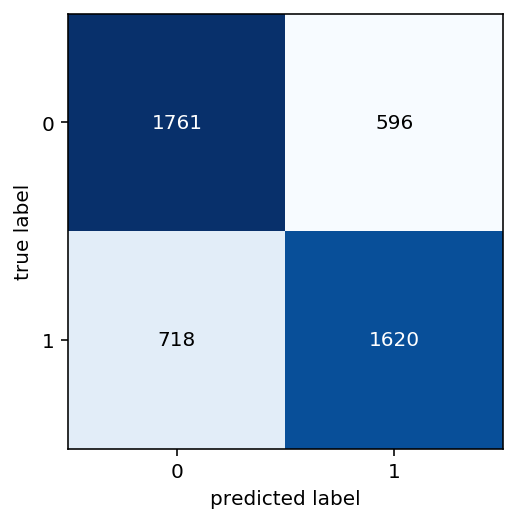

In [38]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,gb_pred),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,gb_pred)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,gb_pred)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

In [98]:
from sklearn.model_selection import GridSearchCV

In [77]:
param_grid = {'min_samples_leaf': [2, 5, 10, 15], 'max_features': [0.1,0.2,0.7,1,5,10], 'min_samples_split': [2, 5, 7, 10, 12, 15], 'n_estimators': [50, 100, 200, 300, 400, 500], 'criterion': ['entropy','gini']} 

In [78]:
grid = GridSearchCV(ExtraTreesClassifier(),param_grid,refit=True,verbose=0)
grid.fit(X_comparisons_train_categories_train.values,y_train_comparisons_train)

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


KeyboardInterrupt: 

In [50]:
#limpa o dtaframe packaging evitando dupicatas da embalagem escolhida
def def_packaging(packagings,columns,values,index):
    result = packagings.copy()
    result_chosen = result.loc[index:index].copy()
    result.drop(index, axis=0, inplace=True)
    valid_columns = list(set(packagings.columns) - (set(columns)))
    #remova as duplicatas 
    result.drop_duplicates(subset = valid_columns, keep = "first", inplace = True)
    
    for i in range(len(result)-1):
        aux = result.loc[i:i,valid_columns]
        if(len(aux)>0):  
            if(np.array_equal(result.loc[i:i,valid_columns].values[0],result_chosen[valid_columns].values[0])):
                result.drop(i, axis=0, inplace=True)
    #reinicie o index
    result.reset_index(drop=True,inplace=True)
    return result


In [113]:
packagings.columns
packaging_most = packagings.copy()

#inclui o termo "_themost"
packaging_most.columns = packaging_most.columns.str.cat(["_theMost" if x != 'id' and x != 'URL' else "" for x in packaging_most.columns], sep ="")

packaging_less = packagings.copy()

#inclui o termo "_theless"
packaging_less.columns = packaging_less.columns.str.cat(["_theLess" if x != 'id' and x != 'URL' else "" for x in packaging_less.columns], sep ="")

packaging_most = packaging_most.drop(['id','URL'],axis=1)
packaging_less = packaging_less.drop(['id','URL'],axis=1)



packaging_most_dummied = pd.get_dummies(packaging_most[['shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)

packaging_less_dummied = pd.get_dummies(packaging_less[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess']], drop_first=False)



In [114]:
[pd.concat([packaging_most_dummied.loc[0],packaging_less_dummied.loc[1]])]

[shape_theMost_Geométrica             0
 shape_theMost_Orgânica               1
 material_theMost_Metal               0
 material_theMost_Papel Cartão        0
 material_theMost_Polímero            0
 material_theMost_Vidro               1
 surface_theMost_Brilhosa             0
 surface_theMost_Fosca                1
 color_theMost_Intensa                0
 color_theMost_Neutra                 1
 constitution_theMost_Complexidade    0
 constitution_theMost_Ordem           1
 shape_theLess_Geométrica             0
 shape_theLess_Orgânica               1
 material_theLess_Metal               0
 material_theLess_Papel Cartão        0
 material_theLess_Polímero            0
 material_theLess_Vidro               1
 surface_theLess_Brilhosa             0
 surface_theLess_Fosca                1
 color_theLess_Intensa                0
 color_theLess_Neutra                 1
 constitution_theLess_Complexidade    1
 constitution_theLess_Ordem           0
 dtype: uint8]

In [115]:

packaging_2_dummied = pd.DataFrame(columns=np.concatenate((packaging_less_dummied.columns,packaging_most_dummied.columns))     )
for i in range(len(packaging_most_dummied)):
    for j in range(len(packaging_less_dummied)):
        if(not np.array_equal(packaging_most_dummied.loc[i:i].values[0],packaging_less_dummied.loc[j:j].values[0])):
            packaging_2_dummied = packaging_2_dummied.append([pd.concat([packaging_most_dummied.loc[i],packaging_less_dummied.loc[j]])])


In [116]:

packaging_2 = pd.DataFrame(columns=np.concatenate((packaging_less.columns,packaging_most.columns))     )
for i in range(len(packaging_most)):
    for j in range(len(packaging_less)):
        if(not np.array_equal(packaging_most.loc[i:i].values[0],packaging_less.loc[j:j].values[0])):
            packaging_2 = packaging_2.append([pd.concat([packaging_most.loc[i],packaging_less.loc[j]])])


In [117]:
packaging_2_aux = pd.DataFrame(columns=np.concatenate((packaging_less.columns,packaging_most.columns))     )
for i in range(len(packaging_most)):
    for j in range(len(packaging_less)):
        if(not np.array_equal(packaging_most.loc[i:i].values[0],packaging_less.loc[j:j].values[0])):
            packaging_2_aux = packaging_2_aux.append([pd.concat([packaging_most.loc[i],packaging_less.loc[j]])])

In [118]:
packaging_2_aux

,shape_theLess,material_theLess,surface_theLess,color_theLess,constitution_theLess,shape_theMost,material_theMost,surface_theMost,color_theMost,constitution_theMost
0,Orgânica,Vidro,Fosca,Neutra,Complexidade,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Fosca,Intensa,Ordem,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Fosca,Intensa,Complexidade,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Brilhosa,Neutra,Ordem,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Brilhosa,Neutra,Complexidade,Orgânica,Vidro,Fosca,Neutra,Ordem
...,...,...,...,...,...,...,...,...,...,...
0,Geométrica,Metal,Fosca,Intensa,Ordem,Geométrica,Metal,Brilhosa,Intensa,Complexidade
0,Geométrica,Metal,Fosca,Intensa,Complexidade,Geométrica,Metal,Brilhosa,Intensa,Complexidade
0,Geométrica,Metal,Brilhosa,Neutra,Ordem,Geométrica,Metal,Brilhosa,Intensa,Complexidade
0,Geométrica,Metal,Brilhosa,Neutra,Complexidade,Geométrica,Metal,Brilhosa,Intensa,Complexidade


In [57]:
from __future__ import print_function
import sklearn.datasets
import sklearn.ensemble
import lime
import lime.lime_tabular

In [119]:
features = 10
def categorical_features(data,m):
    categorical_names = {}
    categorical_features = range(m)#14
    for feature in categorical_features:
        le = sklearn.preprocessing.LabelEncoder()
        le.fit(data[:, feature])
        data[:, feature] = le.transform(data[:, feature])
        categorical_names[feature] = le.classes_
    return (categorical_names,data)

comparisons_train_categories_2_names, comparisons_train_categories_2 = categorical_features(X_train_comparisons_train.reset_index(drop=True,inplace=False).values,features)
comparisons_valid_categories_2_names, comparisons_valid_categories_2 = categorical_features(X_train_comparisons_valid.reset_index(drop=True,inplace=False).values,features)
comparisons_tests_categories_2_names, comparisons_tests_categories_2 = categorical_features(comparisons_tests_cleaned.reset_index(drop=True,inplace=False).drop(['result'], axis=1,inplace=False).values,features)

comparisons_train_categories_2_y = y_train_comparisons_train
comparisons_valid_categories_2_y = y_train_comparisons_valid
comparisons_tests_categories_2_y = np.where(comparisons_tests_cleaned['result']==True, 1,0)


In [120]:

comparisons_train_categories_male_age_1_2_names, comparisons_train_categories_male_age_1_2 = categorical_features(get_data_X_y(1,False)[0].reset_index(drop=True,inplace=False).values,features)
comparisons_train_categories_female_age_1_2_names, comparisons_train_categories_female_age_1_2 = categorical_features(get_data_X_y(3,False)[0].reset_index(drop=True,inplace=False).values,features)
comparisons_train_categories_male_age_2_2_names, comparisons_train_categories_male_age_2_2 = categorical_features(get_data_X_y(2,False)[0].reset_index(drop=True,inplace=False).values,features)
comparisons_train_categories_female_age_2_2_names, comparisons_train_categories_female_age_2_2 = categorical_features(get_data_X_y(4,False)[0].reset_index(drop=True,inplace=False).values,features)
comparisons_train_categories_age_1_2_names, comparisons_train_categories_age_1_2 = categorical_features(get_data_X_y(5,False)[0].reset_index(drop=True,inplace=False).values,features)
comparisons_train_categories_age_2_2_names, comparisons_train_categories_age_2_2 = categorical_features(get_data_X_y(6,False)[0].reset_index(drop=True,inplace=False).values,features)
comparisons_train_categories_male_2_names, comparisons_train_categories_male_2 = categorical_features(get_data_X_y(7,False)[0].reset_index(drop=True,inplace=False).values,features)
comparisons_train_categories_female_2_names, comparisons_train_categories_female_2 = categorical_features(get_data_X_y(8,False)[0].reset_index(drop=True,inplace=False).values,features)




def get_data_X_y_2(index):
    if(index == 1):
        return comparisons_train_categories_male_age_1_2_names, comparisons_train_categories_male_age_1_2
    elif(index == 2):
        return comparisons_train_categories_female_age_1_2_names, comparisons_train_categories_female_age_1_2
    elif(index == 3):
        return comparisons_train_categories_male_age_2_2_names, comparisons_train_categories_male_age_2_2
    elif(index == 4):
        return comparisons_train_categories_female_age_2_2_names, comparisons_train_categories_female_age_2_2
    elif(index == 5):
        return comparisons_train_categories_age_1_2_names, comparisons_train_categories_age_1_2
    elif(index == 6):
        return comparisons_train_categories_age_2_2_names, comparisons_train_categories_age_2_2
    elif(index == 7):
        return comparisons_train_categories_male_2_names, comparisons_train_categories_male_2
    elif(index == 8):
        return comparisons_train_categories_female_2_names, comparisons_train_categories_female_2
    else:
        return None

In [121]:
packaging_2_names, packaging_2 = categorical_features(packaging_2.values,features)

In [122]:
np.random.seed(1)

##### A partir daqui iniciaremos iniciaremos a implementação do processo de justificação e explicação dos resultado, para que assim os números obtidos após o terinamento do modelo façam algum sentido.

In [123]:
encoder = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)


In [63]:

encoder1 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)
encoder3 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)
encoder2 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)
encoder4 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)
encoder5 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)
encoder6 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)
encoder7 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)
encoder8 = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)

encoder1.fit(get_data_X_y_2(1)[1].astype(float))
encoder3.fit(get_data_X_y_2(3)[1].astype(float))
encoder2.fit(get_data_X_y_2(2)[1].astype(float))
encoder4.fit(get_data_X_y_2(4)[1].astype(float))
encoder5.fit(get_data_X_y_2(5)[1].astype(float))
encoder6.fit(get_data_X_y_2(6)[1].astype(float))
encoder7.fit(get_data_X_y_2(7)[1].astype(float))
encoder8.fit(get_data_X_y_2(8)[1].astype(float))


c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\preprocessing\_encoders.py:451: DeprecationWarning: The 'categorical_features' keyword is deprecated in version 0.20 and will be removed in 0.22. You can use the ColumnTransformer instead.
  "use the ColumnTransformer instead.", DeprecationWarning)
c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\preprocessing\_encod

OneHotEncoder(categorical_features=range(0, 10), categories=None, drop=None,
              dtype=<class 'numpy.float64'>, handle_unknown='error',
              n_values=None, sparse=False)

In [124]:
names, values = categorical_features(pd.concat([pd.DataFrame(comparisons_train_categories_2),pd.DataFrame(comparisons_valid_categories_2)],axis=0).values,features)
encoder.fit(values.astype(float))

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\preprocessing\_encoders.py:451: DeprecationWarning: The 'categorical_features' keyword is deprecated in version 0.20 and will be removed in 0.22. You can use the ColumnTransformer instead.
  "use the ColumnTransformer instead.", DeprecationWarning)


OneHotEncoder(categorical_features=range(0, 10), categories=None, drop=None,
              dtype=<class 'numpy.float64'>, handle_unknown='error',
              n_values=None, sparse=False)

In [65]:
values[0]

array([0, 0, 1, 1, 1, 1, 3, 0, 0, 1], dtype=object)

In [125]:
categorical_features(X_train_comparisons_train.reset_index(drop=True,inplace=False).values,features)

({0: array(['Geométrica', 'Orgânica'], dtype=object),
  1: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
  2: array(['Brilhosa', 'Fosca'], dtype=object),
  3: array(['Intensa', 'Neutra'], dtype=object),
  4: array(['Complexidade', 'Ordem'], dtype=object),
  5: array(['Geométrica', 'Orgânica'], dtype=object),
  6: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
  7: array(['Brilhosa', 'Fosca'], dtype=object),
  8: array(['Intensa', 'Neutra'], dtype=object),
  9: array(['Complexidade', 'Ordem'], dtype=object)},
 array([[0, 0, 1, ..., 0, 0, 1],
        [1, 1, 1, ..., 0, 1, 0],
        [1, 1, 1, ..., 1, 0, 1],
        ...,
        [0, 2, 0, ..., 1, 0, 1],
        [0, 3, 0, ..., 0, 1, 1],
        [1, 3, 0, ..., 1, 1, 1]], dtype=object))

In [126]:
#verfique se esta função retorna as probabilidades
predict_fn = lambda x: pipeline.predict_proba(encoder.transform(x))

In [68]:
#verfique se esta função retorna as probabilidades
predict_fn1 = lambda x: pipeline1.predict_proba(encoder1.transform(x))

In [69]:
#verfique se esta função retorna as probabilidades
predict_fn3 = lambda x: pipeline3.predict_proba(encoder3.transform(x))

In [70]:
#verfique se esta função retorna as probabilidades
predict_fn2 = lambda x: pipeline2.predict_proba(encoder2.transform(x))

In [71]:
#verfique se esta função retorna as probabilidades
predict_fn4 = lambda x: pipeline4.predict_proba(encoder4.transform(x))

In [72]:
#verfique se esta função retorna as probabilidades
predict_fn5 = lambda x: pipeline5.predict_proba(encoder5.transform(x))

In [73]:
#verfique se esta função retorna as probabilidades
predict_fn6 = lambda x: pipeline6.predict_proba(encoder6.transform(x))

In [74]:
#verfique se esta função retorna as probabilidades
predict_fn7 = lambda x: pipeline7.predict_proba(encoder7.transform(x))

In [75]:
#verfique se esta função retorna as probabilidades
predict_fn8 = lambda x: pipeline8.predict_proba(encoder8.transform(x))

In [76]:
columns=X_train_comparisons_train.columns
columns=np.where(columns=='shape_theLess', 'forma menos sust.', columns)
columns=np.where(columns=='material_theLess', 'material menos sust.', columns)
columns=np.where(columns=='surface_theLess', 'superfície menos sust.', columns)
columns=np.where(columns=='color_theLess', 'cor menos sust.', columns)
columns=np.where(columns=='constitution_theLess', 'constituição menos sust.', columns)
columns=np.where(columns=='shape_theMost', 'forma mais sust.', columns)
columns=np.where(columns=='material_theMost', 'material mais sust.', columns)
columns=np.where(columns=='surface_theMost', 'superfície mais sust.', columns)
columns=np.where(columns=='color_theMost', 'cor mais sust.', columns)
columns=np.where(columns=='constitution_theMost', 'constituição mais sust.', columns)
columns

array(['forma menos sust.', 'material menos sust.',
       'superfície menos sust.', 'cor menos sust.',
       'constituição menos sust.', 'forma mais sust.',
       'material mais sust.', 'superfície mais sust.', 'cor mais sust.',
       'constituição mais sust.'], dtype=object)

In [77]:
comparisons_train_categories_2_names

{0: array(['Geométrica', 'Orgânica'], dtype=object),
 1: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
 2: array(['Brilhosa', 'Fosca'], dtype=object),
 3: array(['Intensa', 'Neutra'], dtype=object),
 4: array(['Complexidade', 'Ordem'], dtype=object),
 5: array(['Geométrica', 'Orgânica'], dtype=object),
 6: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
 7: array(['Brilhosa', 'Fosca'], dtype=object),
 8: array(['Intensa', 'Neutra'], dtype=object),
 9: array(['Complexidade', 'Ordem'], dtype=object)}

In [78]:
columns

array(['forma menos sust.', 'material menos sust.',
       'superfície menos sust.', 'cor menos sust.',
       'constituição menos sust.', 'forma mais sust.',
       'material mais sust.', 'superfície mais sust.', 'cor mais sust.',
       'constituição mais sust.'], dtype=object)

### LIME

A partir daqui implementamos o mecanismo de justificação de resultados preditivos baseado em linearidade local Lime (1). Aqui identificamos qual atributo tem mais influência em cada resultado.

#### Referências
1. Ribeiro, Marco Tulio; Sinch, Sameer; Guestrin, Carlos. Why should i trust you?: Explaining the predictions of any classifier. In: Proceedings of the 22nd ACM SIGKDD international conference on knowledge discovery and data mining. ACM, 2016. p. 1135-1144.


In [127]:
explainer = lime.lime_tabular.LimeTabularExplainer(comparisons_train_categories_2,class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=comparisons_train_categories_2_names, kernel_width=3, verbose=False)

In [80]:
explainer1 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(1)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(1)[0], kernel_width=3, verbose=False)
explainer3 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(3)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(3)[0], kernel_width=3, verbose=False)
explainer2 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(2)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(2)[0], kernel_width=3, verbose=False)
explainer4 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(4)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(4)[0], kernel_width=3, verbose=False)
explainer5 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(5)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(5)[0], kernel_width=3, verbose=False)
explainer6 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(6)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(6)[0], kernel_width=3, verbose=False)
explainer7 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(7)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(7)[0], kernel_width=3, verbose=False)
explainer8 = lime.lime_tabular.LimeTabularExplainer(get_data_X_y_2(8)[1],class_names=['falso','verdadeiro'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=get_data_X_y_2(8)[0], kernel_width=3, verbose=False)


In [128]:
X_train_comparisons_train.columns

Index(['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess',
       'constitution_theLess', 'shape_theMost', 'material_theMost',
       'surface_theMost', 'color_theMost', 'constitution_theMost'],
      dtype='object')

In [133]:
#i = 11
exp = explainer.explain_instance(packaging_2[111], predict_fn, num_features=10)
exp.show_in_notebook()

In [132]:
pipeline.predict_proba(packaging_2_dummied[111:112].values)

array([[0.38833333, 0.61166667]])

In [84]:
packaging_2[110]

array([0, 1, 1, 1, 1, 1, 3, 1, 1, 0], dtype=object)

In [85]:
packaging_2_dummied[110:111]

,shape_theLess_Geométrica,shape_theLess_Orgânica,material_theLess_Metal,material_theLess_Papel Cartão,material_theLess_Polímero,material_theLess_Vidro,surface_theLess_Brilhosa,surface_theLess_Fosca,color_theLess_Intensa,color_theLess_Neutra,...,material_theMost_Metal,material_theMost_Papel Cartão,material_theMost_Polímero,material_theMost_Vidro,surface_theMost_Brilhosa,surface_theMost_Fosca,color_theMost_Intensa,color_theMost_Neutra,constitution_theMost_Complexidade,constitution_theMost_Ordem
0,1,0,0,1,0,0,0,1,0,1,...,0,0,0,1,0,1,0,1,1,0


## Análise exploratória dos dados

Partiremos agora para uma análise mais detalhadas das correlações entre os dados.

Aqui a priori realizaremos uma "contagem de votos", onde somaremos os votos (sendo este pró sustentabilidade ou contra sustentabilidade) de cada respondente para cada uma das embalagens, afim de obtermos um estudo comparativo entre nossa estratégia de predição baseada em aprendizagem e modelos lineares que se prestem à mesma função.

Munidos dos dois estudos paralelos, um envolvendo uma contagem de votos simples e outro envolvendo nosso modelo preditivo associado a ferramenta LIME de justificações de atributos, criamos gráficos de barras simples comparando os resultados baseados em cada uma das entratégias.

Além da comparação entre predição e contagem simples, medimos a correlação entre cada um dos atributos com cada um dos demais. Isto é feito utilizando uma matriz cromática indo de verde (pró sustentabilidade) à vermelho (contra sustentabilidade). 




### Estratégia de contagem simples


Aqui, a fim de criar um paralelo entre mo resultado do modelo preditivo e o que os consumidores responderam numericamente, realizou-se uma contagem das ocorrencias de sucesso de cada característica e cada informação de precedência (x é mais sustentável que y). Tal contagem gerou uma pontuação por característica que foi dividida pelo total de ocorrências desta característica.

In [134]:
#cria a lista de features para contagem simples
packaging_features = pd.DataFrame(columns=['nome','valor','score','occurrences','final.score'])
cols = packagings.columns.drop(['id','URL'])
for i in range(len(cols)):
    aux = packagings.loc[:][cols[i]].unique()
    for j in range(len(aux)):
        packaging_features = packaging_features.append(pd.DataFrame({'nome':[cols[i]],'valor':[aux[j]], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0}))
#cria a lista de features para contagem a partir dos dados do Lime        
packaging_features_lime = packaging_features.copy()

In [135]:
'''Incrementa a pontuação de cada feature como uma contagem de sucessos simples'''
for i,v in comparisons_train_cleaned.iterrows():
    count = -1
    if(v['result']):
        count = -count
    for x in comparisons_train_cleaned.columns:
        
        if(x.find('_theLess')>=0):
            if(packaging_features.loc[packaging_features['valor']==v[x],'valor'][0]==v[x]):
                packaging_features.loc[packaging_features['valor']==v[x],'score'] = packaging_features.loc[packaging_features['valor']==v[x]]['score'] - count
                packaging_features.loc[packaging_features['valor']==v[x],'occurrences'] = packaging_features.loc[packaging_features['valor']==v[x]]['occurrences'] + 1
        elif(x.find('_theMost')>=0):
            if(packaging_features.loc[packaging_features['valor']==v[x],'valor'][0]==v[x]):
                packaging_features.loc[packaging_features['valor']==v[x],'score'] = packaging_features.loc[packaging_features['valor']==v[x]]['score'] + count
                packaging_features.loc[packaging_features['valor']==v[x],'occurrences'] = packaging_features.loc[packaging_features['valor']==v[x]]['occurrences'] + 1

In [136]:
'''Dividindo a pontuação final pelo total de ocorrências'''
packaging_features.loc[:,'final.score'] = packaging_features['score']/packaging_features['occurrences']

In [137]:
failt_sum = sum([x['final.score'] for i,x in packaging_features.iterrows() if x['final.score'] <= 0])
sucess_sum = sum([x['final.score'] for i,x in packaging_features.iterrows() if x['final.score'] >= 0])

In [138]:

packaging_features.loc[:,'final.score.2'] = [x['final.score']/failt_sum if x['final.score'] < 0 else x['final.score']/sucess_sum for i,x in packaging_features.iterrows()]

packaging_features =packaging_features.join(pd.DataFrame(packaging_features.loc[packaging_features['final.score']>0].set_index('nome').loc[:,'final.score.2'].groupby('nome').sum()), on='nome', rsuffix='.sucess')

packaging_features =packaging_features.join(pd.DataFrame(packaging_features.loc[packaging_features['final.score']<=0].set_index('nome').loc[:,'final.score.2'].groupby('nome').sum()), on='nome', rsuffix='.fail')

packaging_features.loc[:,'final.score.2.fail'] = packaging_features['final.score.2.fail']*100
packaging_features.loc[:,'final.score.2.sucess'] = packaging_features['final.score.2.sucess']*100


#pd.DataFrame(packaging_features.loc[packaging_features['final.score']>0].set_index('nome').loc[:,'final.score.2'].groupby('nome').sum())

#packaging_features['final.score']*100
packaging_features

,nome,valor,score,occurrences,final.score,final.score.2,final.score.2.sucess,final.score.2.fail
0,shape,Orgânica,-572.0,16312,-0.0350662,0.053141,5.588220,5.314082
0,shape,Geométrica,572.0,14984,0.0381741,0.055882,5.588220,5.314082
0,material,Vidro,296.0,8354,0.0354321,0.051868,81.024939,81.188700
0,material,Polímero,-1704.0,7410,-0.22996,0.348490,81.024939,81.188700
0,material,Papel Cartão,3872.0,7474,0.518063,0.758381,81.024939,81.188700
0,material,Metal,-2464.0,8058,-0.305783,0.463397,81.024939,81.188700
0,surface,Fosca,448.0,15268,0.0293424,0.042954,4.295375,4.235826
0,surface,Brilhosa,-448.0,16028,-0.0279511,0.042358,4.295375,4.235826
0,color,Neutra,860.0,15516,0.0554267,0.081138,8.113792,8.259065
0,color,Intensa,-860.0,15780,-0.0544994,0.082591,8.113792,8.259065


In [139]:
packaging_features.loc[:,'final.score.3'] = [x['final.score.2']*(-100) if x['final.score'] < 0 else x['final.score.2']*100 for i,x in packaging_features.iterrows()]
packaging_features

,nome,valor,score,occurrences,final.score,final.score.2,final.score.2.sucess,final.score.2.fail,final.score.3
0,shape,Orgânica,-572.0,16312,-0.0350662,0.053141,5.588220,5.314082,-5.314082
0,shape,Geométrica,572.0,14984,0.0381741,0.055882,5.588220,5.314082,5.588220
0,material,Vidro,296.0,8354,0.0354321,0.051868,81.024939,81.188700,5.186835
0,material,Polímero,-1704.0,7410,-0.22996,0.348490,81.024939,81.188700,-34.849038
0,material,Papel Cartão,3872.0,7474,0.518063,0.758381,81.024939,81.188700,75.838104
0,material,Metal,-2464.0,8058,-0.305783,0.463397,81.024939,81.188700,-46.339662
0,surface,Fosca,448.0,15268,0.0293424,0.042954,4.295375,4.235826,4.295375
0,surface,Brilhosa,-448.0,16028,-0.0279511,0.042358,4.295375,4.235826,-4.235826
0,color,Neutra,860.0,15516,0.0554267,0.081138,8.113792,8.259065,8.113792
0,color,Intensa,-860.0,15780,-0.0544994,0.082591,8.113792,8.259065,-8.259065


In [140]:
failt_sum = sum([x['final.score'] for i,x in packaging_features.iterrows() if x['final.score'] <= 0])
sucess_sum = sum([x['final.score'] for i,x in packaging_features.iterrows() if x['final.score'] >= 0])

In [141]:
print(failt_sum,sucess_sum)

-0.6598733408114628 0.6831165235753994



### Estratégia de contagem para o LIME (lembre que já foi dito antes)(fale do código)

A ferramenta LIME avalie apenas a correlação entre as caracerísticas, não oferecendo recomendações (que é o que precisamos). Para contornar tal problema aplicamos a ferramenta a todas as comparações entre configurações de embalagem, ordenando em função da estimativa de sucesso.

In [94]:
packaging_2_aux

,shape_theLess,material_theLess,surface_theLess,color_theLess,constitution_theLess,shape_theMost,material_theMost,surface_theMost,color_theMost,constitution_theMost
0,Orgânica,Vidro,Fosca,Neutra,Complexidade,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Fosca,Intensa,Ordem,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Fosca,Intensa,Complexidade,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Brilhosa,Neutra,Ordem,Orgânica,Vidro,Fosca,Neutra,Ordem
0,Orgânica,Vidro,Brilhosa,Neutra,Complexidade,Orgânica,Vidro,Fosca,Neutra,Ordem
...,...,...,...,...,...,...,...,...,...,...
0,Geométrica,Metal,Fosca,Intensa,Ordem,Geométrica,Metal,Brilhosa,Intensa,Complexidade
0,Geométrica,Metal,Fosca,Intensa,Complexidade,Geométrica,Metal,Brilhosa,Intensa,Complexidade
0,Geométrica,Metal,Brilhosa,Neutra,Ordem,Geométrica,Metal,Brilhosa,Intensa,Complexidade
0,Geométrica,Metal,Brilhosa,Neutra,Complexidade,Geométrica,Metal,Brilhosa,Intensa,Complexidade


In [142]:
packaging_2_aux.reset_index(drop=True,inplace=True)
packagings
#packagings_weighted = pd.DataFrame([],columns=['URL','score','shape','shape_weight','material','material_weight','surface','surface_weight','color','color_weight','constitution','constitution_weight'])
packagings_weighted = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})

packagings_weighted1 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})
packagings_weighted3 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})
packagings_weighted2 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})
packagings_weighted4 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})
packagings_weighted5 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})
packagings_weighted6 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})
packagings_weighted7 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})
packagings_weighted8 = pd.DataFrame({'URL':packagings['URL'],'score':0.0,'shape':packagings['shape'],'shape_weight':0.0,'material':packagings['material'],'material_weight':0.0,'surface':packagings['surface'],'surface_weight':0.0,'color':packagings['color'],'color_weight':0.0,'constitution':packagings['constitution'],'constitution_weight':0.0})


lime_values = pd.DataFrame()

lime_values1 = pd.DataFrame()
lime_values3 = pd.DataFrame()
lime_values2 = pd.DataFrame()
lime_values4 = pd.DataFrame()
lime_values5 = pd.DataFrame()
lime_values6 = pd.DataFrame()
lime_values7 = pd.DataFrame()
lime_values8 = pd.DataFrame()

#'cor mais sust.=Neutra'
#'superfície mais sust.=Fosca'

def get_variances(list_,attribute):
    for v in list_:
        if(v[0].find(f'{attribute} mais sust.=') >= 0):
            return v[1]
    return 0


def get_packagins_weighted_aux(packagings_,v):
#     aux = packagings_weighted.loc[(packagings_weighted['shape'] == v['shape_theMost']) & (packagings_weighted['material'] == v['material_theMost']) & (packagings_weighted['surface'] == v['surface_theMost']) & (packagings_weighted['color'] == v['color_theMost']) & (packagings_weighted['constitution'] == v['constitution_theMost'])]
#     aux_less = packagings_weighted.loc[(packagings_weighted['shape'] == v['shape_theLess']) & (packagings_weighted['material'] == v['material_theLess']) & (packagings_weighted['surface'] == v['surface_theLess']) & (packagings_weighted['color'] == v['color_theLess']) & (packagings_weighted['constitution'] == v['constitution_theLess'])]
    aux = packagings_.loc[(packagings_['shape'] == v['shape_theMost']) & (packagings_['material'] == v['material_theMost']) & (packagings_['surface'] == v['surface_theMost']) & (packagings_['color'] == v['color_theMost']) & (packagings_['constitution'] == v['constitution_theMost'])]
    aux_less = packagings_.loc[(packagings_['shape'] == v['shape_theLess']) & (packagings_['material'] == v['material_theLess']) & (packagings_['surface'] == v['surface_theLess']) & (packagings_['color'] == v['color_theLess']) & (packagings_['constitution'] == v['constitution_theLess'])]

    return aux, aux_less

def set_packagins_weighted_aux(aux, list_):
    aux['shape_weight'] = aux['shape_weight'] + get_variances(list_,'forma')
    aux['material_weight'] = aux['material_weight'] + get_variances(list_,'material')
    aux['surface_weight'] = aux['surface_weight'] + get_variances(list_,'superfície')
    aux['color_weight'] = aux['color_weight'] + get_variances(list_,'cor')
    aux['constitution_weight'] = aux['constitution_weight'] + get_variances(list_,'constituição')
    
    return aux


In [143]:

for i,v in packaging_2_aux.iterrows():
    falso_per,  verdadeiro_per  = pipeline. predict_proba(packaging_2_dummied[i:i+1].values)[0]
    
    falso_per1, verdadeiro_per1 = pipeline1.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per3, verdadeiro_per3 = pipeline3.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per2, verdadeiro_per2 = pipeline2.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per4, verdadeiro_per4 = pipeline4.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per5, verdadeiro_per5 = pipeline5.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per6, verdadeiro_per6 = pipeline6.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per7, verdadeiro_per7 = pipeline7.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per8, verdadeiro_per8 = pipeline8.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    
    exp  = explainer. explain_instance(packaging_2[i], predict_fn,  num_features=10)
    
    exp1 = explainer1.explain_instance(packaging_2[i], predict_fn1, num_features=10)
    exp3 = explainer3.explain_instance(packaging_2[i], predict_fn3, num_features=10)
    exp2 = explainer2.explain_instance(packaging_2[i], predict_fn2, num_features=10)
    exp4 = explainer4.explain_instance(packaging_2[i], predict_fn4, num_features=10)
    exp5 = explainer5.explain_instance(packaging_2[i], predict_fn5, num_features=10)
    exp6 = explainer6.explain_instance(packaging_2[i], predict_fn6, num_features=10)
    exp7 = explainer7.explain_instance(packaging_2[i], predict_fn7, num_features=10)
    exp8 = explainer8.explain_instance(packaging_2[i], predict_fn8, num_features=10)
    
    list_  = exp. as_list()
    
    list_1 = exp1.as_list()
    list_3 = exp3.as_list()
    list_2 = exp2.as_list()
    list_4 = exp4.as_list()
    list_5 = exp5.as_list()
    list_6 = exp6.as_list()
    list_7 = exp7.as_list()
    list_8 = exp8.as_list()
    
    
    aux,  aux_less  = get_packagins_weighted_aux(packagings_weighted, v)
    
    aux1, aux_less1 = get_packagins_weighted_aux(packagings_weighted1,v)
    aux3, aux_less3 = get_packagins_weighted_aux(packagings_weighted3,v)
    aux2, aux_less2 = get_packagins_weighted_aux(packagings_weighted2,v)
    aux4, aux_less4 = get_packagins_weighted_aux(packagings_weighted4,v)
    aux5, aux_less5 = get_packagins_weighted_aux(packagings_weighted5,v)
    aux6, aux_less6 = get_packagins_weighted_aux(packagings_weighted6,v)
    aux7, aux_less7 = get_packagins_weighted_aux(packagings_weighted7,v)
    aux8, aux_less8 = get_packagins_weighted_aux(packagings_weighted8,v)
    
    
    aux['score']  = aux['score'] +  (verdadeiro_per )/63
    
    aux1['score'] = aux1['score'] + (verdadeiro_per1)/63#total de comparações em que cada embalagem participa
    aux3['score'] = aux3['score'] + (verdadeiro_per3)/63
    aux2['score'] = aux2['score'] + (verdadeiro_per2)/63
    aux4['score'] = aux4['score'] + (verdadeiro_per4)/63
    aux5['score'] = aux5['score'] + (verdadeiro_per5)/63
    aux6['score'] = aux6['score'] + (verdadeiro_per6)/63
    aux7['score'] = aux7['score'] + (verdadeiro_per7)/63
    aux8['score'] = aux8['score'] + (verdadeiro_per8)/63
    
    aux = set_packagins_weighted_aux(aux, list_)
    
    aux1 = set_packagins_weighted_aux(aux1, list_1)
    aux3 = set_packagins_weighted_aux(aux3, list_3)
    aux2 = set_packagins_weighted_aux(aux2, list_2)
    aux4 = set_packagins_weighted_aux(aux4, list_4)
    aux5 = set_packagins_weighted_aux(aux5, list_5)
    aux6 = set_packagins_weighted_aux(aux6, list_6)
    aux7 = set_packagins_weighted_aux(aux7, list_7)
    aux8 = set_packagins_weighted_aux(aux8, list_8)
    
    
    packagings_weighted.loc[(packagings_weighted['shape'] == v['shape_theMost']) & (packagings_weighted['material'] == v['material_theMost']) & (packagings_weighted['surface'] == v['surface_theMost']) & (packagings_weighted['color'] == v['color_theMost']) & (packagings_weighted['constitution'] == v['constitution_theMost'])] = aux
    
    packagings_weighted1.loc[(packagings_weighted1['shape'] == v['shape_theMost']) & (packagings_weighted1['material'] == v['material_theMost']) & (packagings_weighted1['surface'] == v['surface_theMost']) & (packagings_weighted1['color'] == v['color_theMost']) & (packagings_weighted1['constitution'] == v['constitution_theMost'])] = aux1
    packagings_weighted3.loc[(packagings_weighted3['shape'] == v['shape_theMost']) & (packagings_weighted3['material'] == v['material_theMost']) & (packagings_weighted3['surface'] == v['surface_theMost']) & (packagings_weighted3['color'] == v['color_theMost']) & (packagings_weighted3['constitution'] == v['constitution_theMost'])] = aux3
    packagings_weighted2.loc[(packagings_weighted2['shape'] == v['shape_theMost']) & (packagings_weighted2['material'] == v['material_theMost']) & (packagings_weighted2['surface'] == v['surface_theMost']) & (packagings_weighted2['color'] == v['color_theMost']) & (packagings_weighted2['constitution'] == v['constitution_theMost'])] = aux2
    packagings_weighted4.loc[(packagings_weighted4['shape'] == v['shape_theMost']) & (packagings_weighted4['material'] == v['material_theMost']) & (packagings_weighted4['surface'] == v['surface_theMost']) & (packagings_weighted4['color'] == v['color_theMost']) & (packagings_weighted4['constitution'] == v['constitution_theMost'])] = aux4
    packagings_weighted5.loc[(packagings_weighted5['shape'] == v['shape_theMost']) & (packagings_weighted5['material'] == v['material_theMost']) & (packagings_weighted5['surface'] == v['surface_theMost']) & (packagings_weighted5['color'] == v['color_theMost']) & (packagings_weighted5['constitution'] == v['constitution_theMost'])] = aux5
    packagings_weighted6.loc[(packagings_weighted6['shape'] == v['shape_theMost']) & (packagings_weighted6['material'] == v['material_theMost']) & (packagings_weighted6['surface'] == v['surface_theMost']) & (packagings_weighted6['color'] == v['color_theMost']) & (packagings_weighted6['constitution'] == v['constitution_theMost'])] = aux6
    packagings_weighted7.loc[(packagings_weighted7['shape'] == v['shape_theMost']) & (packagings_weighted7['material'] == v['material_theMost']) & (packagings_weighted7['surface'] == v['surface_theMost']) & (packagings_weighted7['color'] == v['color_theMost']) & (packagings_weighted7['constitution'] == v['constitution_theMost'])] = aux7
    packagings_weighted8.loc[(packagings_weighted8['shape'] == v['shape_theMost']) & (packagings_weighted8['material'] == v['material_theMost']) & (packagings_weighted8['surface'] == v['surface_theMost']) & (packagings_weighted8['color'] == v['color_theMost']) & (packagings_weighted8['constitution'] == v['constitution_theMost'])] = aux8
    
    #packagings_weighted.loc[(packagings_weighted['shape'] == v['shape_theLess']) & (packagings_weighted['material'] == v['material_theLess']) & (packagings_weighted['surface'] == v['surface_theLess']) & (packagings_weighted['color'] == v['color_theLess']) & (packagings_weighted['constitution'] == v['constitution_theLess'])] = aux_less
    
    
    lime_values =lime_values .append({"URL_most":aux ['URL'],"URL_less":aux_less ['URL'],"verdadeiro":verdadeiro_per ,"falso":falso_per },ignore_index=True)

    lime_values1=lime_values1.append({"URL_most":aux1['URL'],"URL_less":aux_less1['URL'],"verdadeiro":verdadeiro_per1,"falso":falso_per1},ignore_index=True)
    lime_values3=lime_values3.append({"URL_most":aux3['URL'],"URL_less":aux_less3['URL'],"verdadeiro":verdadeiro_per3,"falso":falso_per3},ignore_index=True)
    lime_values2=lime_values2.append({"URL_most":aux2['URL'],"URL_less":aux_less2['URL'],"verdadeiro":verdadeiro_per2,"falso":falso_per2},ignore_index=True)
    lime_values4=lime_values4.append({"URL_most":aux4['URL'],"URL_less":aux_less4['URL'],"verdadeiro":verdadeiro_per4,"falso":falso_per4},ignore_index=True)
    lime_values5=lime_values5.append({"URL_most":aux5['URL'],"URL_less":aux_less5['URL'],"verdadeiro":verdadeiro_per5,"falso":falso_per5},ignore_index=True)
    lime_values6=lime_values6.append({"URL_most":aux6['URL'],"URL_less":aux_less6['URL'],"verdadeiro":verdadeiro_per6,"falso":falso_per6},ignore_index=True)
    lime_values7=lime_values7.append({"URL_most":aux7['URL'],"URL_less":aux_less7['URL'],"verdadeiro":verdadeiro_per7,"falso":falso_per7},ignore_index=True)
    lime_values8=lime_values8.append({"URL_most":aux8['URL'],"URL_less":aux_less8['URL'],"verdadeiro":verdadeiro_per8,"falso":falso_per8},ignore_index=True)


In [ ]:
for i,v in packagings_weighted.iterrows():
    sum_ = v['material_weight'] + v['shape_weight'] + v['color_weight'] + v['surface_weight'] + v['constitution_weight']
    packagings_weighted.loc[packagings_weighted['URL'] == v['URL']]['material_weight'] = v['material_weight']/sum_ 

In [145]:
pd.DataFrame(data=packagings_weighted). to_json(r'packagings_all.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted1).to_json(r'packagings_male_age_1.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted3).to_json(r'packagings_male_age_2.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted2).to_json(r'packagings_female_age_1.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted4).to_json(r'packagings_female_age_2.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted5).to_json(r'packagings_age_1.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted6).to_json(r'packagings_age_2.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted7).to_json(r'packagings_male.json')#, compression='zip')
pd.DataFrame(data=packagings_weighted8).to_json(r'packagings_female.json')#, compression='zip')

pd.DataFrame(data=lime_values). to_json(r'model_all.json')#, compression='zip')
pd.DataFrame(data=lime_values1).to_json(r'model_male_age_1.json')#, compression='zip')
pd.DataFrame(data=lime_values3).to_json(r'model_male_age_2.json')#, compression='zip')
pd.DataFrame(data=lime_values2).to_json(r'model_female_age_1.json')#, compression='zip')
pd.DataFrame(data=lime_values4).to_json(r'model_female_age_2.json')#, compression='zip')
pd.DataFrame(data=lime_values5).to_json(r'model_age_1.json')#, compression='zip')
pd.DataFrame(data=lime_values6).to_json(r'model_age_2.json')#, compression='zip')
pd.DataFrame(data=lime_values7).to_json(r'model_male.json')#, compression='zip')
pd.DataFrame(data=lime_values8).to_json(r'model_female.json')#, compression='zip')

In [ ]:
#gerar resultados para as 64X63 comparações

lime_values = []
for i in range(len(packaging_2_aux)):
    exp = explainer.explain_instance(packaging_2[i], predict_fn, num_features=10)

    falso_per, verdadeiro_per = pipeline.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    
    lime_values.append({"verdadeiro":verdadeiro_per,"falso":-1*falso_per,"lista":exp.as_list()})
lime_values

In [ ]:
#Inclui os atributos de cada embalagem no datagram 'scores', gerando o 'scores_ready'
scores_ready = set_attributes(scores,"URL")
scores_ready=scores_ready.fillna(0)

In [534]:
#gerar resultados para as 64X63 comparações

lime_values = []
for i in range(len(packaging_2)):
    exp = explainer.explain_instance(packaging_2[i], predict_fn, num_features=10)

    falso_per, verdadeiro_per = pipeline.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    
    lime_values.append({"verdadeiro":verdadeiro_per,"falso":-1*falso_per,"lista":exp.as_list()})
lime_values

[{'verdadeiro': 0.5077376946448194,
  'falso': -0.49226230535518056,
  'lista': [('cor mais sust.=Neutra', 0.005231548936898545),
   ('superfície mais sust.=Fosca', 0.003945588176098611),
   ('material mais sust.=Vidro', 0.0038996612121942257),
   ('cor menos sust.=Neutra', -0.0016387637918225267),
   ('material menos sust.=Vidro', 0.001318895418023799),
   ('forma mais sust.=Orgânica', -0.0010861288612196737),
   ('superfície menos sust.=Fosca', -0.0008973098933115434),
   ('forma menos sust.=Orgânica', 0.00015080650020365458),
   ('constituição mais sust.=Ordem', 2.7060752007181168e-05),
   ('constituição menos sust.=Complexidade', -1.836189355448759e-06)]},
 {'verdadeiro': 0.5079708475675054,
  'falso': -0.49202915243249457,
  'lista': [('cor mais sust.=Neutra', 0.005519872681144743),
   ('superfície mais sust.=Fosca', 0.003405213677891697),
   ('material mais sust.=Vidro', 0.0031534041425881434),
   ('superfície menos sust.=Fosca', -0.001697240540362618),
   ('cor menos sust.=Inten

In [535]:
lime_values1 = []
lime_values3 = []
lime_values2 = []
lime_values4 = []
lime_values5 = []
lime_values6 = []
lime_values7 = []
lime_values8 = []
for i in range(len(packaging_2)):
    exp1 = explainer1.explain_instance(packaging_2[i], predict_fn1, num_features=10)
    exp3 = explainer3.explain_instance(packaging_2[i], predict_fn3, num_features=10)
    exp2 = explainer2.explain_instance(packaging_2[i], predict_fn2, num_features=10)
    exp4 = explainer4.explain_instance(packaging_2[i], predict_fn4, num_features=10)
    exp5 = explainer5.explain_instance(packaging_2[i], predict_fn5, num_features=10)
    exp6 = explainer6.explain_instance(packaging_2[i], predict_fn6, num_features=10)
    exp7 = explainer7.explain_instance(packaging_2[i], predict_fn7, num_features=10)
    exp8 = explainer8.explain_instance(packaging_2[i], predict_fn8, num_features=10)

    falso_per1, verdadeiro_per1 = pipeline1.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per3, verdadeiro_per3 = pipeline3.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per2, verdadeiro_per2 = pipeline2.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per4, verdadeiro_per4 = pipeline4.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per5, verdadeiro_per5 = pipeline5.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per6, verdadeiro_per6 = pipeline6.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per7, verdadeiro_per7 = pipeline7.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    falso_per8, verdadeiro_per8 = pipeline8.predict_proba(packaging_2_dummied[i:i+1].values)[0]
    
    lime_values1.append({"verdadeiro":verdadeiro_per1,"falso":-1*falso_per1,"lista":exp1.as_list()})
    lime_values3.append({"verdadeiro":verdadeiro_per3,"falso":-1*falso_per3,"lista":exp3.as_list()})
    lime_values2.append({"verdadeiro":verdadeiro_per2,"falso":-1*falso_per2,"lista":exp2.as_list()})
    lime_values4.append({"verdadeiro":verdadeiro_per4,"falso":-1*falso_per4,"lista":exp4.as_list()})
    lime_values5.append({"verdadeiro":verdadeiro_per5,"falso":-1*falso_per5,"lista":exp5.as_list()})
    lime_values6.append({"verdadeiro":verdadeiro_per6,"falso":-1*falso_per6,"lista":exp6.as_list()})
    lime_values7.append({"verdadeiro":verdadeiro_per7,"falso":-1*falso_per7,"lista":exp7.as_list()})
    lime_values8.append({"verdadeiro":verdadeiro_per8,"falso":-1*falso_per8,"lista":exp8.as_list()})

In [538]:
pd.DataFrame(data=lime_values).to_json(r'all.json')

In [537]:
pd.DataFrame(data=lime_values1).to_json(r'male_age_1.json')
pd.DataFrame(data=lime_values3).to_json(r'male_age_2.json')
pd.DataFrame(data=lime_values2).to_json(r'female_age_1.json')
pd.DataFrame(data=lime_values4).to_json(r'female_age_2.json')
pd.DataFrame(data=lime_values5).to_json(r'age_1.json')
pd.DataFrame(data=lime_values6).to_json(r'age_2.json')
pd.DataFrame(data=lime_values7).to_json(r'male.json')
pd.DataFrame(data=lime_values8).to_json(r'female.json')


In [343]:
'''Criando o dataframe com os resultados'''
lime_values_df = pd.DataFrame(lime_values)
lime_values_df

,verdadeiro,falso,lista
0,0.561962,-0.438038,"[(cor mais sust.=Neutra, 0.08142144107082452),..."
1,0.568245,-0.431755,"[(cor mais sust.=Neutra, 0.06067334862590254),..."
2,0.594196,-0.405804,"[(cor mais sust.=Neutra, 0.06060922499479075),..."
3,0.482330,-0.517670,"[(cor mais sust.=Neutra, 0.06541136288751813),..."
4,0.554467,-0.445533,"[(cor mais sust.=Neutra, 0.05726075480405353),..."
...,...,...,...
4027,0.179650,-0.820350,"[(material mais sust.=Metal, -0.30985078635882..."
4028,0.155113,-0.844887,"[(material mais sust.=Metal, -0.31608163411327..."
4029,0.200791,-0.799209,"[(material mais sust.=Metal, -0.30526972717903..."
4030,0.273808,-0.726192,"[(material mais sust.=Metal, -0.31077235142348..."


In [344]:
'''Incrementa a pontuação de cada feature com base nos resultados do LIME'''
#packaging_features_lime = packaging_features.copy()
for i,v in lime_values_df.iterrows():
    features_ = v['lista']
    for name,value in features_:
        if(name.find('mais sust')>=0):
            name_ = name.split(' mais sust.=')[1]
            if(packaging_features_lime.loc[packaging_features_lime['valor']==name_,'valor'][0]==name_):
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'score'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['score'] + value
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'occurrences'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['occurrences'] + 1
        elif(name.find('menos sust')>=0):
            name_ = name.split(' menos sust.=')[1]
            if(packaging_features_lime.loc[packaging_features_lime['valor']==name_,'valor'][0]==name_):
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'score'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['score'] - value
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'occurrences'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['occurrences'] + 1

In [345]:
'''Dividindo a pontuação final pelo total de ocorrências'''
packaging_features_lime.loc[:,'final.score'] = packaging_features_lime['score']/packaging_features_lime['occurrences']


In [346]:
failt_sum = sum([x['final.score'] for i,x in packaging_features_lime.iterrows() if x['final.score'] <= 0])
sucess_sum = sum([x['final.score'] for i,x in packaging_features_lime.iterrows() if x['final.score'] >= 0])

In [347]:


packaging_features_lime.loc[:,'final.score.2'] = [x['final.score']/failt_sum if x['final.score'] < 0 else x['final.score']/sucess_sum for i,x in packaging_features_lime.iterrows()]

packaging_features_lime = packaging_features_lime.join(pd.DataFrame(packaging_features_lime.loc[packaging_features_lime['final.score']>0].set_index('nome').loc[:,'final.score.2'].groupby('nome').sum()), on='nome', rsuffix='.sucess')

packaging_features_lime = packaging_features_lime.join(pd.DataFrame(packaging_features_lime.loc[packaging_features_lime['final.score']<=0].set_index('nome').loc[:,'final.score.2'].groupby('nome').sum()), on='nome', rsuffix='.fail')

packaging_features_lime.loc[:,'final.score.2.fail'] = packaging_features_lime['final.score.2.fail']*100
packaging_features_lime.loc[:,'final.score.2.sucess'] = packaging_features_lime['final.score.2.sucess']*100




packaging_features_lime

,nome,valor,score,occurrences,final.score,final.score.2,final.score.2.sucess,final.score.2.fail
0,shape,Orgânica,-20.201999,4032,-0.00501042,0.013156,1.354616,1.315579
0,shape,Geométrica,19.962972,4032,0.00495113,0.013546,1.354616,1.315579
0,material,Vidro,30.004050,2016,0.014883,0.040719,78.838983,79.728464
0,material,Polímero,-228.148858,2016,-0.113169,0.297147,78.838983,79.728464
0,material,Papel Cartão,550.920890,2016,0.273274,0.747670,78.838983,79.728464
0,material,Metal,-384.005411,2016,-0.190479,0.500138,78.838983,79.728464
0,surface,Fosca,117.961803,4032,0.0292564,0.080045,8.004467,7.695228
0,surface,Brilhosa,-118.167758,4032,-0.0293075,0.076952,8.004467,7.695228
0,color,Neutra,164.597937,4032,0.0408229,0.111690,11.169028,10.670701
0,color,Intensa,-163.859053,4032,-0.0406396,0.106707,11.169028,10.670701


In [348]:
packaging_features_lime.loc[:,'final.score.3'] = [x['final.score.2']*(-100) if x['final.score'] < 0 else x['final.score.2']*100 for i,x in packaging_features_lime.iterrows()]
packaging_features_lime

,nome,valor,score,occurrences,final.score,final.score.2,final.score.2.sucess,final.score.2.fail,final.score.3
0,shape,Orgânica,-20.201999,4032,-0.00501042,0.013156,1.354616,1.315579,-1.315579
0,shape,Geométrica,19.962972,4032,0.00495113,0.013546,1.354616,1.315579,1.354616
0,material,Vidro,30.004050,2016,0.014883,0.040719,78.838983,79.728464,4.071935
0,material,Polímero,-228.148858,2016,-0.113169,0.297147,78.838983,79.728464,-29.714663
0,material,Papel Cartão,550.920890,2016,0.273274,0.747670,78.838983,79.728464,74.767047
0,material,Metal,-384.005411,2016,-0.190479,0.500138,78.838983,79.728464,-50.013801
0,surface,Fosca,117.961803,4032,0.0292564,0.080045,8.004467,7.695228,8.004467
0,surface,Brilhosa,-118.167758,4032,-0.0293075,0.076952,8.004467,7.695228,-7.695228
0,color,Neutra,164.597937,4032,0.0408229,0.111690,11.169028,10.670701,11.169028
0,color,Intensa,-163.859053,4032,-0.0406396,0.106707,11.169028,10.670701,-10.670701


In [349]:
'''correlação entre dois features
não inclua correlações mais profundas (mais de um feature)'''
packaging_features_x_features = pd.DataFrame(columns=['propriedade_1','propriedade_2','propriedade_2_nome','score','occurrences','final.score'])
for i,v in packaging_features_lime.iterrows():
    for j,x in packaging_features_lime.iterrows():
        if(v['nome']!=x['nome']):
            packaging_features_x_features = packaging_features_x_features.append(pd.DataFrame({'propriedade_1':[v['valor']],'propriedade_2':[x['valor']], 'propriedade_2_nome':[x['nome']], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0}))

In [350]:
'''Incrementa a pontuação de cada feature x feature com base nos resultados do LIME
Mede o sucesso de uma feture em relação as demais (variação)'''
for i,v in lime_values_df.iterrows():
    features_ = v['lista']
    #verdadeiro_ = v['verdadeiro']
    #falso_ = v['falso']

    fator = 1 #fator que inverte  a contribuição de uma ocorrência quando ela é de fracasso
    for grau_1,value_1 in features_:
        split_re = ' '
        if(grau_1.find('mais sust')>=0):
            split_re = ' mais sust.='
            fator = 1
        elif(grau_1.find('menos sust')>=0):
            split_re = ' menos sust.='
            fator = -1#-fator
        else:
            continue
            
        aux = grau_1.split(split_re)
        atributo_1_ = aux[0]
        grau_1_ = aux[1]
        
      
        for grau_2,value_2 in features_:
            if(grau_2.find(split_re)<0): #só compara com ocorrências no mesmo produto
                continue
            aux = grau_2.split(split_re)
            atributo_2_ = aux[0]
            grau_2_ = aux[1]
            
            if(atributo_1_ != atributo_2_):
                valuee = (packaging_features_x_features["propriedade_1"]==grau_1_) & (packaging_features_x_features["propriedade_2"]==grau_2_)
                packaging_features_x_features.loc[(packaging_features_x_features["propriedade_1"]==grau_1_) & 
                                                  (packaging_features_x_features["propriedade_2"]==grau_2_),'score'] = packaging_features_x_features.loc[(packaging_features_x_features["propriedade_1"]==grau_1_) & 
                                                  (packaging_features_x_features["propriedade_2"]==grau_2_),'score'] + value_1*fator
                packaging_features_x_features.loc[(packaging_features_x_features['propriedade_1']==grau_1_) & 
                                                  (packaging_features_x_features['propriedade_2']==grau_2_),'occurrences'] = packaging_features_x_features.loc[(packaging_features_x_features['propriedade_1']==grau_1_) & 
                                                  (packaging_features_x_features['propriedade_2']==grau_2_),'occurrences'] + 1
            
           

In [352]:
packaging_features_x_features_2 = packaging_features_x_features.join(packaging_features_x_features.loc[:,['propriedade_1','propriedade_2_nome','score']].set_index(['propriedade_1','propriedade_2_nome']).groupby(['propriedade_1','propriedade_2_nome']).mean(), on=['propriedade_1','propriedade_2_nome'], rsuffix='.mean')
#packaging_features_x_features_2 = packaging_features_x_features.join(packaging_features_x_features.loc[:,['propriedade_2_nome','score']].set_index(['propriedade_2_nome']).groupby(['propriedade_2_nome']).mean(), on=['propriedade_2_nome'], rsuffix='.mean')
packaging_features_x_features_2 = packaging_features_x_features_2.join(packaging_features_x_features_2.loc[:,['propriedade_1','propriedade_2_nome','score']].set_index(['propriedade_1','propriedade_2_nome']).groupby(['propriedade_1','propriedade_2_nome']).sum(), on=['propriedade_1','propriedade_2_nome'], rsuffix='.sum')
#packaging_features_x_features_2 = packaging_features_x_features_2.join(packaging_features_x_features_2.loc[:,['propriedade_2_nome','score']].set_index(['propriedade_2_nome']).groupby(['propriedade_2_nome']).sum(), on=['propriedade_2_nome'], rsuffix='.sum')
packaging_features_x_features_2.loc[:,'variacao'] = packaging_features_x_features_2['score']-packaging_features_x_features_2['score.mean']
packaging_features_x_features_2.loc[:,'variacao.percentual'] = (packaging_features_x_features_2['variacao']/packaging_features_x_features_2['score.sum'])*100
packaging_features_x_features_2.loc[:,'variancia'] = packaging_features_x_features_2.loc[:,'variacao.percentual']*100#para aparecer na matrix
packaging_features_x_features_val = packaging_features_x_features_2
packaging_features_x_features_val.head(40)

,propriedade_1,propriedade_2,propriedade_2_nome,score,occurrences,final.score,score.mean,score.sum,variacao,variacao.percentual,variancia
0,Orgânica,Vidro,material,-4.527418,1008,0.0,-5.050500,-20.201999,0.523081,-2.589256,-258.925596
0,Orgânica,Polímero,material,-5.168568,1008,0.0,-5.050500,-20.201999,-0.118068,0.584436,58.443594
0,Orgânica,Papel Cartão,material,-4.998068,1008,0.0,-5.050500,-20.201999,0.052432,-0.259536,-25.953629
0,Orgânica,Metal,material,-5.507945,1008,0.0,-5.050500,-20.201999,-0.457445,2.264356,226.435632
0,Orgânica,Fosca,surface,-10.432979,2016,0.0,-10.101000,-20.201999,-0.331979,1.643299,164.329876
0,Orgânica,Brilhosa,surface,-9.769020,2016,0.0,-10.101000,-20.201999,0.331979,-1.643299,-164.329876
0,Orgânica,Neutra,color,-10.314169,2016,0.0,-10.101000,-20.201999,-0.213169,1.055190,105.519011
0,Orgânica,Intensa,color,-9.887830,2016,0.0,-10.101000,-20.201999,0.213169,-1.055190,-105.519011
0,Orgânica,Ordem,constitution,-9.767954,2016,0.0,-10.101000,-20.201999,0.333046,-1.648577,-164.857709
0,Orgânica,Complexidade,constitution,-10.434045,2016,0.0,-10.101000,-20.201999,-0.333046,1.648577,164.857709


In [353]:
#antes tentei om variância pura
 
variance_ranges = packaging_features_x_features_val.loc[:,['propriedade_1','propriedade_2','variancia']]
variance_ranges.loc[:,['propriedade_1','propriedade_2']] = variance_ranges.loc[:,['propriedade_1','propriedade_2']].astype('category')
variance_ranges.loc[:,['variancia']] = variance_ranges.loc[:,['variancia']].fillna(0).astype('int64')

variance_ranges = variance_ranges.pivot("propriedade_1", "propriedade_2", "variancia")#.fillna(0)

variance_ranges

propriedade_2,Brilhosa,Complexidade,Fosca,Geométrica,Intensa,Metal,Neutra,Ordem,Orgânica,Papel Cartão,Polímero,Vidro
propriedade_1,,,,,,,,,,,,
Brilhosa,NaN,-51.0,NaN,32.0,14.0,-12.0,-14.0,51.0,-32.0,25.0,52.0,-64.0
Complexidade,-388.0,NaN,388.0,-651.0,190.0,13.0,-190.0,NaN,651.0,529.0,-200.0,-343.0
Fosca,NaN,-8.0,NaN,15.0,52.0,-10.0,-52.0,8.0,-15.0,24.0,59.0,-73.0
Geométrica,12.0,132.0,-12.0,NaN,92.0,130.0,-92.0,-132.0,NaN,94.0,73.0,-298.0
Intensa,31.0,-5.0,-31.0,15.0,NaN,-9.0,NaN,5.0,-15.0,1.0,7.0,0.0
Metal,5.0,3.0,-5.0,-7.0,-5.0,NaN,5.0,-3.0,7.0,NaN,NaN,NaN
Neutra,10.0,10.0,-10.0,0.0,NaN,-12.0,NaN,-10.0,0.0,0.0,14.0,-2.0
Ordem,-97.0,NaN,97.0,-498.0,41.0,94.0,-41.0,NaN,498.0,185.0,-385.0,106.0
Orgânica,-164.0,164.0,164.0,NaN,-105.0,226.0,105.0,-164.0,NaN,-25.0,58.0,-258.0


#### Matriz de correlação

Com já descrito, este gráficos, assim como outro que se seguirão, descreve a influência de um dado fator (colunas) sobre o resultado de outro (linhas). Aqui, quanto mais verde está a célula, mais sustentável é o fator no eixo y (linha) sob a presença do fator no eixo x (coluna). Por outro lado, quanto mais vermelha a célula, menos sustentável é o fator no eixo y (linha) sob a presença do fator no eixo x (coluna).

OBS: Atente para o fato de que um fator como "Papel Cartão", poer ser visto como altamente sustentável, obviamente amplificaria o grau de sustetnabilidade sempre que estiver presente. Para este efeito e visualizar a força da correlação entre cada um dos dois fatores, utilizamosum desvio padrão que nivela todos os resultados por coluna. Deste modo, o que se apresenta é estritamente a correlação entre os dois fatores comparados.

Text(0.5, 12.453125, 'Característica Auxiliar')

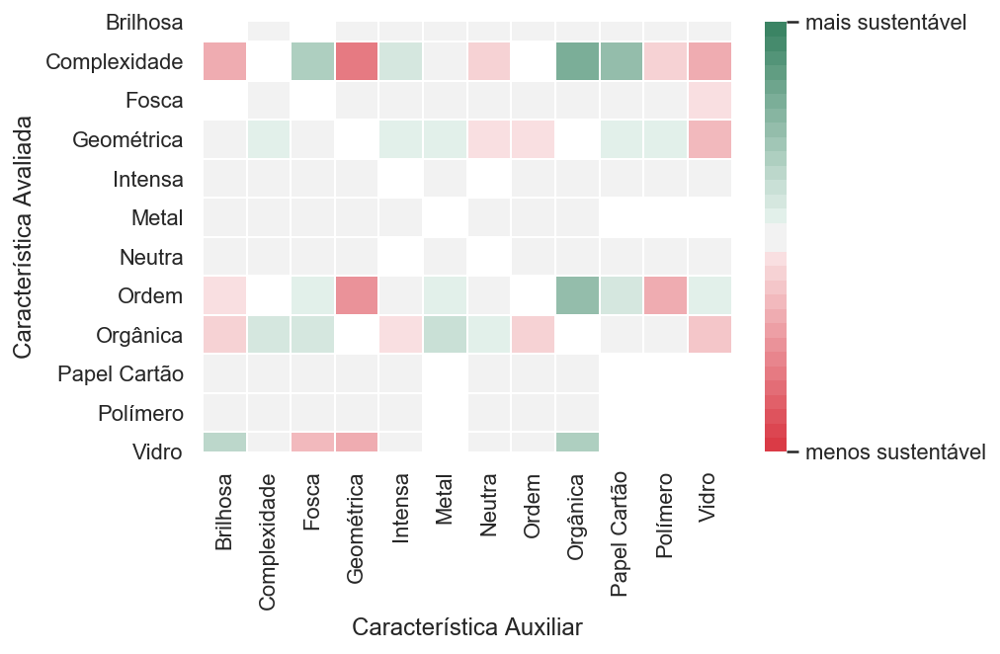

In [354]:
#sns.set(style="whitegrid")
#ax = sns.heatmap(x="propriedade_1", y="propriedade_2", size="variancia", data=packaging_features_x_features_val)

#inclua este gráfico ao lado do gráfico de barras
#lembrar que é o gráfico de variação (por isto não há destaque para papel cartão)
#gráfico de variância percentual entre características comparadas duas a duas
#ax = sns.heatmap(variance_ranges, linewidths=.5, vmin=300, vmax=-300, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
ax = sns.heatmap(variance_ranges, linewidths=.5, vmin=1000, vmax=-1000, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([1000,-1000])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Característica Auxiliar", fontsize=12)


### Análise comparativa

Agora que identificamos o sucesso de cada caracerística, seja por contagem de `votos`simples, ou utilizando o modelo de explicação de predição escolhido, podemos comparar as duas abordagem buscando divergências e correlações entre os seus resultados.

In [355]:
'''Marca os dados como fruto do LIME ou da contagem'''
packaging_features['tipo']='Contagem'
packaging_features_lime['tipo']='QVAP'

In [356]:
'''Concatena as bases para gerar o gráfico'''
packaging_features_all = pd.concat([packaging_features,packaging_features_lime],axis=0)
packaging_features_all

,nome,valor,score,occurrences,final.score,final.score.2,final.score.2.sucess,final.score.2.fail,final.score.3,tipo
0,shape,Orgânica,-572.000000,16312,-0.0350662,0.053141,5.588220,5.314082,-5.314082,Contagem
0,shape,Geométrica,572.000000,14984,0.0381741,0.055882,5.588220,5.314082,5.588220,Contagem
0,material,Vidro,296.000000,8354,0.0354321,0.051868,81.024939,81.188700,5.186835,Contagem
0,material,Polímero,-1704.000000,7410,-0.22996,0.348490,81.024939,81.188700,-34.849038,Contagem
0,material,Papel Cartão,3872.000000,7474,0.518063,0.758381,81.024939,81.188700,75.838104,Contagem
0,material,Metal,-2464.000000,8058,-0.305783,0.463397,81.024939,81.188700,-46.339662,Contagem
0,surface,Fosca,448.000000,15268,0.0293424,0.042954,4.295375,4.235826,4.295375,Contagem
0,surface,Brilhosa,-448.000000,16028,-0.0279511,0.042358,4.295375,4.235826,-4.235826,Contagem
0,color,Neutra,860.000000,15516,0.0554267,0.081138,8.113792,8.259065,8.113792,Contagem
0,color,Intensa,-860.000000,15780,-0.0544994,0.082591,8.113792,8.259065,-8.259065,Contagem


##### Cor

A paleta de cores é um importante elemento a ser considerado ao definir os elementos de um produto. Aqui, ao buscar comunicar sustetabilidade é importante considerar os alementos que compõem o atributo cor. Aqui investigamos apenas intensidade e neutralidade.

Conforme é possível perceber na figura abaixo, fica claro que neutralidade comunica sustentabilidade com mais eficiencia que intensidade. Contudo, pela contagem simples estes valores parecem mais discrepantes com relação aos dados da predição do modelo. Isto pode ser decorrente da margem de erro embutida nos resultados preditivos.

Na figura a seguir, o eixo x descreve os atributos avaliados (aqui apenas neutralidade e intensidade da cor) e o eixo y aponta a média geral de relevância daquele atributo junto aos dados. Abaixo da figura, a tabela a seguir traz a mesma informação com um maior detalhamento numérico.

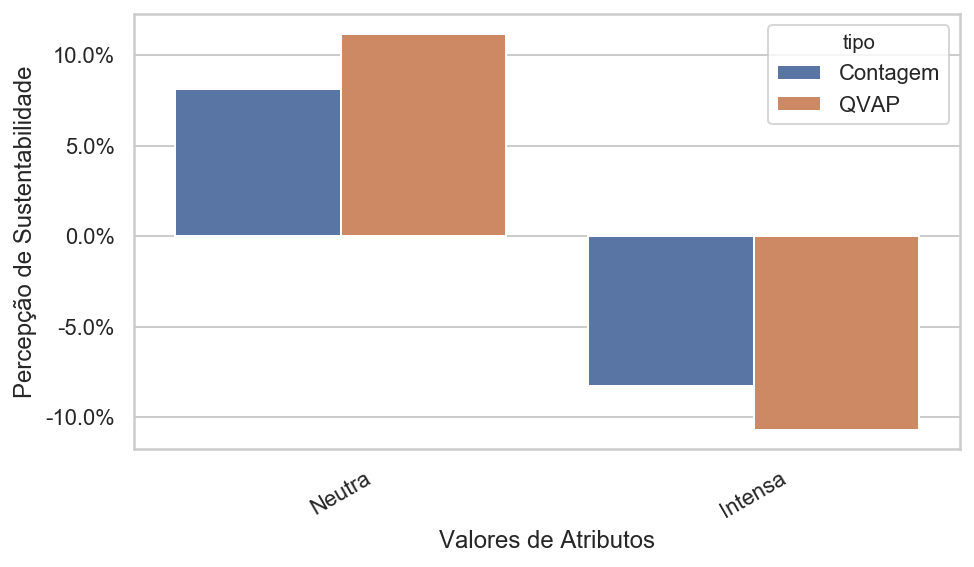

In [357]:
sns.set(style="whitegrid")
plt.figure(figsize=(7.4,4))
ax = sns.barplot(x="valor", y="final.score.3", hue="tipo", data=packaging_features_all.loc[packaging_features_all['nome'] == 'color'])


ax.set_ylabel("Percepção de Sustentabilidade", fontsize=12)
ax.set_xlabel("Valores de Atributos", fontsize=12)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 30)
ax.set_yticklabels(map('{:.1f}%'.format,ax.yaxis.get_majorticklocs()))

plt.savefig('cor_fig1.png')

In [358]:
#tabela só para cor
packaging_features_all.loc[packaging_features_all['nome'] == 'color'].loc[:,['valor','final.score.3','tipo']]

,valor,final.score.3,tipo
0,Neutra,8.113792,Contagem
0,Intensa,-8.259065,Contagem
0,Neutra,11.169028,QVAP
0,Intensa,-10.670701,QVAP


Como exemplo de utilidade do atributo cor, podemos perceber na figura abaixo que podemos melhorar a precepção de sustentabilidade de um produto alterando apenas a intensidade do atributo cor. Observe a seguinte configuração de atributos de cor Intensa tem X% de chance de ser percebida como sustentável, ao passo que invertendo o atributo cor para `Neutra` chegamos a Y%, um ganho de Z% de chance de ser percebida como sustentável por parte do consumidor.

In [359]:
#dois Limes de embalagens com maior discrepância entre neutra e intensa
aux = [v[0] for v in lime_values_df['lista']]

def sort_lime_values_list(val):
    return val[0]

possibilities = {}
for i,v in lime_values_df.iterrows():
    hash_ = ''
    list_ = v['lista']
    list_.sort(key = sort_lime_values_list)
    for x,y in v['lista']:
        #if(x.find('mais sust.=')>=0):
        hash_ = hash_ + x
    color_ = 'cor mais sust.=Neutra'
    color_2 = 'cor menos sust.=Neutra'
    if(hash_.find('cor mais sust.=Intensa')>=0):
        color_ = 'cor mais sust.=Intensa'
    if(hash_.find('cor menos sust.=Intensa')>=0):
        color_2 = 'cor menos sust.=Intensa'
    
    hash_=hash_.replace(color_,'')
    hash_=hash_.replace(color_2,'')
    
    if(not (hash_ in possibilities)):
        if(color_.find('Intensa')>=0):
            possibilities[hash_]=(i,None,v['verdadeiro'],None)
        elif(color_.find('Neutra')>=0):
            possibilities[hash_]=(None,i,None,v['verdadeiro'])
        if(color_2.find('Intensa')>=0):
            possibilities[hash_]=(i,None,v['falso'],None)
        elif(color_2.find('Neutra')>=0):
            possibilities[hash_]=(None,i,None,v['falso'])
    else:
        hash_value = possibilities[hash_]
        if(color_.find('Intensa')>=0):
            aux = hash_value[2]
            if(aux is None):
                aux = 0.0
            if(v['verdadeiro'] > aux):
                possibilities[hash_]=(i,hash_value[1],v['verdadeiro'],hash_value[3])
        elif(color_.find('Neutra')>=0):
            aux = hash_value[3]
            if(aux is None):
                aux = 0.0
            if(v['verdadeiro'] > aux):
                possibilities[hash_]=(hash_value[0],i,hash_value[2],v['verdadeiro'])
        if(color_2.find('Intensa')>=0):
            aux = hash_value[2]
            if(aux is None):
                aux = 0.0
            if(v['falso'] > aux):
                possibilities[hash_]=(i,hash_value[1],v['falso'],hash_value[3])
        elif(color_2.find('Neutra')>=0):
            aux = hash_value[3]
            if(aux is None):
                aux = 0.0
            if(v['falso'] > aux):
                possibilities[hash_]=(hash_value[0],i,hash_value[2],v['falso'])

current_value = 0
current_index_val_1 = -1
current_index_val_2 = -1
for v in possibilities:
    if(possibilities[v][3] is not None and possibilities[v][2] is not None and possibilities[v][3]-possibilities[v][2]>current_value):
        current_value = possibilities[v][3]-possibilities[v][2]
        current_index_val_1 = possibilities[v][0]
        current_index_val_2 = possibilities[v][1]
print(current_index_val_1)
print(current_index_val_2)
print(lime_values_df[current_index_val_1:current_index_val_1+1])
print(lime_values_df[current_index_val_2:current_index_val_2+1])


2954
2830
      verdadeiro     falso                                              lista
2954    0.285052 -0.714948  [(constituição mais sust.=Ordem, 0.00446571919...
      verdadeiro     falso                                              lista
2830    0.609059 -0.390941  [(constituição mais sust.=Ordem, 0.00628877077...


##### Segue abaixo um exemplo do quão pode variar o resultado de uma embalagem quanto a percepção de sustentabilidade junto ao público, variando-se apenas o fator cor. Perceba que existem duas embalagem em comparação e estas são identicas, modificando apenas a intensidade da cor de cada uma.

In [360]:
#i = 11
exp = explainer.explain_instance(packaging_2[65], predict_fn, num_features=10)
exp.show_in_notebook()


plt.savefig('cor_fig2.jpg')

<Figure size 432x288 with 0 Axes>

##### Agora invertemos a intensidade da cor

In [361]:
#i = 11
exp = explainer.explain_instance(packaging_2[190], predict_fn, num_features=10)
exp.show_in_notebook()


plt.savefig('cor_fig3.png')

<Figure size 432x288 with 0 Axes>

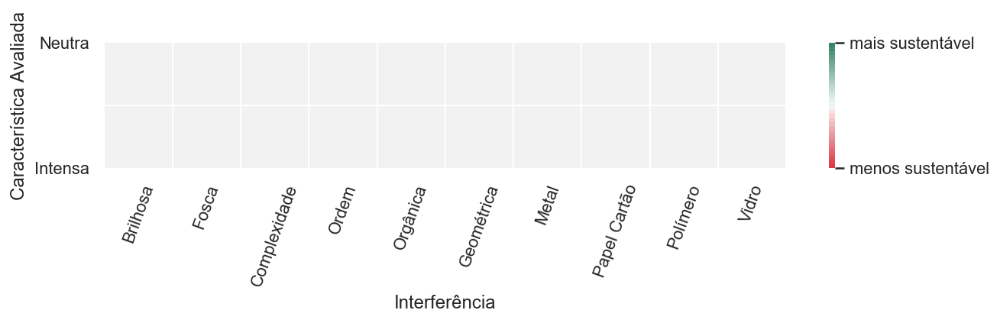

In [362]:
plt.figure(figsize=(10,3))
ax = sns.heatmap(variance_ranges[['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']].reindex(['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']).loc[['Neutra', 'Intensa'],['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']], linewidths=.5, vmin=1000, vmax=-1000, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([1000,-1000])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Interferência", fontsize=12)

ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 70)

plt.gcf().subplots_adjust(bottom=0.5)
plt.savefig('cor_fig4.png')

##### Superfície

A superfície, sendo explorada dentre os valores `Brilhosa` e `Fosca`, é outro atributo elencado com base no exposto no Capítulo X.

Conforme é possível perceber na figura abaixo, fica claro que menos brilho (Fosca) comunica sustentabilidade com mais eficiencia que mais brilho (Brilhosa). Aqui a contagem simples e o resultado do nosso modelo são quase equivalentes em números absolutos. É possível, a partir destes resultados, questionar a real utilidade do modelo QVAP. Tais questionamentos serão sanados na seção XXX.

Novamente, a figura a seguir o eixo x descreve os atributos avaliados e o eixo y aponta a média geral de relevância daquele atributo junto aos dados. Abaixo da figura, a tabela a seguir traz a mesma informação com um maior detalhamento numérico. A Tabela XX reflete em mais detalhes os números da figura X. É possível verceber que uma superfície com menos brilhosa tem aproximadamente 0,035 (3,5%) mais chance de ser percebida como sustentável tanto com base no nosso model quanto por contagem simples. Contudo, a superfície com mais brilho 0,034 (3,4%) menos chance de ser apontada como mais sustentável.

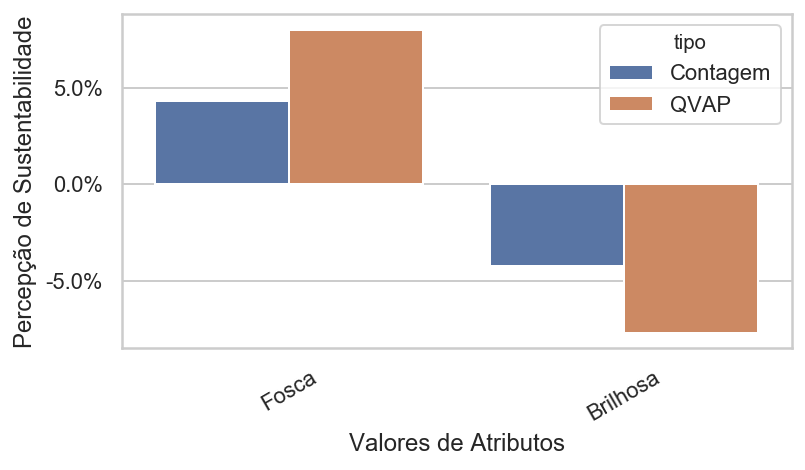

In [363]:
import matplotlib.ticker as ticker
sns.set(style="whitegrid")
ax = sns.barplot(x="valor", y="final.score.3", hue="tipo", data=packaging_features_all.loc[packaging_features_all['nome'] == 'surface'])


ax.set_ylabel("Percepção de Sustentabilidade", fontsize=12)
ax.set_xlabel("Valores de Atributos", fontsize=12)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 30)

ax.yaxis.set_major_locator(ticker.MultipleLocator(5.00))

ax.set_yticklabels(map('{:.1f}%'.format,ax.yaxis.get_majorticklocs()))

plt.gcf().subplots_adjust(bottom=0.3)
plt.savefig('superficie_fig1.png')



In [364]:
#tabela só para cor
packaging_features_all.loc[packaging_features_all['nome'] == 'surface'].loc[:,['valor','final.score.3','tipo']]

,valor,final.score.3,tipo
0,Fosca,4.295375,Contagem
0,Brilhosa,-4.235826,Contagem
0,Fosca,8.004467,QVAP
0,Brilhosa,-7.695228,QVAP


[lembre que tais resultados são estatísticos e, mesmo contra as chances, você pode obter um resultado inesperado como este ou o anterior]

In [372]:
#dois Limes de embalagens com maior discrepância entre neutra e intensa
aux = [v[0] for v in lime_values_df['lista']]

def sort_lime_values_list(val):
    return val[0]

atribute = 'superfície'
values = ('Fosca','Brilhosa')
possibilities = {}
for i,v in lime_values_df.iterrows():
    hash_ = ''
    list_ = v['lista']
    list_.sort(key = sort_lime_values_list)
    for x,y in v['lista']:
        #if(x.find('mais sust.=')>=0):
        hash_ = hash_ + x
    color_ = atribute+' mais sust.='+values[1]
    color_2 = atribute+' menos sust.='+values[1]
    if(hash_.find(atribute+' mais sust.='+values[0])>=0):
        color_ = atribute+' mais sust.='+values[0]
    if(hash_.find(atribute+' menos sust.='+values[0])>=0):
        color_2 = atribute+' menos sust.='+values[0]
    if(color_.replace(atribute+' mais sust.=','') == color_2.replace(atribute+' menos sust.=','')):
         continue
    hash_=hash_.replace(color_,'')
    hash_=hash_.replace(color_2,'')
    if(not (hash_ in possibilities)):
        if(color_.find(values[0])>=0):
            possibilities[hash_]=(i,None,v['verdadeiro'],None)
        elif(color_.find(values[1])>=0):
            possibilities[hash_]=(None,i,None,v['verdadeiro'])
        if(color_2.find(values[0])>=0):
            possibilities[hash_]=(i,None,v['falso'],None)
        elif(color_2.find(values[1])>=0):
            possibilities[hash_]=(None,i,None,v['falso'])
    else:
        hash_value = possibilities[hash_]
        if(color_.find(values[0])>=0):
            aux = hash_value[2]
            if(aux is None):
                aux = 0.0
            if(v['verdadeiro'] > aux):
                possibilities[hash_]=(i,hash_value[1],v['verdadeiro'],hash_value[3])
        elif(color_.find(values[1])>=0):
            aux = hash_value[3]
            if(aux is None):
                aux = 0.0
            if(v['verdadeiro'] > aux):
                possibilities[hash_]=(hash_value[0],i,hash_value[2],v['verdadeiro'])
        if(color_2.find(values[0])>=0):
            aux = hash_value[2]
            if(aux is None):
                aux = 0.0
            if(v['falso'] > aux):
                possibilities[hash_]=(i,hash_value[1],v['falso'],hash_value[3])
        elif(color_2.find(values[1])>=0):
            aux = hash_value[3]
            if(aux is None):
                aux = 0.0
            if(v['falso'] > aux):
                possibilities[hash_]=(hash_value[0],i,hash_value[2],v['falso'])

current_value = 0
current_index_val_1 = -1
current_index_val_2 = -1
for v in possibilities:
    if(possibilities[v][3] is not None and possibilities[v][2] is not None and abs(possibilities[v][3]-possibilities[v][2])>current_value):
        current_value = possibilities[v][3]-possibilities[v][2]
        current_index_val_1 = possibilities[v][0]
        current_index_val_2 = possibilities[v][1]
print(current_index_val_1)
print(current_index_val_2)
print(possibilities)
print(lime_values_df[current_index_val_1:current_index_val_1+1])
print(lime_values_df[current_index_val_2:current_index_val_2+1])
#     if(aux[i][0].find('cor mais sust.=Neutra')):
# for i,v in aux:
#     print(i)
#     print(aux[i])
#     if(aux[i][0].find('cor mais sust.=Neutra')):
#         if(lime_values_df[i:i]['verdadeiro']-lime_values_df[i:i]['falso']>current_value):
#             current_value = lime_values_df[i:i]['verdadeiro']-lime_values_df[i:i]['falso']
#             current_index = i
# lime_values_df[current_index:current_index]

-1
-1
{'constituição mais sust.=Ordemconstituição menos sust.=Ordemcor mais sust.=Neutracor menos sust.=Neutraforma mais sust.=Orgânicaforma menos sust.=Orgânicamaterial mais sust.=Vidromaterial menos sust.=Vidro': (None, 252, None, 0.6333313186545902), 'constituição mais sust.=Ordemconstituição menos sust.=Complexidadecor mais sust.=Neutracor menos sust.=Neutraforma mais sust.=Orgânicaforma menos sust.=Orgânicamaterial mais sust.=Vidromaterial menos sust.=Vidro': (None, 253, None, 0.7092733316025952), 'constituição mais sust.=Ordemconstituição menos sust.=Ordemcor mais sust.=Neutracor menos sust.=Intensaforma mais sust.=Orgânicaforma menos sust.=Orgânicamaterial mais sust.=Vidromaterial menos sust.=Vidro': (None, 254, None, 0.634437622200642), 'constituição mais sust.=Ordemconstituição menos sust.=Complexidadecor mais sust.=Neutracor menos sust.=Intensaforma mais sust.=Orgânicaforma menos sust.=Orgânicamaterial mais sust.=Vidromaterial menos sust.=Vidro': (None, 255, None, 0.626185798

##### Aqui foi feita a mesma dinâmica comparativa que fizemos ao tratar do fator cor

In [224]:

exp = explainer.explain_instance(packaging_2[293], predict_fn, num_features=10)
exp.show_in_notebook()

In [223]:

exp = explainer.explain_instance(packaging_2[44], predict_fn, num_features=10)
exp.show_in_notebook()

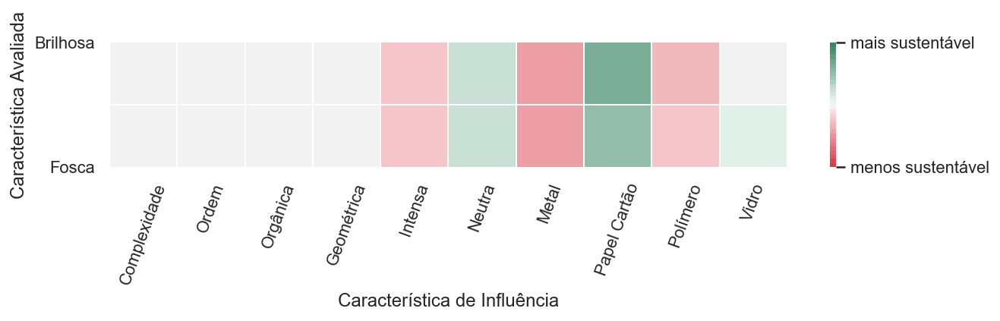

In [667]:
plt.figure(figsize=(10,3))
ax = sns.heatmap(variance_ranges[['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']].reindex(['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']).loc[['Brilhosa', 'Fosca'],['Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']], linewidths=.5, vmin=1000, vmax=-1000, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([1000,-1000])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Característica de Influência", fontsize=12)

ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 70)

plt.gcf().subplots_adjust(bottom=0.5)
plt.savefig('superficie_fig4.png')

##### Forma

O atributo forma foi distribuido entre as classes: `geométrica` e `orgânica`. Geométrica, como já descrito anteriormente, descreve formas mais poligonais (ainda que suavizadas), enquanto orgânica define formas completamente arredondadas.

Para este atributo podemos perceber na Image XXX, abaixo, que os resultados para contagem simples e o modelo QVAP são proporcionais -- os dois valores dos atributos são simetricamente diferentes. Contudo, em ambos os casos a forma geométrica se sobresai com uma melhor comunicação de sustentabilidade frente as formas mais orgânicas.

Novamente a Tabela XXX traz números mais recisos para o cenário apresentado na figura XXX. É possível perceber que conforme as predições do modelo QVAP, uma embalagem geométrica tem 0,26 (2,6%) mais chance de ser percebda como sustentável. Número similar ao alcançado por contagem simples (0,33 mais chance ou 3,3%). Contudo, vale resaltar que estes são números médios. O modelo QVAP traz ainda a correlação entre atributos, o que pode influenciar bastante o resultado.

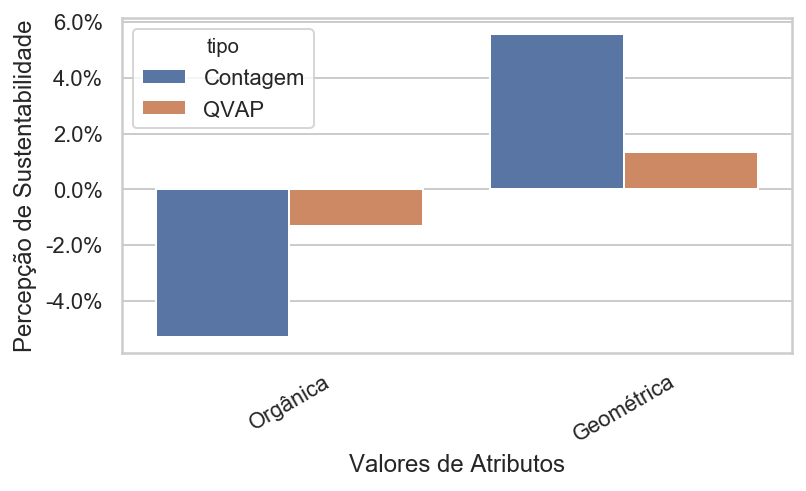

In [366]:
sns.set(style="whitegrid")
ax = sns.barplot(x="valor", y="final.score.3", hue="tipo", data=packaging_features_all.loc[packaging_features_all['nome'] == 'shape'])


ax.set_ylabel("Percepção de Sustentabilidade", fontsize=12)
ax.set_xlabel("Valores de Atributos", fontsize=12)



ax.yaxis.set_major_locator(ticker.MultipleLocator(2.00))



ax.set_xticklabels(ax.get_xticklabels(), rotation = 30)
ax.set_yticklabels(map('{:.1f}%'.format,ax.yaxis.get_majorticklocs()))

plt.gcf().subplots_adjust(bottom=0.3)
plt.savefig('forma_fig1.png')


In [367]:
#tabela só para shape
packaging_features_all.loc[packaging_features_all['nome'] == 'shape'].loc[:,['valor','final.score.3','tipo']]

,valor,final.score.3,tipo
0,Orgânica,-5.314082,Contagem
0,Geométrica,5.588220,Contagem
0,Orgânica,-1.315579,QVAP
0,Geométrica,1.354616,QVAP


Ao observar as Figuras XX e XXX, que trazem resultados de casos concrestos tomados como resultados finais do modelo QVAP, podemos perceber que a variação decorrente da alteração deste único atributo é muito maior que a média. As duas figuras, assim como em seções anteriores, trazem a comparação entre duas cnfigurações de embalagens distintas apenas com relação ao atributo `Forma`. Na Figura XX o modelo QVAP demonstra uma certeza que tende à 100% de que a embalagem geométrica é percebida como mais sustentável. Já na Figura XXX, o modelo QVAP não é capaz de apontar o potencial de sustentabilidade da embalagem analizada (50% de certeza) com relação a outra embalagens diferente da embalagem sob análise apenas em função deste atributo.

In [371]:
#dois resultados de configurações de embalagens com maior discrepância variando apenas um atributo
def get_best_distinct_settings(atribute, values):
    def sort_lime_values_list(val):
        return val[0]
    possibilities = {}
    for i,v in lime_values_df.iterrows():
        hash_ = ''
        list_ = v['lista']
        list_.sort(key = sort_lime_values_list)
        for x,y in v['lista']:
            #if(x.find('mais sust.=')>=0):
            hash_ = hash_ + x
        color_ = atribute+' mais sust.='+values[1]
        color_2 = atribute+' menos sust.='+values[1]
        if(hash_.find(atribute+' mais sust.='+values[0])>=0):
            color_ = atribute+' mais sust.='+values[0]
        if(hash_.find(atribute+' menos sust.='+values[0])>=0):
            color_2 = atribute+' menos sust.='+values[0]
        if(color_.replace(atribute+' mais sust.=','') == color_2.replace(atribute+' menos sust.=','')):
             continue
        hash_=hash_.replace(color_,'')
        hash_=hash_.replace(color_2,'')
        if(not (hash_ in possibilities)):
            if(color_.find(values[0])>=0):
                possibilities[hash_]=(i,None,v['verdadeiro'],None)
            elif(color_.find(values[1])>=0):
                possibilities[hash_]=(None,i,None,v['verdadeiro'])
            if(color_2.find(values[0])>=0):
                possibilities[hash_]=(i,None,v['falso'],None)
            elif(color_2.find(values[1])>=0):
                possibilities[hash_]=(None,i,None,v['falso'])
        else:
            hash_value = possibilities[hash_]
            if(color_.find(values[0])>=0):
                aux = hash_value[2]
                if(aux is None):
                    aux = 0.0
                if(v['verdadeiro'] > aux):
                    possibilities[hash_]=(i,hash_value[1],v['verdadeiro'],hash_value[3])
            elif(color_.find(values[1])>=0):
                aux = hash_value[3]
                if(aux is None):
                    aux = 0.0
                if(v['verdadeiro'] > aux):
                    possibilities[hash_]=(hash_value[0],i,hash_value[2],v['verdadeiro'])
            if(color_2.find(values[0])>=0):
                aux = hash_value[2]
                if(aux is None):
                    aux = 0.0
                if(v['falso'] > aux):
                    possibilities[hash_]=(i,hash_value[1],v['falso'],hash_value[3])
            elif(color_2.find(values[1])>=0):
                aux = hash_value[3]
                if(aux is None):
                    aux = 0.0
                if(v['falso'] > aux):
                    possibilities[hash_]=(hash_value[0],i,hash_value[2],v['falso'])

    current_value = 0
    current_index_val_1 = -1
    current_index_val_2 = -1
    for v in possibilities:
        if(possibilities[v][3] is not None and possibilities[v][2] is not None and abs(possibilities[v][3]-possibilities[v][2])>current_value):
            current_value = possibilities[v][3]-possibilities[v][2]
            current_index_val_1 = possibilities[v][0]
            current_index_val_2 = possibilities[v][1]
            
    return (current_index_val_1,current_index_val_2)

current_index_val_1, current_index_val_2 = get_best_distinct_settings('forma',('Orgânica','Geométrica'))

print(current_index_val_1)
print(current_index_val_2)
print(lime_values_df[current_index_val_1:current_index_val_1+1])
print(lime_values_df[current_index_val_2:current_index_val_2+1])


-1
-1
Empty DataFrame
Columns: [verdadeiro, falso, lista]
Index: []
Empty DataFrame
Columns: [verdadeiro, falso, lista]
Index: []


In [369]:

exp = explainer.explain_instance(packaging_2[2472], predict_fn, num_features=10)
exp.show_in_notebook()

In [370]:

exp = explainer.explain_instance(packaging_2[487], predict_fn, num_features=10)
exp.show_in_notebook()

Vale salientar que a análise acima é comparativa e tal resultado não garante que a embalagem percebida como mais sustentável também será percebida como tal isoladamente, pois o conjunto de resuiqisots deta análise é restrito a apenas cinco. Com isto podemos concluir que a configuração vencedora tem muito mais chance de ser reconhecida como sustentável frente a configuração perdedora, tomando todas as possíveis configurações do conjunto de atributos avaliado como domínio. A Figura XXX, abaixo, traz a influência que o atributo `forma` sofre dos demais atributos, considerando apenas análises dois a dois.

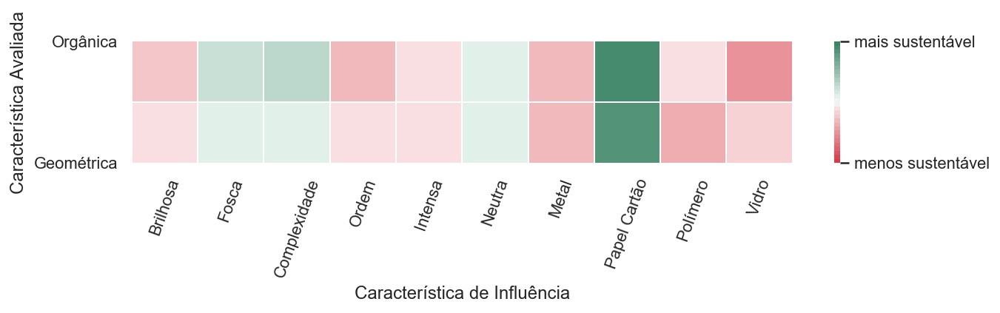

In [668]:
plt.figure(figsize=(10,3))
ax = sns.heatmap(variance_ranges[['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']].reindex(['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']).loc[['Orgânica', 'Geométrica'],['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']], linewidths=.5, vmin=1000, vmax=-1000, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([1000,-1000])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Característica de Influência", fontsize=12)

ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 70)

plt.gcf().subplots_adjust(bottom=0.5)
plt.savefig('forma_fig4.png')

A Figura XXX, assim como similares anteriores, descreve a diferença (variância) entre a percepção de sustentabilidade média de cada valor do atributo `forma`, sendo que a cor verde significa uma percepçãode sustentabilidade superior à média, e a cor vermelha um percepção de sustentabilidade inferior. Com base na Figura XXX, podemos perceber que o atributo forma sofre uma influencia mais significativa do atributo `material`, sendo o `vidro` o material que mais interfere na percepção de sustentabilidade da forma. Para embalagens orgânicas, o vidro almenta o potencial de ser percebida como sustentável, contrariando a média geral deste atributo que aponta formas mais geométricas como mais sustenáveis. Assim, caso seja indispensável utilizar formas orgânicas, utilizar embalagens de foscas, de baixa complexidade (ordem) e principalmente de vidro são medidas que colaboram com a percepção de sustentabilidade. Contudo, vale lembrar que esta análise dois a dois é muito útil por ser mais simples de visualizar, embora seja limitada. Claramenta, se o gráfico da Figura XXX comparasse três atributos ou mais, atribuir a categoria `papel Cartão` ao atributo `material` seria mais eficaz que a categoria `vidro`, embora tal propriedade seja individual do material `Papel Cartão` e não diz respeito a sua correlação com a forma. O modelo QVAP cruza todas as combinaçoes possíveis ao fazer suas recomendações.

##### Constituição 

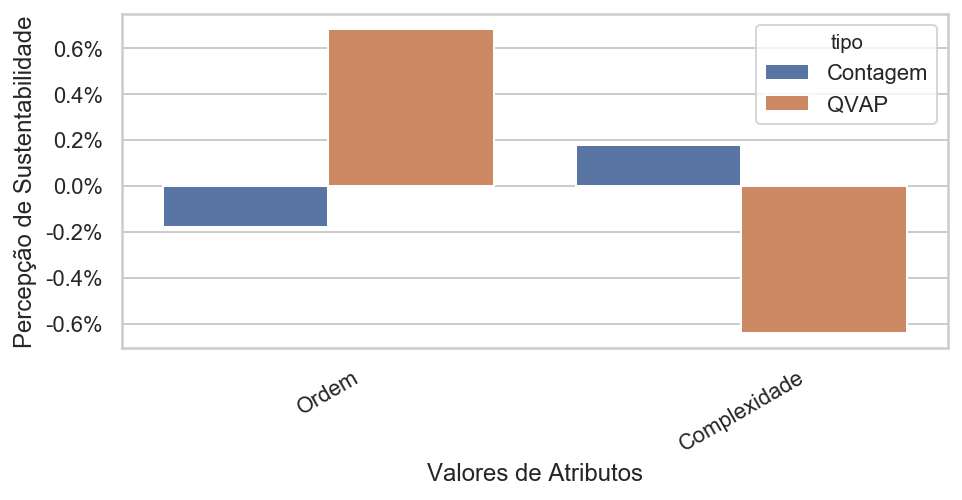

In [705]:
plt.figure(figsize=(7.4,4))
sns.set(style="whitegrid")
ax = sns.barplot(x="valor", y="final.score.3", hue="tipo", data=packaging_features_all.loc[packaging_features_all['nome'] == 'constitution'])


ax.set_ylabel("Percepção de Sustentabilidade", fontsize=12)
ax.set_xlabel("Valores de Atributos", fontsize=12)
#ax.set_xticklabels(ax.get_xticklabels(), rotation = 80)


ax.yaxis.set_major_locator(ticker.MultipleLocator(0.2))

ax.set_xticklabels(ax.get_xticklabels(), rotation = 30)
ax.set_yticklabels(map('{:.1f}%'.format,ax.yaxis.get_majorticklocs()))

plt.gcf().subplots_adjust(bottom=0.3)
plt.savefig('constituicao_fig1.png')




In [670]:
#tabela só para shape
packaging_features_all.loc[packaging_features_all['nome'] == 'constitution'].loc[:,['valor','final.score.3','tipo']]

,valor,final.score.3,tipo
0,Ordem,-0.180951,Contagem
0,Complexidade,0.176800,Contagem
0,Ordem,0.683170,QVAP
0,Complexidade,-0.640209,QVAP


In [210]:
current_index_val_1, current_index_val_2 = get_best_distinct_settings('constituição',('Ordem','Complexidade'))

print(current_index_val_1)
print(current_index_val_2)
print(lime_values_df[current_index_val_1:current_index_val_1+1])
print(lime_values_df[current_index_val_2:current_index_val_2+1])

1581
1519
      verdadeiro     falso                                              lista
1581    0.412819  0.587181  [(constituição mais sust.=Complexidade, 0.0066...
      verdadeiro     falso                                              lista
1519    0.312821  0.687179  [(constituição mais sust.=Ordem, -0.0028677793...


In [175]:
exp = explainer.explain_instance(packaging_2[102], predict_fn, num_features=10)
exp.show_in_notebook()

In [176]:
exp = explainer.explain_instance(packaging_2[40], predict_fn, num_features=10)
exp.show_in_notebook()

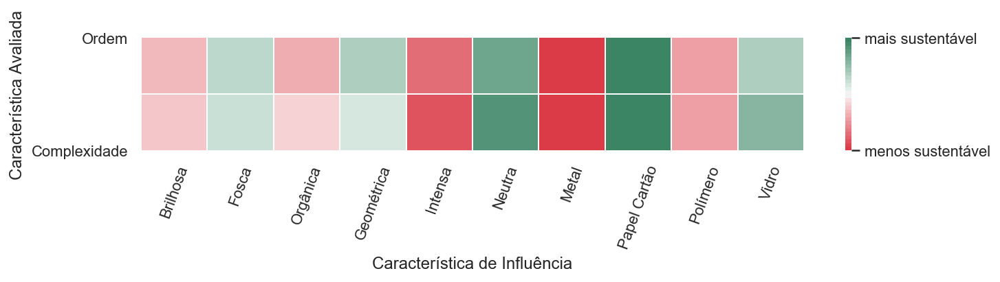

In [671]:
plt.figure(figsize=(10.8,3))
ax = sns.heatmap(variance_ranges[['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']].reindex(['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']).loc[['Ordem', 'Complexidade'],['Brilhosa', 'Fosca', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']], linewidths=.5, vmin=1000, vmax=-1000, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([1000,-1000])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Característica de Influência", fontsize=12)

#ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)


ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 70)

plt.gcf().subplots_adjust(bottom=0.5)
plt.savefig('constituicao_fig4.png')

##### Material 

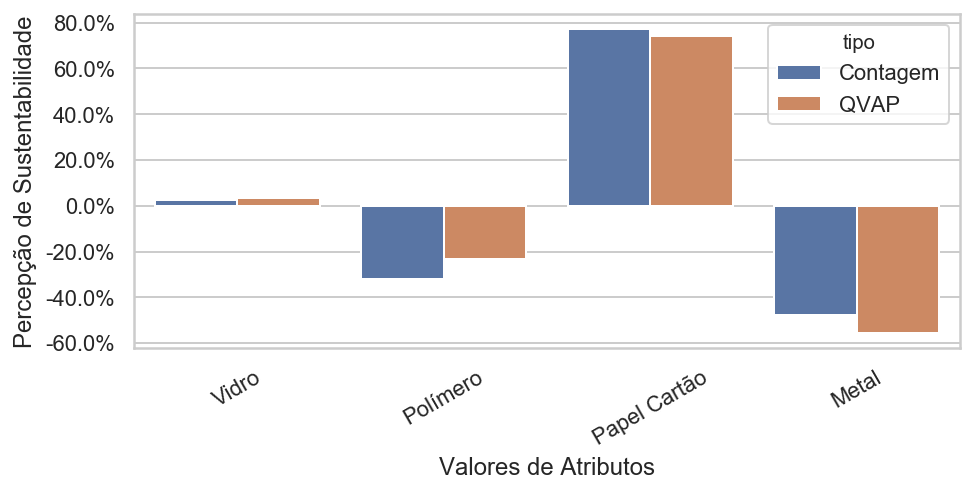

In [709]:
sns.set(style="whitegrid")
plt.figure(figsize=(7.4,4))
ax = sns.barplot(x="valor", y="final.score.3", hue="tipo", data=packaging_features_all.loc[packaging_features_all['nome'] == 'material'])


ax.set_ylabel("Percepção de Sustentabilidade", fontsize=12)
ax.set_xlabel("Valores de Atributos", fontsize=12)
#ax.set_xticklabels(ax.get_xticklabels(), rotation = 80)

ax.yaxis.set_major_locator(ticker.MultipleLocator(20.00))

ax.set_xticklabels(ax.get_xticklabels(), rotation = 30)
ax.set_yticklabels(map('{:.1f}%'.format,ax.yaxis.get_majorticklocs()))

plt.gcf().subplots_adjust(bottom=0.3)
plt.savefig('material_fig1.png')


In [673]:
#tabela só para shape
packaging_features_all.loc[packaging_features_all['nome'] == 'material'].loc[:,['valor','final.score.3','tipo']]

,valor,final.score.3,tipo
0,Vidro,2.500252,Contagem
0,Polímero,-32.176856,Contagem
0,Papel Cartão,77.081779,Contagem
0,Metal,-47.894673,Contagem
0,Vidro,3.392511,QVAP
0,Polímero,-23.101650,QVAP
0,Papel Cartão,73.988458,QVAP
0,Metal,-55.544212,QVAP


In [400]:
# dois resultados de configurações de embalagens com maior discrepância variando apenas um atributo
def get_best_distinct_settings_2(atribute, values):
    def sort_lime_values_list(val):
        return val[0]
    possibilities = {}
    for i,v in lime_values_df.iterrows():
        hash_ = ''
        list_ = v['lista']
        list_.sort(key = sort_lime_values_list)
        for x,y in v['lista']:
            hash_ = hash_ + x
        val_ = atribute+' mais sust.='+values[1]
        val_2 = atribute+' menos sust.='+values[1]
        for x in values:
            if(hash_.find(atribute+' mais sust.='+x)>=0):
                val_ = atribute+' mais sust.='+x
            if(hash_.find(atribute+' menos sust.='+x)>=0):
                val_2 = atribute+' menos sust.='+x
                
        if(val_.replace(atribute+' mais sust.=','') == val_2.replace(atribute+' menos sust.=','')):
             continue
        hash_=hash_.replace(val_,'')
        hash_=hash_.replace(val_2,'')
        if(not (hash_ in possibilities)):
            check_ = False
            for j in range(len(values)):
                if(val_.find(values[j])>=0):
                    if(check_):
                        possibilities[hash_][values[j]]=(i,v['verdadeiro'])
                    else:
                        possibilities[hash_]={values[j]:(i,v['verdadeiro'])}
                    check_ = True
                if(val_2.find(values[j])>=0):
                    if(check_):
                        possibilities[hash_][values[j]]=(i,v['falso'])
                    else:
                        possibilities[hash_]={values[j]:(i,v['falso'])}
                    check_ = True
        else:
            hash_value = possibilities[hash_]
            for j in range(len(values)):
                if(val_.find(values[j])>=0):
                    if(values[j] in hash_value):
                        aux = hash_value[values[j]]
                    else:
                        aux = (-1,0.0)
                    if(v['verdadeiro'] > aux[1]):
                        possibilities[hash_][values[j]]=(i,v['verdadeiro'])
                
                if(val_2.find(values[j])>=0):
                    if(values[j] in hash_value):
                        aux = hash_value[values[j]]
                    else:
                        aux = (-1,0.0)
                    if(v['falso'] > aux[1]):
                        possibilities[hash_][values[j]]=(i,v['falso'])

    better_diff_index = (-1,-1)
    better_diff = 0.0
    print(possibilities)
    for k in possibilities:
        for x in possibilities[k]:
            for y in possibilities[k]:
                if(possibilities[k][x][1]-possibilities[k][y][1]>better_diff):
                    better_diff = possibilities[k][x][1]-possibilities[k][y][1]
                    better_diff_index = (possibilities[k][x][0],possibilities[k][y][0])
            
    return better_diff_index

# atribute = 'superfície'
# values = ('Fosca','Brilhosa')

current_index_val_1, current_index_val_2 = get_best_distinct_settings_2('material',('Vidro','Polímero','Papel Cartão','Metal'))


print(current_index_val_1)
print(current_index_val_2)
print(lime_values_df[current_index_val_1:current_index_val_1+1])
print(lime_values_df[current_index_val_2:current_index_val_2+1])
#     if(aux[i][0].find('cor mais sust.=Neutra')):
# for i,v in aux:
#     print(i)
#     print(aux[i])
#     if(aux[i][0].find('cor mais sust.=Neutra')):
#         if(lime_values_df[i:i]['verdadeiro']-lime_values_df[i:i]['falso']>current_value):
#             current_value = lime_values_df[i:i]['verdadeiro']-lime_values_df[i:i]['falso']
#             current_index = i
# lime_values_df[current_index:current_index]

{'constituição mais sust.=Ordemconstituição menos sust.=Ordemcor mais sust.=Neutracor menos sust.=Neutraforma mais sust.=Orgânicaforma menos sust.=Orgânicasuperfície mais sust.=Foscasuperfície menos sust.=Fosca': {'Vidro': (23, 0.7895493738738423), 'Polímero': (1520, 0.7689087672095086), 'Papel Cartão': (1016, 0.883473151919366), 'Metal': (527, 0.5800171246133119)}, 'constituição mais sust.=Ordemconstituição menos sust.=Complexidadecor mais sust.=Neutracor menos sust.=Neutraforma mais sust.=Orgânicaforma menos sust.=Orgânicasuperfície mais sust.=Foscasuperfície menos sust.=Fosca': {'Vidro': (8, 0.7373581430121874), 'Polímero': (1521, 0.7129385795623954), 'Papel Cartão': (1009, 0.9604548082936977), 'Metal': (528, 0.5064793526127045)}, 'constituição mais sust.=Ordemconstituição menos sust.=Ordemcor mais sust.=Neutracor menos sust.=Intensaforma mais sust.=Orgânicaforma menos sust.=Orgânicasuperfície mais sust.=Foscasuperfície menos sust.=Fosca': {'Vidro': (25, 0.8328210656890415), 'Políme

In [488]:
exp = explainer.explain_instance(packaging_2[1133], predict_fn, num_features=10)
exp.show_in_notebook()

In [404]:
exp = explainer.explain_instance(packaging_2[629], predict_fn, num_features=10)#1621
exp.show_in_notebook()

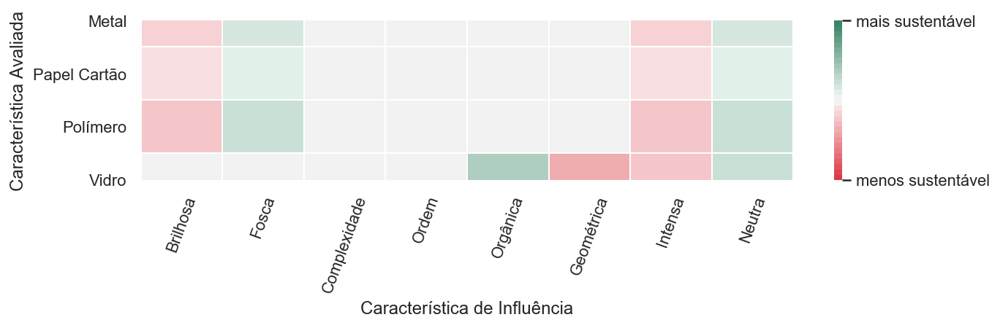

In [674]:
plt.figure(figsize=(10,4))
ax = sns.heatmap(variance_ranges[['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']].reindex(['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']).loc[['Metal', 'Papel Cartão', 'Polímero', 'Vidro'],['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  ]], linewidths=.5, vmin=1000, vmax=-1000, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([1000,-1000])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Característica de Influência", fontsize=12)

#ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)


ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 70)

plt.gcf().subplots_adjust(bottom=0.5)
plt.savefig('material_fig4.png')

#### Visão Geral

#### Veja novamente a matriz de correlação, agora com o coeficiente mais alto, o que diminui a diversidade de cores

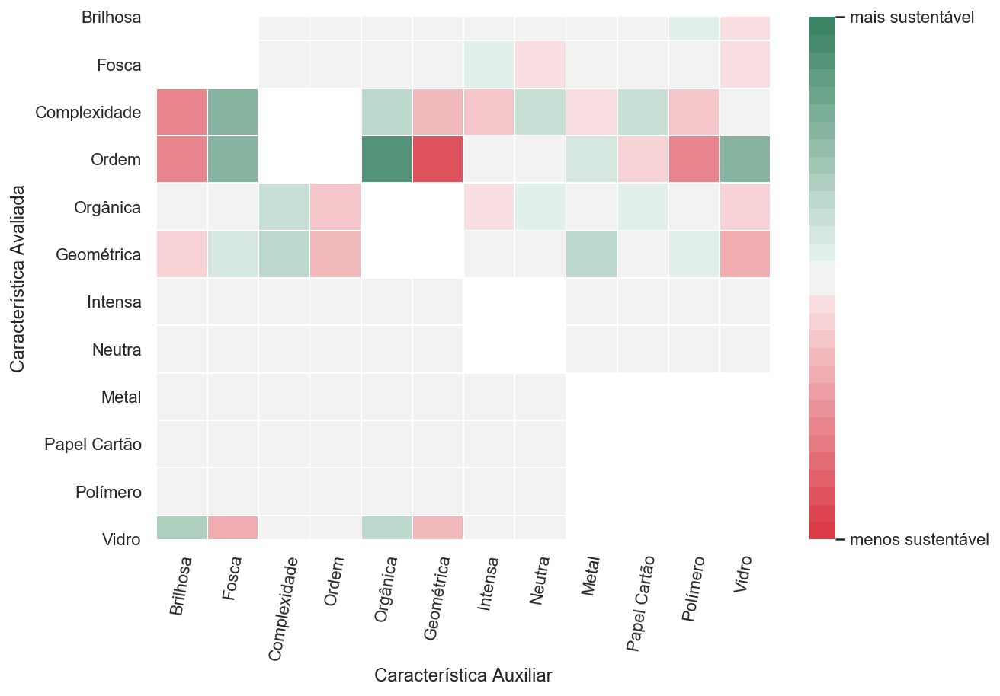

In [263]:
plt.figure(figsize=(10,7))
#inclua este gráfico ao lado do gráfico de barras
#lembrar que é o gráfico de variação (por isto não há destaque para papel cartão)
#gráfico de variância percentual entre características comparadas duas a duas
ax = sns.heatmap(variance_ranges[['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']].reindex(['Brilhosa', 'Fosca', 'Complexidade', 'Ordem', 'Orgânica', 'Geométrica', 'Intensa', 'Neutra',
                  'Metal', 'Papel Cartão', 'Polímero', 'Vidro']), linewidths=.5, vmin=800, vmax=-800, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([800,-800])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Característica Auxiliar", fontsize=12)


ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 80)

plt.gcf().subplots_adjust(left=0.2,bottom=0.2)
#plt.savefig('vg_fig4.png')

In [505]:
#gerar resultados para as 64X63 comparações

lime_values = []
for i in range(len(packaging_2)):
    exp = explainer.explain_instance(packaging_2[i], predict_fn, num_features=10)
    list_ = exp.as_list()
    
    verdadeiro = sum([x if x>=0 else 0 for i,x in list_])
    falso = sum([x if x<0 else 0 for i,x in list_])
    total = -1*falso + verdadeiro
    verdadeiro_per = verdadeiro/total
    falso_per = falso/total
    
    lime_values.append({"verdadeiro":verdadeiro_per,"falso":-1*falso_per,"lista":exp.as_list()})
lime_values

[{'verdadeiro': 0.5512940177903218,
  'falso': 0.44870598220967806,
  'lista': [('cor mais sust.=Neutra', 0.07367265248570638),
   ('superfície mais sust.=Fosca', 0.04508331339946171),
   ('cor menos sust.=Neutra', -0.026505992446459625),
   ('constituição mais sust.=Ordem', -0.02408765251876776),
   ('forma mais sust.=Orgânica', -0.023391078082026468),
   ('superfície menos sust.=Fosca', -0.017050199057528744),
   ('material menos sust.=Vidro', -0.012283874319535683),
   ('constituição menos sust.=Complexidade', 0.006505998934207721),
   ('forma menos sust.=Orgânica', 0.004896607626637841),
   ('material mais sust.=Vidro', -0.0026191027868626296)]},
 {'verdadeiro': 0.8109450373397753,
  'falso': 0.1890549626602247,
  'lista': [('cor mais sust.=Neutra', 0.058803777117201944),
   ('superfície mais sust.=Fosca', 0.042912123917206835),
   ('cor menos sust.=Intensa', 0.03622239697565231),
   ('material mais sust.=Vidro', 0.013188276715166687),
   ('constituição mais sust.=Ordem', -0.013085

In [506]:
lime_values_df = pd.DataFrame(lime_values)

In [567]:
#cria a lista de features

packaging_features = pd.DataFrame(columns=['nome','valor','score','occurrences','final.score'])
cols = packagings.columns.drop(['id','URL'])
for i in range(len(cols)):
    aux = packagings.loc[:][cols[i]].unique()
    for j in range(len(aux)):
        packaging_features = packaging_features.append(pd.DataFrame({'nome':[cols[i]],'valor':[aux[j]], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0}))

In [621]:
'''Incrementa a pontuação de cada feature com base nos resultados do LIME'''
packaging_features_lime = packaging_features.copy()
for i,v in lime_values_df.iterrows():
    features_ = v['lista']
    for name,value in features_:
        if(name.find('mais sust')>=0):
            name_ = name.split(' mais sust.=')[1]
            if(packaging_features_lime.loc[packaging_features_lime['valor']==name_,'valor'][0]==name_):
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'score'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['score'] + value
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'occurrences'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['occurrences'] + 1
        elif(name.find('menos sust')>=0):
            name_ = name.split(' menos sust.=')[1]
            if(packaging_features_lime.loc[packaging_features_lime['valor']==name_,'valor'][0]==name_):
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'score'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['score'] - value
                packaging_features_lime.loc[packaging_features_lime['valor']==name_,'occurrences'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['occurrences'] + 1

In [609]:
'''Incrementa a pontuação de cada feature como uma contagem de sucessos simples'''
for i,v in comparisons_train_cleaned.iterrows():
    count = -1
    if(v['result']):
        count = -count
    for x in comparisons_train_cleaned.columns:
        
        if(x.find('_theLess')>=0):
            if(packaging_features.loc[packaging_features['valor']==v[x],'valor'][0]==v[x]):
                packaging_features.loc[packaging_features['valor']==v[x],'score'] = packaging_features.loc[packaging_features['valor']==v[x]]['score'] - count
                packaging_features.loc[packaging_features['valor']==v[x],'occurrences'] = packaging_features.loc[packaging_features['valor']==v[x]]['occurrences'] + 1
        elif(x.find('_theMost')>=0):
            if(packaging_features.loc[packaging_features['valor']==v[x],'valor'][0]==v[x]):
                packaging_features.loc[packaging_features['valor']==v[x],'score'] = packaging_features.loc[packaging_features['valor']==v[x]]['score'] + count
                packaging_features.loc[packaging_features['valor']==v[x],'occurrences'] = packaging_features.loc[packaging_features['valor']==v[x]]['occurrences'] + 1

In [612]:
packaging_features.loc[:,'final.score'] = packaging_features['score']/packaging_features['occurrences']
packaging_features

,nome,valor,score,occurrences,final.score
0,shape,Orgânica,-418.0,13294,-0.0314428
0,shape,Geométrica,419.0,12745,0.0328756
0,material,Vidro,134.0,6918,0.0193698
0,material,Polímero,-1370.0,6102,-0.224517
0,material,Papel Cartão,3427.0,6289,0.54492
0,material,Metal,-2190.0,6730,-0.325409
0,surface,Fosca,448.0,12814,0.0349618
0,surface,Brilhosa,-448.0,13224,-0.0338778
0,color,Neutra,939.0,12919,0.0726836
0,color,Intensa,-939.0,13119,-0.0715756


In [622]:
packaging_features_lime.loc[:,'final.score'] = packaging_features_lime['score']/packaging_features_lime['occurrences']
packaging_features_lime

,nome,valor,score,occurrences,final.score
0,shape,Orgânica,-463.989357,17326,-0.0267799
0,shape,Geométrica,465.564024,16777,0.0277501
0,material,Vidro,125.564395,8934,0.0140547
0,material,Polímero,-1577.366372,8118,-0.194305
0,material,Papel Cartão,4012.320584,8305,0.483121
0,material,Metal,-2602.121723,8746,-0.297521
0,surface,Fosca,558.724817,16846,0.0331666
0,surface,Brilhosa,-558.314470,17256,-0.0323548
0,color,Neutra,1148.168960,16951,0.0677346
0,color,Intensa,-1148.265313,17151,-0.0669503


In [654]:
packaging_features['tipo']='contagem'
packaging_features_lime['tipo']='lime'

In [657]:
packaging_features_all = pd.concat([packaging_features,packaging_features_lime],axis=0)
packaging_features_all

,nome,valor,score,occurrences,final.score,tipo
0,shape,Orgânica,-418.000000,13294,-0.0314428,contagem
0,shape,Geométrica,419.000000,12745,0.0328756,contagem
0,material,Vidro,134.000000,6918,0.0193698,contagem
0,material,Polímero,-1370.000000,6102,-0.224517,contagem
0,material,Papel Cartão,3427.000000,6289,0.54492,contagem
0,material,Metal,-2190.000000,6730,-0.325409,contagem
0,surface,Fosca,448.000000,12814,0.0349618,contagem
0,surface,Brilhosa,-448.000000,13224,-0.0338778,contagem
0,color,Neutra,939.000000,12919,0.0726836,contagem
0,color,Intensa,-939.000000,13119,-0.0715756,contagem


Agora que conhecemos a interação entre todos os fatores isoladamente, podemos fazer um apanhado geral. Abaixo temos um gráfico de barras que apresenta a diferença entre a influência de cada fator no resultado final (sustentável ou não). As barras vermelhas representam os resultados do modelo preditivo, já as barras azuis referen-se ao resultado da contagem simples. Perceba que, desconsiderando o resultado particular, não há muita diferença entre elas. Tal observação enfatiza a conclusão de que a metodologia proposta aqui se mostra útil no resultado particular, e não ao tratar de um estudo geral.

[Text(0, 0, 'Orgânica'),
 Text(0, 0, 'Geométrica'),
 Text(0, 0, 'Vidro'),
 Text(0, 0, 'Polímero'),
 Text(0, 0, 'Papel Cartão'),
 Text(0, 0, 'Metal'),
 Text(0, 0, 'Fosca'),
 Text(0, 0, 'Brilhosa'),
 Text(0, 0, 'Neutra'),
 Text(0, 0, 'Intensa'),
 Text(0, 0, 'Ordem'),
 Text(0, 0, 'Complexidade')]

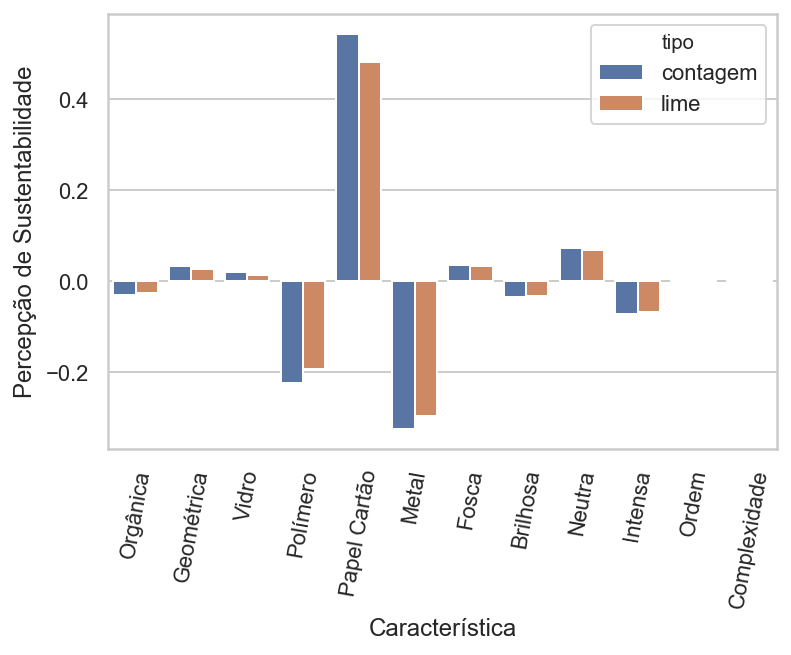

In [668]:
sns.set(style="whitegrid")
ax = sns.barplot(x="valor", y="final.score", hue="tipo", data=packaging_features_all)


ax.set_ylabel("Percepção de Sustentabilidade", fontsize=12)
ax.set_xlabel("Característica", fontsize=12)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 80)

In [282]:
'''correlação entre dois features
não inclua correlações mais profundas (mais de um feature)'''
packaging_features_x_features = pd.DataFrame(columns=['propriedade_1','propriedade_2','score','occurrences','final.score'])
for i,v in packaging_features_lime.iterrows():
    for j,x in packaging_features_lime.iterrows():
        if(v['nome']!=x['nome']):
            packaging_features_x_features = packaging_features_x_features.append(pd.DataFrame({'propriedade_1':[v['valor']],'propriedade_2':[x['valor']], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0}))

In [286]:
#packaging_features_x_features['variancia'] = 0.0

packaging_features_x_features_val = packaging_features_x_features.join(packaging_features_lime.set_index('valor').loc[:,['final.score']], on='propriedade_1', rsuffix='.lime')
#packaging_features_x_features_val['variancia'] = np.round((10000*(packaging_features_x_features_val['final.score.lime']-packaging_features_x_features_val['final.score'])/packaging_features_x_features_val['final.score.lime']).astype(float)).astype(int)
packaging_features_x_features_val['variancia'] = np.round((100000*packaging_features_x_features_val['final.score']).astype(float)).astype(int)
packaging_features_x_features_val=packaging_features_x_features_val.reset_index()
#packaging_features_x_features_val['variancia'] = np.round(packaging_features_x_features_val['variancia'].astype(float))

# for i,v in packaging_features_x_features.iterrows():
#     for j,x in packaging_features_lime.iterrows():
#     if(v['final.score']!=x['nome']):
        
        
        
        
        
#     packaging_features_x_features.loc[packaging_features_lime['valor']==v['propriedade_1','score'] = packaging_features_lime.loc[packaging_features_lime['valor']==name_]['score'] + value
#     packaging_features_x_features = packaging_features_x_features.append(pd.DataFrame({'propriedade_1':[v['valor']],'propriedade_2':[x['valor']], 'score': 0.0, 'occurrences' : 0, 'final.score' : 0.0}))
# packaging_features_x_features.head(50)

#### Veja novamente a matriz de correlação, agora em ordem aleatória, para criar uma disperção de cores.

Text(0.5, 12.453125, 'Característica Auxiliar')

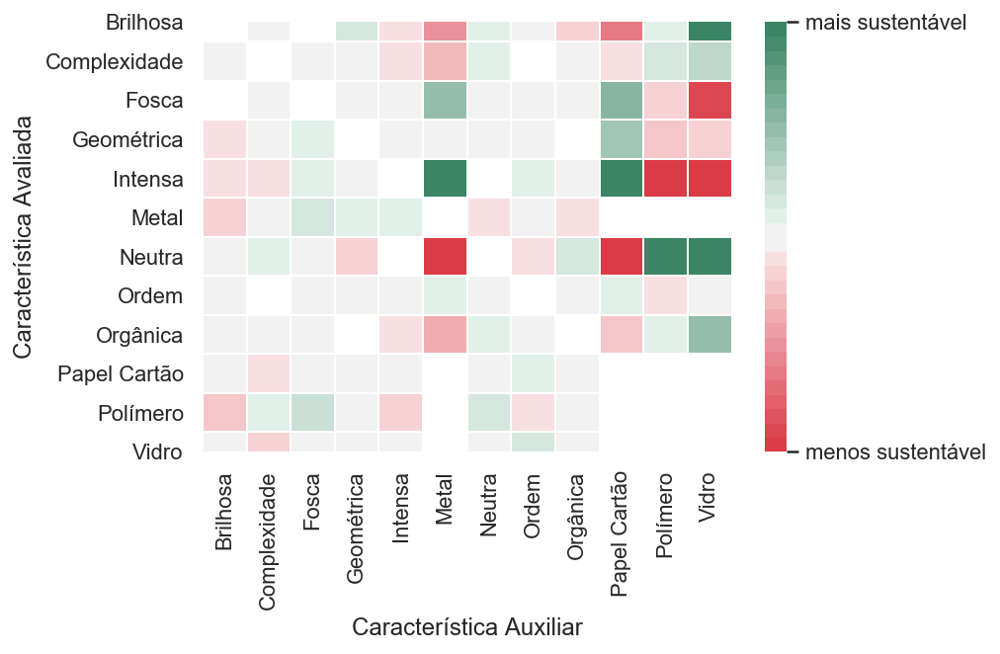

In [1149]:
#sns.set(style="whitegrid")
#ax = sns.heatmap(x="propriedade_1", y="propriedade_2", size="variancia", data=packaging_features_x_features_val)

#inclua este gráfico ao lado do gráfico de barras
#lembrar que é o gráfico de variação (por isto não há destaque para papel cartão)
#gráfico de variância percentual entre características comparadas duas a duas
#ax = sns.heatmap(variance_ranges, linewidths=.5, vmin=300, vmax=-300, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
ax = sns.heatmap(variance_ranges, linewidths=.5, vmin=250, vmax=-250, cmap=sns.diverging_palette(10, 150, sep=10, n=30))#"YlGnBu") # space between cells)
cbar = ax.collections[0].colorbar
#cbar.set_ticks([300,-300])
cbar.set_ticks([250,-250])
cbar.set_ticklabels(['mais sustentável','menos sustentável'])
ax.set_ylabel("Característica Avaliada", fontsize=12)
ax.set_xlabel("Característica Auxiliar", fontsize=12)






#ax.set_xticklabels(ax.get_xticklabels(), rotation = 10)
# ax.get_xticklabels()[:]
# ax.set_xticklabels(
#     ax.get_xticklabels(), 
#     rotation=45, 
#     horizontalalignment='right',
#     fontweight='light',
#     fontsize='x-large'

# )


In [825]:
'''Incrementa a pontuação de cada feature x feature com base nos resultados do LIME
Mede o sucesso de uma feture em relação as demais (variação)'''
for i,v in lime_values_df.iterrows():
    features_ = v['lista']
    fator = 1 #fator que inverte  a contribuição de uma ocorrência quando ela é de fracasso
    for grau_1,value_1 in features_:
        split_re = ' '
        if(grau_1.find('mais sust')>=0):
            split_re = ' mais sust.='
        elif(grau_1.find('menos sust')>=0):
            split_re = ' menos sust.='
            fator = -fator
        else:
            continue
            
        aux = grau_1.split(split_re)
        atributo_1_ = aux[0]
        grau_1_ = aux[1]
        
      
        for grau_2,value_2 in features_:
#             split_re_2 = ' '
#             if(grau_2.find('mais sust')>=0):
#                 split_re_2 = ' mais sust.='
#             elif(grau_2.find('menos sust')>=0):
#                 split_re_2 = ' mais sust.='
#             else:
#                 continue
#             aux = name.split(split_re_2)
#             atributo_2_ = aux[0]
#             grau_2_ = aux[1]
            if(grau_2.find(split_re)<0): #só compara com ocorrências no mesmo produto
                continue
            aux = grau_2.split(split_re)
            atributo_2_ = aux[0]
            grau_2_ = aux[1]
            
            if(atributo_1_ != atributo_2_):
                valuee = (packaging_features_x_features["propriedade_1"]==grau_1_) & (packaging_features_x_features["propriedade_2"]==grau_2_)
                packaging_features_x_features.loc[(packaging_features_x_features["propriedade_1"]==grau_1_) & 
                                                  (packaging_features_x_features["propriedade_2"]==grau_2_),'score'] = packaging_features_x_features.loc[(packaging_features_x_features["propriedade_1"]==grau_1_) & 
                                                  (packaging_features_x_features["propriedade_2"]==grau_2_),'score'] + value_1*fator
                packaging_features_x_features.loc[(packaging_features_x_features['propriedade_1']==grau_1_) & 
                                                  (packaging_features_x_features['propriedade_2']==grau_2_),'occurrences'] = packaging_features_x_features.loc[(packaging_features_x_features['propriedade_1']==grau_1_) & 
                                                  (packaging_features_x_features['propriedade_2']==grau_2_),'occurrences'] + 1
            
           

In [1001]:
packaging_features_x_features=packaging_features_x_features.drop('final.score.mean',axis=1)
packaging_features_x_features

,propriedade_1,propriedade_2,score,occurrences,final.score
0,Orgânica,Vidro,-0.587109,1008,-0.000582
0,Orgânica,Polímero,-1.582344,1008,-0.001570
0,Orgânica,Papel Cartão,-2.492331,1008,-0.002473
0,Orgânica,Metal,-2.902214,1008,-0.002879
0,Orgânica,Fosca,-3.576796,2016,-0.001774
...,...,...,...,...,...
0,Complexidade,Metal,-0.396382,1008,-0.000393
0,Complexidade,Fosca,0.425666,2016,0.000211
0,Complexidade,Brilhosa,0.772933,2016,0.000383
0,Complexidade,Neutra,1.155840,2016,0.000573


# A partir daqui são expostos todos os ensaios e testes como outros algoritmo ou até outros modelos gráficos. Não há valor informativo no código a seguir e não foi apagado apenas por questão de transparência



In [998]:
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import GradientBoostingClassifier

In [97]:
pipeline = GradientBoostingClassifier(learning_rate=0.1, max_depth=6, max_features=0.8, min_samples_leaf=8, min_samples_split=10, n_estimators=100, subsample=0.6500000000000001)

In [95]:
pipeline = GradientBoostingClassifier(learning_rate=0.05, n_estimators=100,max_depth=9, min_samples_split=6, 
                                min_samples_leaf=20, subsample=.7,max_features=17, random_state=seed)

In [98]:
pipeline.fit(X_comparisons_train_categories_train.values, y_train_comparisons_train)

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=6,
                           max_features=0.8, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=8, min_samples_split=10,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.6500000000000001,
                           tol=0.0001, validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [99]:
gb_pred = pipeline.predict(X_comparisons_train_categories_valid.values)

In [101]:
# Importando as bibliotecas para as métricas
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score
from sklearn.metrics import f1_score, precision_score, roc_auc_score, recall_score
from mlxtend.plotting import plot_decision_regions, plot_confusion_matrix, plot_learning_curves

Acurácia do modelo: 0.72
Precision: 0.73
F1 do modelo: 0.71
Recall do modelo: 0.68
AUC ROC: 0.72

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.70      0.75      0.72      1896
           1       0.73      0.68      0.71      1944

    accuracy                           0.72      3840
   macro avg       0.72      0.72      0.71      3840
weighted avg       0.72      0.72      0.71      3840


Matriz de confusão
[[1416  480]
 [ 614 1330]]


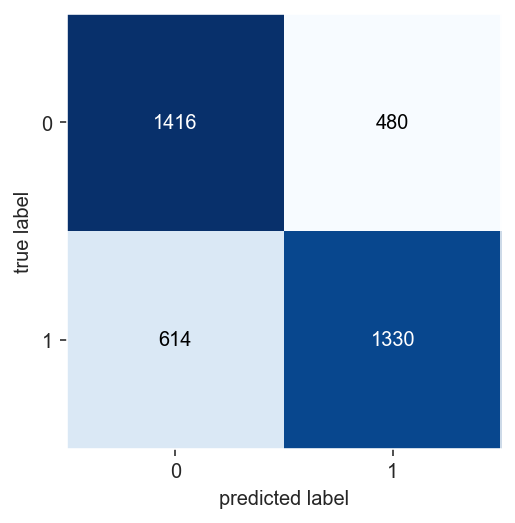

In [102]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,gb_pred),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,gb_pred)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,gb_pred)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

In [86]:
from sklearn.model_selection import GridSearchCV

In [87]:
grid = GridSearchCV(SVC(),param_grid,refit=True,verbose=0)
grid.fit(X_comparisons_train_categories_train.values,y_train_comparisons_train)

NameError: name 'SVC' is not defined

In [40]:
# Criando o dataset de treino após o pré-processamento
# Criando novo dataset com as variáveis numéricas e as variáveis dummy
scores_final = pd.concat([scores_cleaned[['score']],scores_categories],axis=1)

In [41]:
### Separando as variáveis preditodas e alvo 
# variáveis preditoras
X_scores = scores_final.drop('score',axis=1)
# variável alvo
y_scores = scores_final['score']

### Métricas de Classificação

Utilizaremos as seguintes méticas para a avaliação dos modelos:

#### Acurácia

   É basicamente o número de acertos (positivos) divido pelo número total de exemplos. Ela deve ser usada em datasets com a mesma proporção de exemplos para cada classe, e quando as penalidades de acerto e erro para cada classe forem as mesmas.

   Em problemas com classes desproporcionais, ela causa uma falsa impressão de bom desempenho. Por exemplo, num dataset em que 80% dos exemplos pertençam a uma classe, só de classificar todos os exemplos naquela classe já se atinge uma precisão de 80%, mesmo que todos os exemplos da outra classe estejam classificados incorretamente.

    $Acurácia = \frac{Verdadeiros Positivos (TP) + Falsos Positivos (TP)}{Total}$

#### Precisão

   Número de exemplos classificados como pertencentes a uma classe, que realmente são daquela classe (verdadeiros positivos), dividido pela soma entre este número, e o número de exemplos classificados nesta classe, mas que pertencem a outras (falsos positivos).

    $Precisão = \frac{Verdadeiros Positivos (TP)}{Verdadeiros Positivos (TP) + Falsos Positivos (TP)}$

#### Recall

   Número de exemplos classificados como pertencentes a uma classe, que realmente são daquela classe, dividido pela quantidade total de exemplos que pertencem a esta classe, mesmo que sejam classificados em outra. No caso binário, verdadeiros positivos divididos por total de positivos.

    $Recall = \frac{Verdadeiros Positivos (TP)}{Verdadeiros Positivos (TP) + Falsos Negativos (FN)}$

#### F1 Score

   O F1 Score é uma média harmônica entre precisão e recall.

   Ela é muito boa quando você possui um dataset com classes desproporcionais, e o seu modelo não emite probabilidades. Isso não significa que não possa ser usada com modelos que emitem probabilidades, tudo depende do objetivo de sua tarefa de machine learning.

   Em geral, quanto maior o F1 score, melhor.    

    $F1 Score = \frac{2 * precisão * recall}{precisão + recall}$

#### AUC – Area Under the ROC Curve

<img src="auc.png" width="300" height="300"  align="left"/> 

   Esta é uma métrica interessante para tarefas com classes desproporcionais. Nela, mede-se a área sob uma curva formada pelo gráfico entre a taxa de exemplos positivos, que realmente são positivos, e a taxa de falsos positivos.

   Uma das vantagens em relação ao F1 Score, é que ela mede o desempenho do modelo em vários pontos de corte, não necessariamente atribuindo exemplos com probabilidade maior que 50% para a classe positiva, e menor, para a classe negativa.

   Em sistemas que se interessam apenas pela classe, e não pela probabilidade, ela pode ser utilizada para definir o melhor ponto de corte para atribuir uma ou outra classe a um exemplo. Este ponto de corte normalmente é o ponto que se localiza mais à esquerda, e para o alto, no gráfico, mas depende bastante do custo do erro na previsão de uma determinada classe.
   
Fonte: http://mariofilho.com/as-metricas-mais-populares-para-avaliar-modelos-de-machine-learning/


#### Essas méticas no Scikit-Learn

*metrics.accuracy_score(y_true, y_pred[, …])* ->  Accuracy classification score.
 
*metrics.precision_score(y_true, y_pred[, …])* -> Compute the precision

*metrics.f1_score(y_true, y_pred[, labels, …])* -> Compute the F1 score, also known as balanced F-score or F-measure

*metrics.recall_score(y_true, y_pred[, …])* -> 	Compute the recall

*metrics.roc_auc_score(y_true, y_score[, …])* -> 	Compute Area Under the Receiver Operating Characteristic Curve (ROC AUC) from prediction scores.

*metrics.classification_report(y_true, y_pred)* -> 	Build a text report showing the main classification metrics

*metrics.confusion_matrix(y_true, y_pred[, …])* -> 	Compute confusion matrix to evaluate the accuracy of a classification

###  Como ler uma Matriz de Confusão

<img src="matrizConfusao.png" width="300" height="300"  align="left"/>

### Importando as bibliotecas para as métricas

In [42]:
# Importando as bibliotecas para as métricas
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score
from sklearn.metrics import f1_score, precision_score, roc_auc_score, recall_score
from mlxtend.plotting import plot_decision_regions, plot_confusion_matrix, plot_learning_curves

## Construindo os modelos

### MODELO 01  - Regressão Logística

Primeiramente vamos criar um modelo de regressão logística simples para vermos como se comporta

#### Divisão treino-teste

In [43]:
#from sklearn.model_selection import train_test_split
# Vamos começar dividindo nossos dados em um conjunto de treinamento e conjunto de testes.
#X_train_comparisons_train, X_train_comparisons_valid, y_train_comparisons_train, y_train_comparisons_valid = train_test_split(X_train_comparisons, y_train_comparisons, test_size=0.30,random_state=101)
X_scores_train, X_scores_test, y_scores_train, y_scores_test = train_test_split(X_scores, y_scores, test_size=0.30,random_state=101)


#### Treino e predição

In [44]:
from sklearn.linear_model import LogisticRegression
# Treinando o modelo
logit_comparisons = LogisticRegression(solver='lbfgs', max_iter=400)
# Fit do modelo
logit_comparisons.fit(X_comparisons_train_categories_train,y_train_comparisons_train)
# Predição do modelo
logit_pred_comparisons = logit_comparisons.predict(X_comparisons_train_categories_valid)



In [45]:
from sklearn.linear_model import LogisticRegression
# Treinando o modelo
logit_scores = LogisticRegression(solver='lbfgs', max_iter=400, multi_class='auto')
# Fit do modelo
logit_scores.fit(X_scores_train,y_scores_train)
# Predição do modelo
logit_pred_scores = logit_scores.predict(X_scores_test)

#### Avaliação do modelo

In [46]:
# Métricas
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,logit_pred_comparisons),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,logit_pred_comparisons),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,logit_pred_comparisons),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,logit_pred_comparisons),2)))
print(color.BOLD + 'AUC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,logit_pred_comparisons),2)))


print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_scores_test,logit_pred_scores),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_scores_test,logit_pred_scores,average='micro'),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_scores_test,logit_pred_scores,average='micro'),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_scores_test,logit_pred_scores,average='micro'),2)))
#print(color.BOLD + 'AUC: ' + color.END + str(round(roc_auc_score(y_scores_test,logit_pred_scores,average='micro'),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,logit_pred_comparisons)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

cr = classification_report(y_scores_test,logit_pred_scores)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))


Acurácia do modelo: 0.71
Precision: 0.73
F1 do modelo: 0.7
Recall do modelo: 0.67
AUC: 0.71
Acurácia do modelo: 0.0
Precision: 0.0
F1 do modelo: 0.0
Recall do modelo: 0.0

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.70      0.76      0.73      2357
           1       0.73      0.67      0.70      2338

    accuracy                           0.71      4695
   macro avg       0.71      0.71      0.71      4695
weighted avg       0.71      0.71      0.71      4695


Relatório de Classificação
              precision    recall  f1-score   support

       103.0       0.00      0.00      0.00       1.0
       140.0       0.00      0.00      0.00       0.0
       147.0       0.00      0.00      0.00       0.0
       163.0       0.00      0.00      0.00       1.0
       164.0       0.00      0.00      0.00       2.0
       168.0       0.00      0.00      0.00       0.0
       179.0       0.00      0.00      0.00       1.0
       182.0 

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\metrics\classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)



Matriz de confusão
[[1790  567]
 [ 783 1555]]


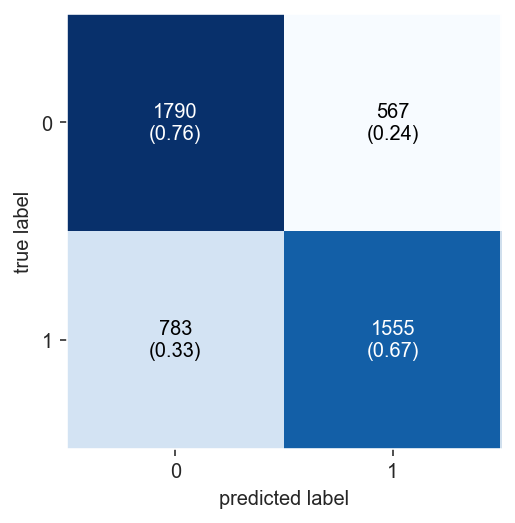

In [47]:


# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,logit_pred_comparisons)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm, show_normed=True)

plt.show()

#### Importância dos Atributos

In [48]:
# Coeficientes - Logistic Regression
coef_logit_comparisons = pd.DataFrame((logit_comparisons.coef_[0]), index = X_comparisons_train_categories_train.columns.values, columns=['Coefficient'])
coef_logit_comparisons = coef_logit_comparisons.sort_values(by='Coefficient', ascending=False)

coef_logit_scores = pd.DataFrame((logit_scores.coef_[0]), index = X_scores_train.columns.values, columns=['Coefficient'])
coef_logit_scores = coef_logit_scores.sort_values(by='Coefficient', ascending=False)

# Importância dos Atributos
preditores_comparisons=list(X_comparisons_train_categories_train)
feat_score_comparisons = abs(logit_comparisons.coef_[0])
feat_imp_comparisons = pd.Series(feat_score_comparisons, preditores_comparisons).sort_values(ascending=False)

preditores_scores=list(X_scores_train)
feat_score_scores = abs(logit_scores.coef_[0])
feat_imp_scores = pd.Series(feat_score_scores, preditores_scores).sort_values(ascending=False)


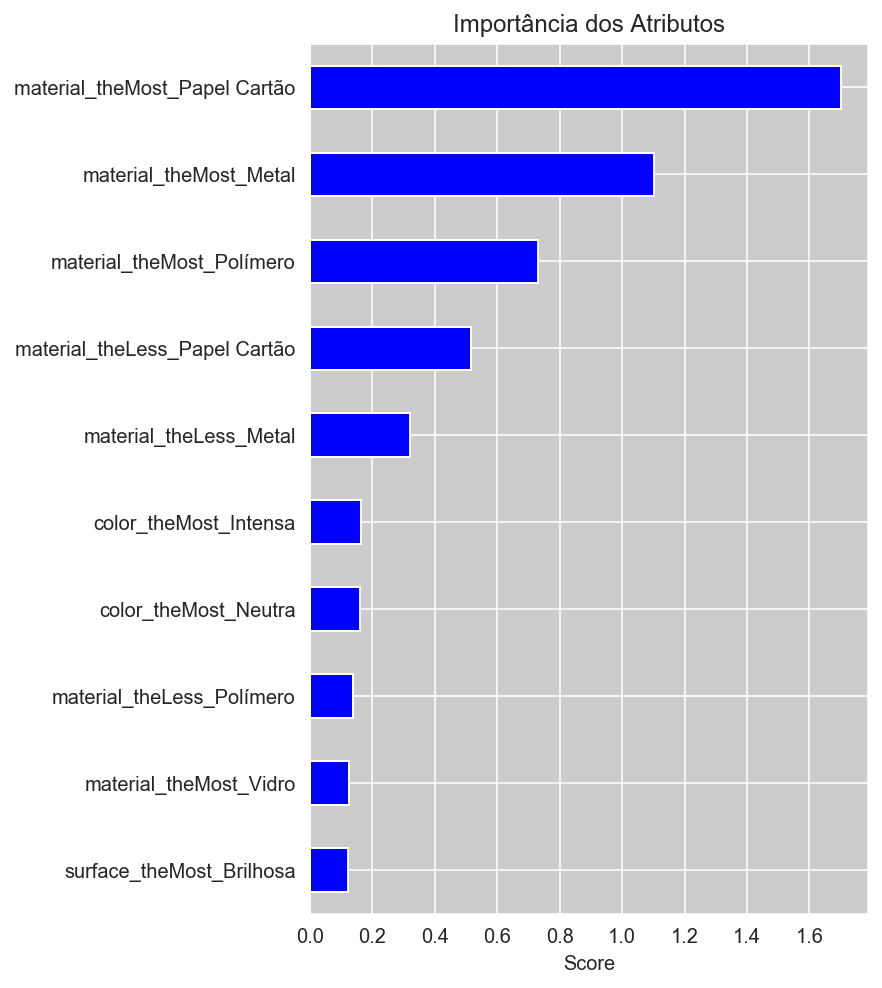

In [49]:
#Plot
plt.subplots(figsize=(5, 8))
feat_imp_comparisons.head(10).plot(kind='barh', title='Importância dos Atributos', color='blue')
plt.xlabel('Score')
plt.gca().invert_yaxis()

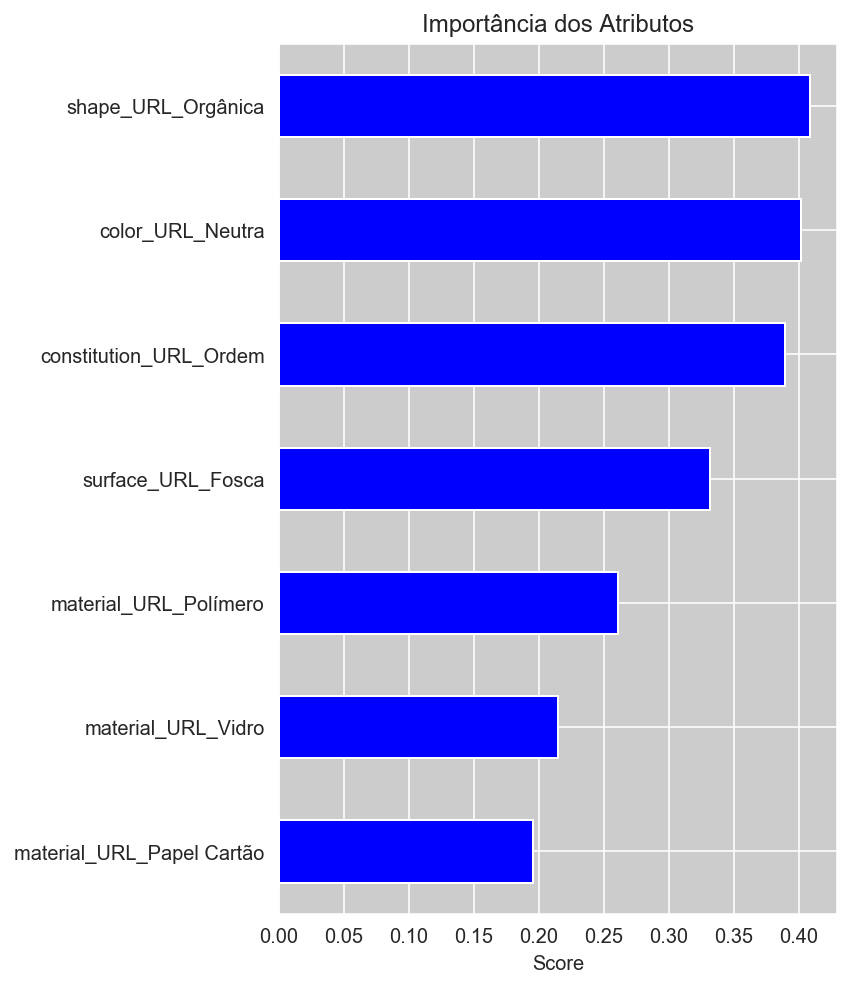

In [50]:
#Plot
plt.subplots(figsize=(5, 8))
feat_imp_scores.head(10).plot(kind='barh', title='Importância dos Atributos', color='blue')
plt.xlabel('Score')
plt.gca().invert_yaxis()

Verificamos que no modelo Logistic Regression os atributos mais importantes são os acima listado em ordem decrescente de importância.

#### Desempenho treino/teste

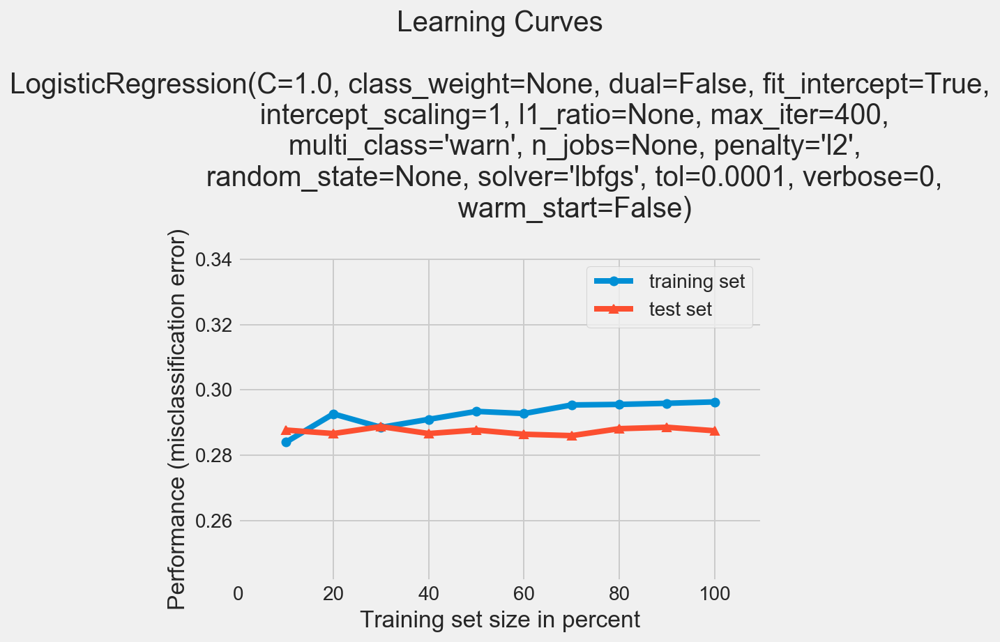

In [51]:
plot_learning_curves(X_comparisons_train_categories_train,y_train_comparisons_train, X_comparisons_train_categories_valid, y_train_comparisons_valid, logit_comparisons)
plt.show()


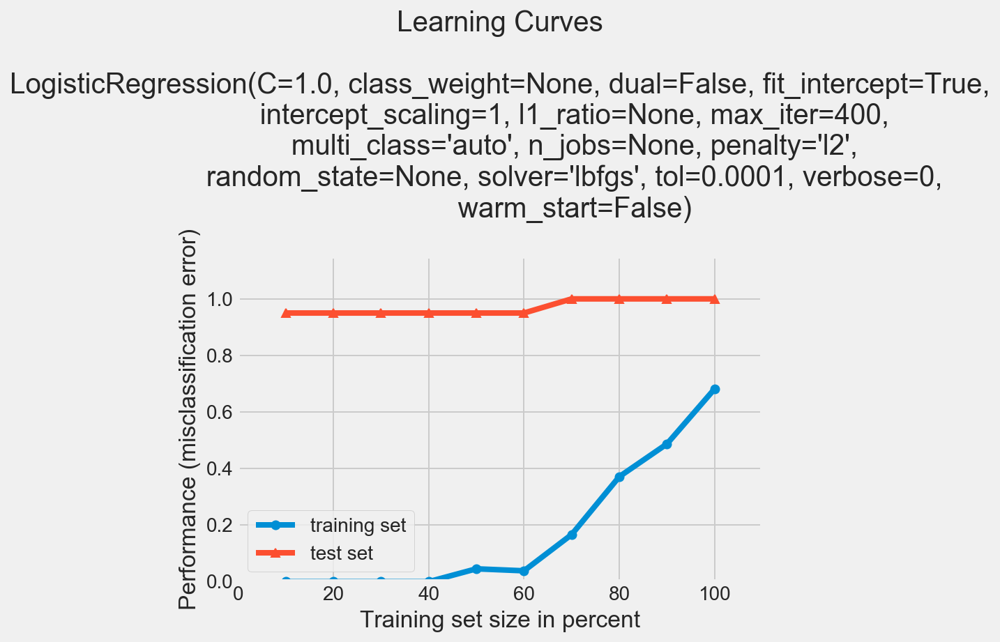

In [535]:
plot_learning_curves(X_scores_train,y_scores_train, X_scores_test, y_scores_test, logit_scores)
plt.show()

O modelo está seguindo o mesmo padrão tanto para os dados de teste como para os de validação, isso significa que não temos overfitting (o modelo parece ter generalizado bem). No entanto o erro é considerável para os dois conjuntos e as curvas se achatam muito rapidamente, nos parecendo que há underfitting.

### MODELO 03  - KNN

In [52]:
# Carregando a biblioteca para a criação do modelo
from sklearn.neighbors import KNeighborsClassifier

In [53]:
# Modelo com apenas um vizinho
knn_scores = KNeighborsClassifier(n_neighbors=1, algorithm = 'auto')
knn_comparisons = KNeighborsClassifier(n_neighbors=1, algorithm = 'auto')

In [54]:
# Fitando o modelo
knn_scores.fit(X_scores_train,y_scores_train)
knn_comparisons.fit(X_comparisons_train_categories_train,y_train_comparisons_train)



KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=1, p=2,
                     weights='uniform')

In [55]:
# Predição do modelo
knn_pred_scores = knn_scores.predict(X_scores_test)
knn_pred_comparisons = knn_comparisons.predict(X_comparisons_train_categories_valid)


In [56]:
# Avaliando o modelo
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_scores_test,knn_pred_scores),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_scores_test,knn_pred_scores,average='micro'),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_scores_test,knn_pred_scores,average='micro'),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_scores_test,knn_pred_scores,average='micro'),2)))
#print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_scores_test,knn_pred_scores,average='micro'),2)))

print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,knn_pred_comparisons),2)))

# Print do relatório de classificação
cr = classification_report(y_scores_test,knn_pred_scores)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

cr = classification_report(y_train_comparisons_valid,knn_pred_comparisons)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

Acurácia do modelo: 0.0
Precision: 0.0
F1 do modelo: 0.0
Recall do modelo: 0.0
Acurácia do modelo: 0.65
Precision: 0.65
F1 do modelo: 0.65
Recall do modelo: 0.64
AUC ROC: 0.65

Relatório de Classificação
              precision    recall  f1-score   support

        96.0       0.00      0.00      0.00       0.0
       103.0       0.00      0.00      0.00       1.0
       147.0       0.00      0.00      0.00       0.0
       163.0       0.00      0.00      0.00       1.0
       164.0       0.00      0.00      0.00       2.0
       167.0       0.00      0.00      0.00       0.0
       168.0       0.00      0.00      0.00       0.0
       173.0       0.00      0.00      0.00       0.0
       179.0       0.00      0.00      0.00       1.0
       184.0       0.00      0.00      0.00       0.0
       189.0       0.00      0.00      0.00       1.0
       192.0       0.00      0.00      0.00       1.0
       193.0       0.00      0.00      0.00       1.0
       200.0       0.00      0.00      

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\metrics\classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)



Matriz de confusão
[[1538  819]
 [ 833 1505]]


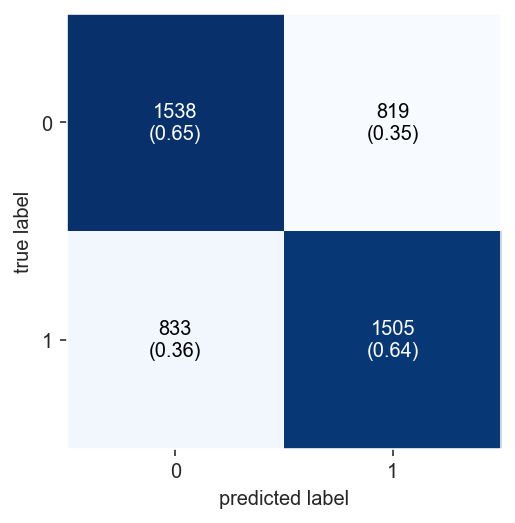

In [57]:


# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,knn_pred_comparisons)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm, show_normed=True)

plt.show()

In [330]:


# Predicão do dataset de validação
test_pred = knn_comparisons.predict(comparisons_tests_categories)
# Dataset para apresentação
previsao = comparisons_tests_categories.index
previsao.columns=['Id']
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()

eleito        696
nao_eleito    684
Name: Predicted, dtype: int64

In [331]:
# Predicão do dataset de validação
test_pred = knn.predict(X_tests_comparisons)
# Dataset para apresentação
previsao = teste.sequencial_candidato
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()

NameError: name 'X_tests_comparisons' is not defined

In [542]:
# Verificando qual o melhor número de vizinhos
error_rate = []

# Levará algum tempo
for i in range(1,50):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_comparisons_train_categories_train,y_train_comparisons_train)
    pred_i = knn.predict(X_comparisons_train_categories_valid)
    error_rate.append(np.mean(pred_i != y_train_comparisons_valid))

Text(0, 0.5, 'Error Rate')

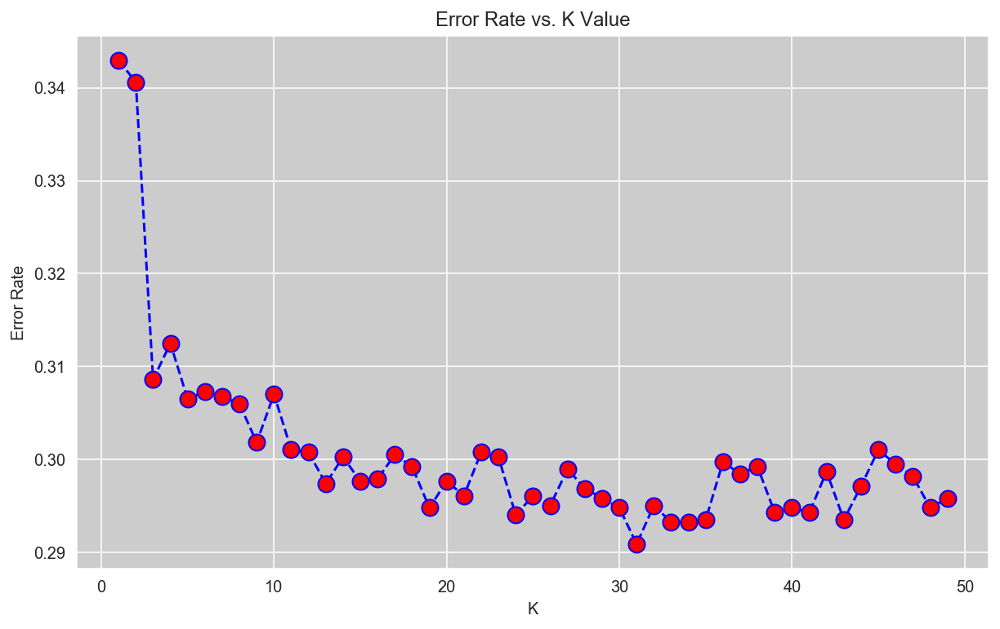

In [543]:
# Plotando a figura
plt.figure(figsize=(10,6))
plt.plot(range(1,50),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

In [544]:
# Verificando qual o melhor número de vizinhos
error_rate = []

# Levará algum tempo
for i in range(1,42):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_scores_train,y_scores_train)
    pred_i = knn.predict(X_scores_test)
    error_rate.append(np.mean(pred_i != y_scores_test))

In [58]:
# Agora com K=45
knn_comparisons = KNeighborsClassifier(n_neighbors=2)#escolha o melhor resultado do gráfico acima
# Fitando o modelo
knn_comparisons.fit(X_comparisons_train_categories_train,y_train_comparisons_train)
# Predições
knn_pred_comparisons = knn_comparisons.predict(X_comparisons_train_categories_valid)


Acurácia do modelo: 0.65
Precision: 0.72
F1 do modelo: 0.57
Recall do modelo: 0.47
AUC ROC: 0.65

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.61      0.82      0.70      2357
           1       0.72      0.47      0.57      2338

    accuracy                           0.65      4695
   macro avg       0.67      0.65      0.63      4695
weighted avg       0.67      0.65      0.63      4695


Matriz de confusão
[[1941  416]
 [1246 1092]]


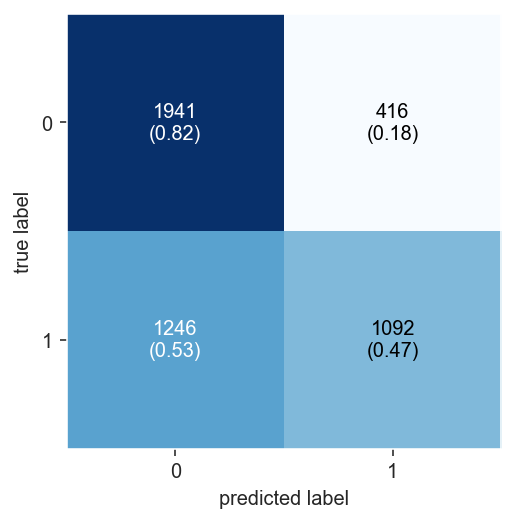

In [59]:
# Avaliando o modelo
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,knn_pred_comparisons),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,knn_pred_comparisons),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,knn_pred_comparisons)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,knn_pred_comparisons)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm, show_normed=True)

plt.show()

### MODELO 04 - Árvores Extras

In [61]:
# Biblioteca para o modelo
from sklearn.tree import DecisionTreeClassifier

In [62]:

# Criando o modelo
dtree_comparisons = DecisionTreeClassifier()
# Fitando o modelo
dtree_comparisons.fit(X_comparisons_train_categories_train,y_train_comparisons_train)
# Predição
dtree_pred_comparisons = dtree_comparisons.predict(X_comparisons_train_categories_valid)

In [63]:
# Criando o modelo
dtree_scores = DecisionTreeClassifier()
# Fitando o modelo
dtree_scores.fit(X_scores_train,y_scores_train)
# Predição
dtree_pred_scores = dtree_scores.predict(X_scores_test)

In [64]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,dtree_pred_comparisons),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,dtree_pred_comparisons),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,dtree_pred_comparisons),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,dtree_pred_comparisons),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,dtree_pred_comparisons),2)))

print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_scores_test,dtree_pred_scores),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_scores_test,dtree_pred_scores,average='micro'),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_scores_test,dtree_pred_scores,average='micro'),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_scores_test,dtree_pred_scores,average='micro'),2)))
#print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_scores_test,dtree_pred_scores,average='micro'),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,dtree_pred_comparisons)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

cr = classification_report(y_scores_test,dtree_pred_scores)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))


Acurácia do modelo: 0.69
Precision: 0.71
F1 do modelo: 0.68
Recall do modelo: 0.65
AUC ROC: 0.69
Acurácia do modelo: 0.0
Precision: 0.0
F1 do modelo: 0.0
Recall do modelo: 0.0

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.68      0.74      0.71      2357
           1       0.71      0.65      0.68      2338

    accuracy                           0.69      4695
   macro avg       0.70      0.69      0.69      4695
weighted avg       0.70      0.69      0.69      4695


Relatório de Classificação
              precision    recall  f1-score   support

       103.0       0.00      0.00      0.00       1.0
       140.0       0.00      0.00      0.00       0.0
       146.0       0.00      0.00      0.00       0.0
       162.0       0.00      0.00      0.00       0.0
       163.0       0.00      0.00      0.00       1.0
       164.0       0.00      0.00      0.00       2.0
       168.0       0.00      0.00      0.00       0.0
       1

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\metrics\classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)



Matriz de confusão
[[1737  620]
 [ 812 1526]]


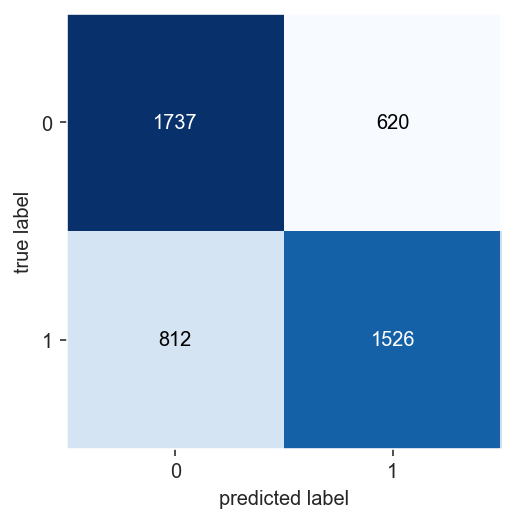

In [65]:

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,dtree_pred_comparisons)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

#### Desempenho treino/teste

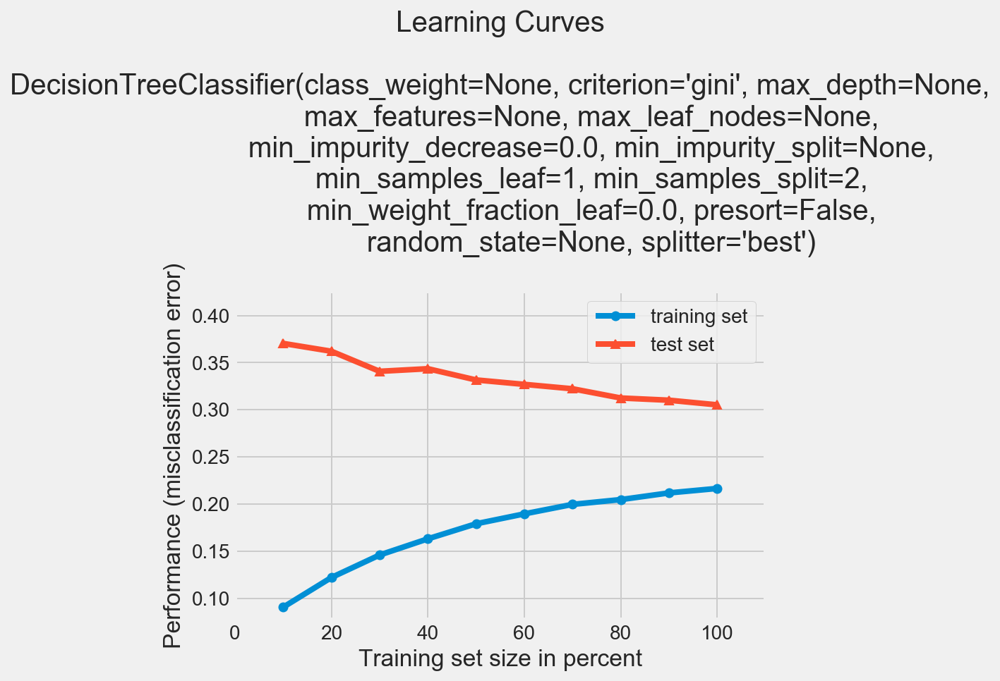

In [66]:

plot_learning_curves(X_comparisons_train_categories_train,y_train_comparisons_train, X_comparisons_train_categories_valid, y_train_comparisons_valid, dtree_comparisons)
plt.show()


Aqui vemos que o erro no conjunto de treinamento começa e permanece extremamente baixo, enquanto o erro no conjunto de teste é grande. Parece que o erro do conjunto de teste está diminuindo lentamente com mais dados. Isso é característico do overfitting, o modelo está capturando exatamente o comportamento dos dados de treinamento, e, portanto, não está conseguindo generalizar para novos pontos.

#### Predicão do dataset de validação

In [555]:

# Predicão do dataset de validação
test_pred = dtree_comparisons.predict(comparisons_tests_categories)
# Dataset para apresentação
previsao = comparisons_tests_categories.index
previsao.columns=['Id']
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()

# Predicão do dataset de validação
#test_pred = dtree.predict(X_tests_comparisons)
# Dataset para apresentação
#previsao = teste.sequencial_candidato
#previsao = pd.DataFrame(previsao)
#previsao['Predicted'] = test_pred
#previsao.columns=['Id', 'Predicted']
#previsao.reset_index()
#previsao.set_index(['Id', 'Predicted'])
#previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
# Contando a predição
#previsao.Predicted.value_counts()

nao_eleito    627
eleito        435
Name: Predicted, dtype: int64

### MODELO 05 - AdaBoostClassifier

In [67]:
# Biblioteca para o modelo
from sklearn.ensemble import AdaBoostClassifier

In [68]:

# Criando o modelo
ada_comparisons = AdaBoostClassifier(n_estimators=50,
                         learning_rate=1,
                         random_state=0)
# Fitando o modelo
ada_comparisons.fit(X_comparisons_train_categories_train,y_train_comparisons_train)
# Predição
ada_pred_comparisons = ada_comparisons.predict(X_comparisons_train_categories_valid)

Acurácia do modelo: 0.71
Precision: 0.73
F1 do modelo: 0.7
Recall do modelo: 0.67
AUC ROC: 0.71

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.70      0.76      0.73      2357
           1       0.73      0.67      0.70      2338

    accuracy                           0.71      4695
   macro avg       0.71      0.71      0.71      4695
weighted avg       0.71      0.71      0.71      4695


Matriz de confusão
[[1793  564]
 [ 783 1555]]


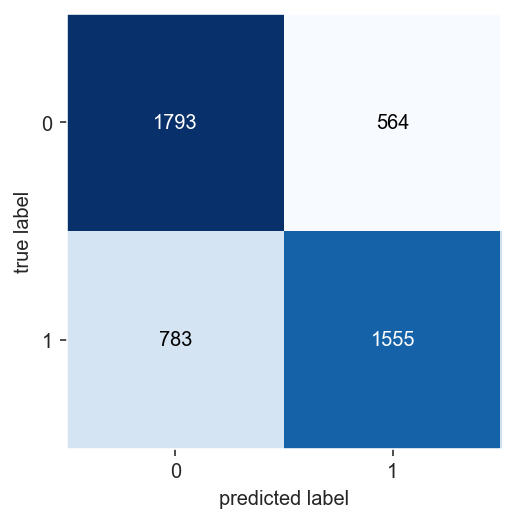

In [69]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,ada_pred_comparisons),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,ada_pred_comparisons),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,ada_pred_comparisons),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,ada_pred_comparisons),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,ada_pred_comparisons),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,ada_pred_comparisons)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,ada_pred_comparisons)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

#### Desempenho treino/teste

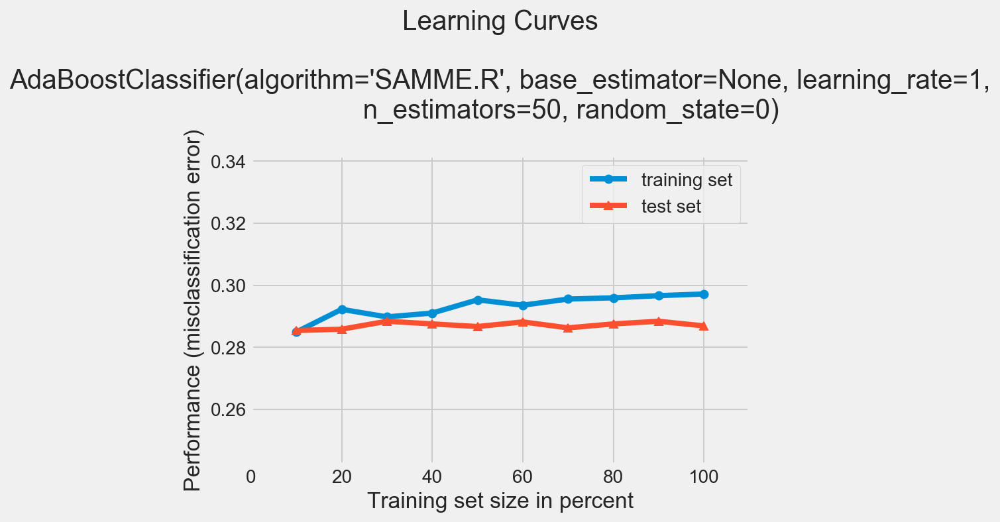

In [70]:

plot_learning_curves(X_comparisons_train_categories_train,y_train_comparisons_train, X_comparisons_train_categories_valid, y_train_comparisons_valid, ada_comparisons)
plt.show()

Após usar todos os dados de treinamento, o modelo está fazendo o mesmo no conjunto de teste e de treinamento - isso significa que não temos overfitting (o modelo generalizou bem). Por outro lado, em termos absolutos, o erro é alto para treinamento e teste. As curvas se achataram muito rapidamente e parece termos aqui underfitting.

#### Predicão do dataset de validação

In [560]:

# Predicão do dataset de validação
test_pred = ada_comparisons.predict(comparisons_tests_categories)
# Dataset para apresentação
previsao = comparisons_tests_categories.index
previsao.columns=['Id']
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()

# Predicão do dataset de validação
#test_pred = ada.predict(df_valid)
# Dataset para apresentação
#previsao = teste.sequencial_candidato
#previsao = pd.DataFrame(previsao)
#previsao['Predicted'] = test_pred
#previsao.columns=['Id', 'Predicted']
#previsao.reset_index()
#previsao.set_index(['Id', 'Predicted'])
#previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
# Contando a predição
#previsao.Predicted.value_counts()

nao_eleito    752
eleito        310
Name: Predicted, dtype: int64

### MODELO 06 - RandomForestClassifier

In [71]:
# Biblioteca para o modelo
from sklearn.ensemble import RandomForestClassifier

In [72]:

# Criando o modelo
rfc_comparisons = RandomForestClassifier(n_estimators=600)
# Fitando o modelo
rfc_comparisons.fit(X_comparisons_train_categories_train,y_train_comparisons_train)
# Predição
rfc_pred_comparisons = rfc_comparisons.predict(X_comparisons_train_categories_valid)

Acurácia do modelo: 0.7
Precision: 0.7
F1 do modelo: 0.7
Recall do modelo: 0.7
AUC ROC: 0.7

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.70      0.71      0.71      2357
           1       0.70      0.70      0.70      2338

    accuracy                           0.70      4695
   macro avg       0.70      0.70      0.70      4695
weighted avg       0.70      0.70      0.70      4695


Matriz de confusão
[[1664  693]
 [ 699 1639]]


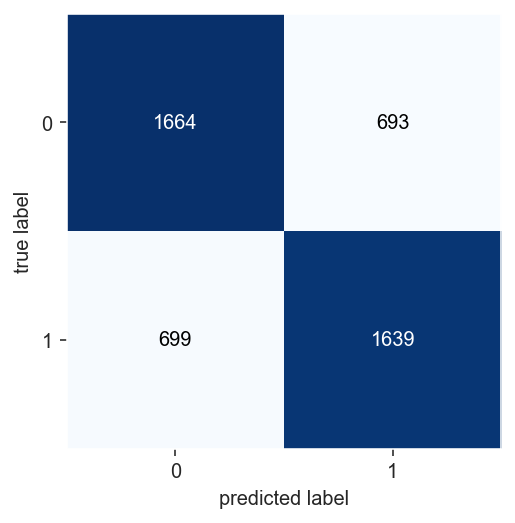

In [73]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,rfc_pred_comparisons),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,rfc_pred_comparisons),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,rfc_pred_comparisons),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,rfc_pred_comparisons),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,rfc_pred_comparisons),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,rfc_pred_comparisons)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,rfc_pred_comparisons)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

Aqui vemos que o erro no conjunto de treinamento começa e permanece extremamente baixo, enquanto o erro no conjunto de teste é grande. Parece que o erro do conjunto de teste está diminuindo lentamente com mais dados. Isso é característico do overfitting, o modelo está capturando exatamente o comportamento dos dados de treinamento, mas, portanto, não está conseguindo generalizar para novos pontos.

#### Predicão do dataset de validação

In [356]:

# Predicão do dataset de validação
test_pred = rfc_comparisons.predict(comparisons_tests_categories)
# Dataset para apresentação
previsao = comparisons_tests_categories.index
previsao.columns=['Id']
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()

# Predicão do dataset de validação
#test_pred = rfc.predict(df_valid)
# Dataset para apresentação
#previsao = teste.sequencial_candidato
#previsao = pd.DataFrame(previsao)
#previsao['Predicted'] = test_pred
#previsao.columns=['Id', 'Predicted']
#previsao.reset_index()
#previsao.set_index(['Id', 'Predicted'])
#previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
# Contando a predição
#previsao.Predicted.value_counts()

eleito        727
nao_eleito    653
Name: Predicted, dtype: int64

### MODELO 07 - SVM

#### Normalizando os dados com QuantileTransformer

Esse método transforma os recursos para seguir uma distribuição uniforme ou normal. Portanto, para um determinado recurso, essa transformação tende a distribuir os valores mais frequentes. Também reduz o impacto de outliers (marginais): este é, portanto, um esquema robusto de pré-processamento.

In [106]:
X_train_comparisons_Xqt = pd.get_dummies(comparisons_train_cleaned[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess', 'shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)

In [107]:
from sklearn.preprocessing import QuantileTransformer
# Dimensionando
scaler = QuantileTransformer()
Xqt = X_train_comparisons_Xqt#X_comparisons
Xqt = scaler.fit_transform(Xqt)

#X_comparisons_train_categories_valid
#X_comparisons_train_categories_train
#comparisons_tests_categories


#X_train_comparisons_train, X_train_comparisons_valid, y_train_comparisons_train, y_train_comparisons_valid = train_test_split(comparisons_train_cleaned.drop(['result'], axis=1,inplace=False), np.where(comparisons_train_cleaned['result']==True, 1,0), test_size=0.30,random_state=101)

#### Dividindo os dados em um conjunto de treinamento e conjunto de testes.

In [108]:
# Dividindo os dados em um conjunto de treinamento e conjunto de testes.
from sklearn.model_selection import train_test_split

#X_train_comparisons_train, X_train_comparisons_valid, y_train_comparisons_train, y_train_comparisons_valid = train_test_split(Xqt, y_train_comparisons, test_size=0.30,random_state=101)
X_train_comparisons_train_Xqt, X_train_comparisons_valid_Xqt, y_train_comparisons_train_Xqt, y_train_comparisons_valid_Xqt = train_test_split(Xqt, np.where(comparisons_train_cleaned['result']==True, 1,0), test_size=0.30,random_state=101)

#X_comparisons_train, X_comparisons_test, y_comparisons_train, y_comparisons_test = train_test_split(Xqt,y_comparisons,test_size=0.30)

In [109]:
# Dividindo os dados em um conjunto de treinamento e conjunto de testes.
from sklearn.model_selection import train_test_split
#X_comparisons_train, X_comparisons_test, y_comparisons_train, y_comparisons_test = train_test_split(X_comparisons,y_comparisons,test_size=0.30)

In [110]:
# Biblioteca para o modelo
from sklearn.svm import SVC

In [111]:

# Criando o modelo
svm = SVC(gamma='scale')
# Fitando o modelo
svm.fit(X_train_comparisons_train_Xqt,y_train_comparisons_train_Xqt)
# Predição
svm_pred = svm.predict(X_train_comparisons_valid_Xqt)

Acurácia do modelo: 0.72
Precision: 0.75
F1 do modelo: 0.71
Recall do modelo: 0.68
AUC ROC: 0.72

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.70      0.77      0.73      1896
           1       0.75      0.68      0.71      1944

    accuracy                           0.72      3840
   macro avg       0.73      0.72      0.72      3840
weighted avg       0.73      0.72      0.72      3840


Matriz de confusão
[[1460  436]
 [ 626 1318]]


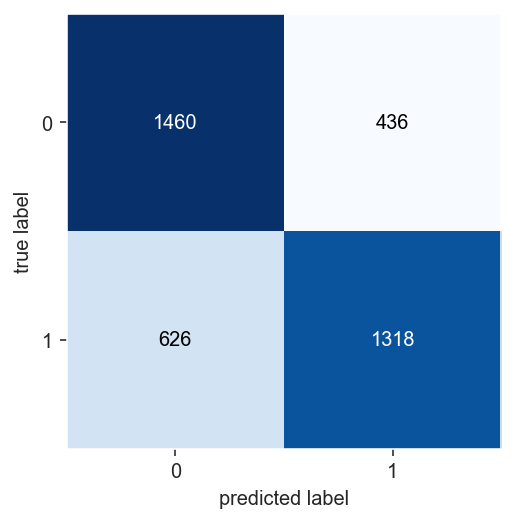

In [112]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid_Xqt,svm_pred),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid_Xqt,svm_pred),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid_Xqt,svm_pred),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid_Xqt,svm_pred),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid_Xqt,svm_pred),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid_Xqt,svm_pred)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid_Xqt,svm_pred)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

#### Desempenho treino/teste

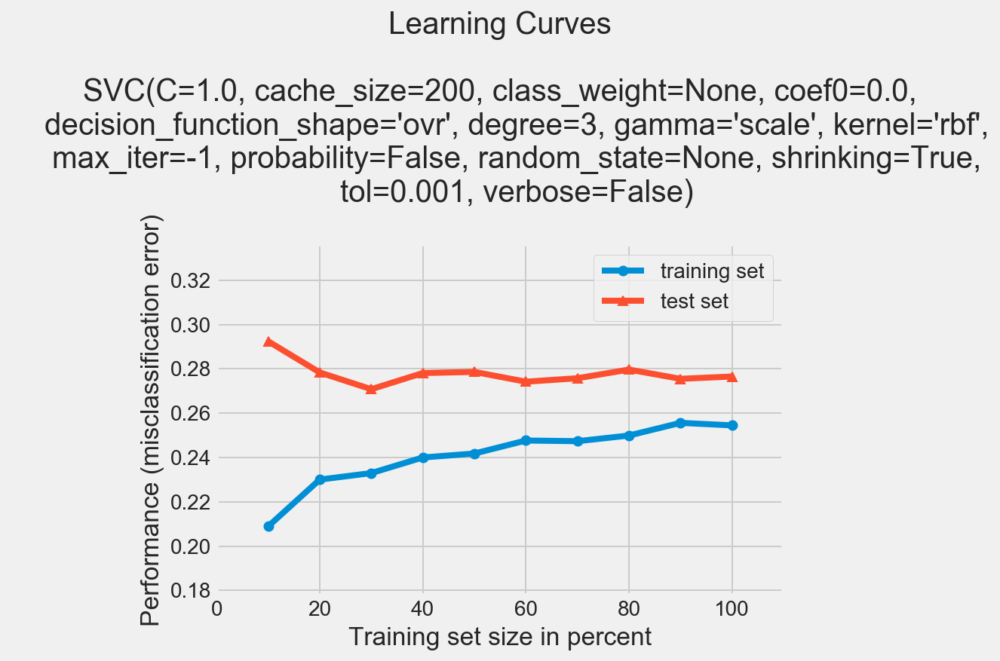

In [113]:

plot_learning_curves(X_train_comparisons_train_Xqt,y_train_comparisons_train_Xqt, X_train_comparisons_valid_Xqt, y_train_comparisons_valid_Xqt, svm)
plt.show()

O modelo apresenta um comportamento parecido para os dados de treinamento e teste. Seria necessário mais dados de treinamento.

#### Encontrando parâmetro para otimizar o modelo com Gridsearch

O GridSearchCV usa um dicionário que descreve os parâmetros que devem ser testados e um modelo para treinar. A grade de parâmetros é definida como um dicionário, onde as chaves são os parâmetros e os valores são as configurações a serem testadas.

In [114]:
param_grid = {'C': [0.01, 0.1, 1, 10, 100, 500], 'gamma': [1,0.1,0.01,0.001,0.0001], 'kernel': ['rbf']} 

In [115]:
from sklearn.model_selection import GridSearchCV

In [575]:

grid = GridSearchCV(SVC(),param_grid,refit=True,verbose=0)
grid.fit(X_train_comparisons_train_Xqt,y_train_comparisons_train_Xqt)

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


GridSearchCV(cv='warn', error_score='raise-deprecating',
             estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='auto_deprecated', kernel='rbf', max_iter=-1,
                           probability=False, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='warn', n_jobs=None,
             param_grid={'C': [0.01, 0.1, 1, 10, 100, 500],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [576]:
grid.best_params_

{'C': 10, 'gamma': 0.1, 'kernel': 'rbf'}

In [577]:
grid.best_estimator_

SVC(C=10, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=0.1, kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

Re-executando as previsões neste objeto da grade

In [578]:
grid_pred = grid.predict(X_train_comparisons_valid_Xqt)

In [116]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid_Xqt,grid_pred),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid_Xqt,grid_pred),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid_Xqt,grid_pred),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid_Xqt,grid_pred),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid_Xqt,grid_pred),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid_Xqt,grid_pred)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid_Xqt,grid_pred)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

NameError: name 'grid_pred' is not defined

In [580]:
# Predicão do dataset de validação
test_pred = grid.predict(comparisons_tests_categories)
# Dataset para apresentação
previsao = comparisons_tests_categories.index
previsao.columns=['Id']
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()


# Predicão do dataset de validação
#test_pred = grid.predict(XrbT)
# Dataset para apresentação
#previsao = teste.sequencial_candidato
#previsao = pd.DataFrame(previsao)
#previsao['Predicted'] = test_pred
#previsao.columns=['Id', 'Predicted']
#previsao.reset_index()
#previsao.set_index(['Id', 'Predicted'])
#previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
# Contando a predição
#previsao.Predicted.value_counts()

nao_eleito    605
eleito        457
Name: Predicted, dtype: int64

### MODELO 08 - GradientBoosting

In [117]:
from sklearn.model_selection import train_test_split
X_train_comparisons_train, X_train_comparisons_valid, y_train_comparisons_train, y_train_comparisons_valid = train_test_split(X_train_comparisons, y_train_comparisons, test_size=0.30, random_state=101)

NameError: name 'X_train_comparisons' is not defined

In [84]:
from sklearn.ensemble import GradientBoostingClassifier

In [85]:
gb = GradientBoostingClassifier(learning_rate=0.05, n_estimators=100,max_depth=9, min_samples_split=6, 
                                min_samples_leaf=20, subsample=.7,max_features=17, random_state=seed)

In [169]:
#gb = GradientBoostingClassifier(learning_rate=0.05, n_estimators=100,max_depth=9, min_samples_split=6, 
#                                min_samples_leaf=20, subsample=.7,max_features=14, random_state=seed)GridSearchCV(cv='warn', error_score='raise-deprecating',
             
gb = GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.01, loss='deviance', max_depth=4,
                           max_features=6, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=6,
                           min_weight_fraction_leaf=0.0, n_estimators=50,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.75, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)





In [170]:
gb.fit(X_comparisons_train_categories_train,y_train_comparisons_train)

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.01, loss='deviance', max_depth=4,
                           max_features=6, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=6,
                           min_weight_fraction_leaf=0.0, n_estimators=50,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=0.75, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [171]:
gb_pred = gb.predict(X_comparisons_train_categories_valid)

Acurácia do modelo: 0.71
Precision: 0.8
F1 do modelo: 0.66
Recall do modelo: 0.57
AUC ROC: 0.71

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.66      0.85      0.74      1896
           1       0.80      0.57      0.66      1944

    accuracy                           0.71      3840
   macro avg       0.73      0.71      0.70      3840
weighted avg       0.73      0.71      0.70      3840


Matriz de confusão
[[1619  277]
 [ 840 1104]]


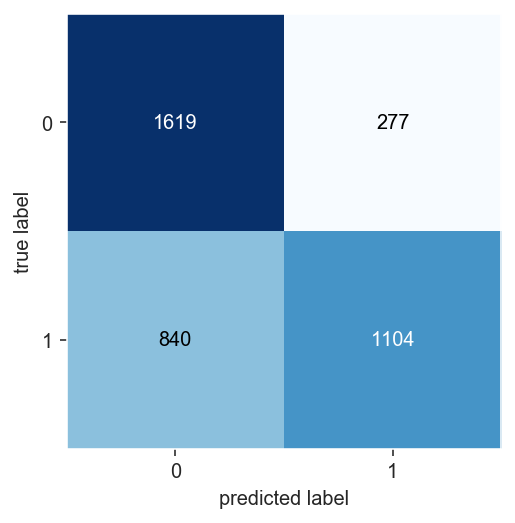

In [172]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,gb_pred),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,gb_pred),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,gb_pred)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,gb_pred)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

#### Desempenho treino/teste

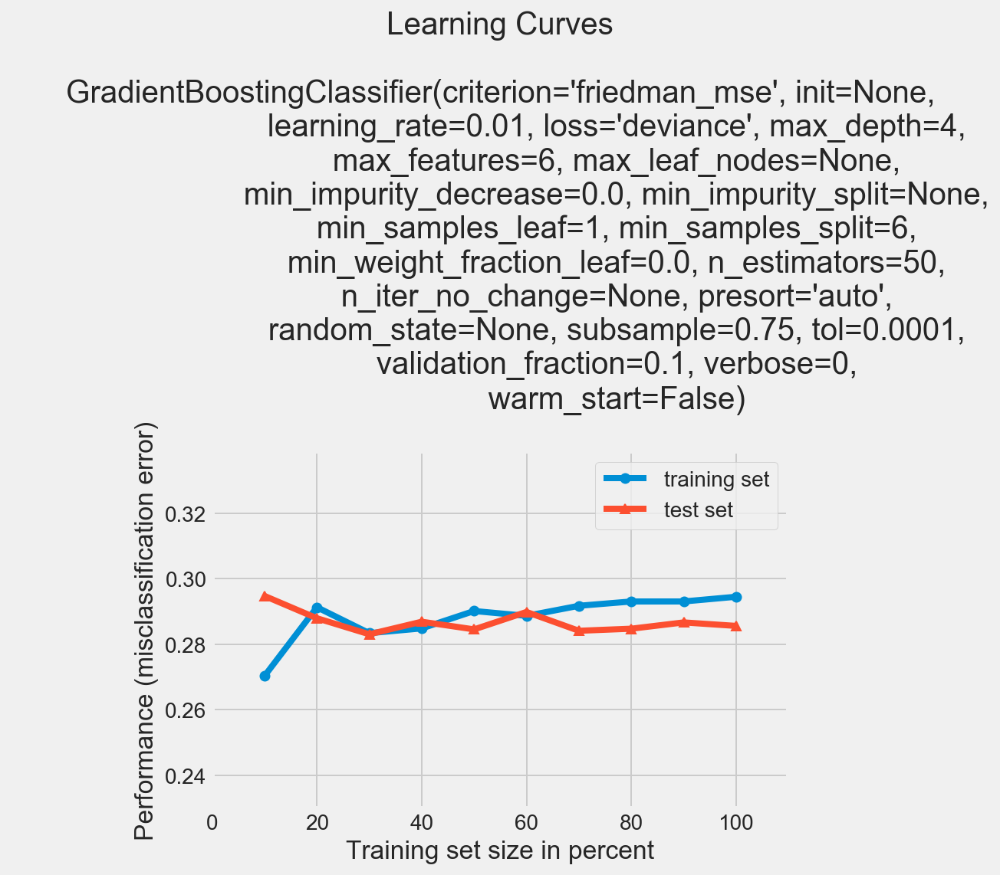

In [90]:
plot_learning_curves(X_comparisons_train_categories_train,y_train_comparisons_train, X_comparisons_train_categories_valid, y_train_comparisons_valid, gb)
plt.show()


Uma curva de aprendizado mostra como o erro muda conforme o tamanho do conjunto de treinamento aumenta. 
Percebemos que a curva de erro vai diminuíndo conforme o tamanho do conjunto de treinamento aumenta.
As curvas não convergiram pois, provavelmente, precisa-se de mais instâncias de treino.
Vemos que que temos um *baixo vies*, pois temos baixo erro no treinamento e uma alta variância devido ao intervalo longo entre as duas curvas.

#### Importância dos atributos

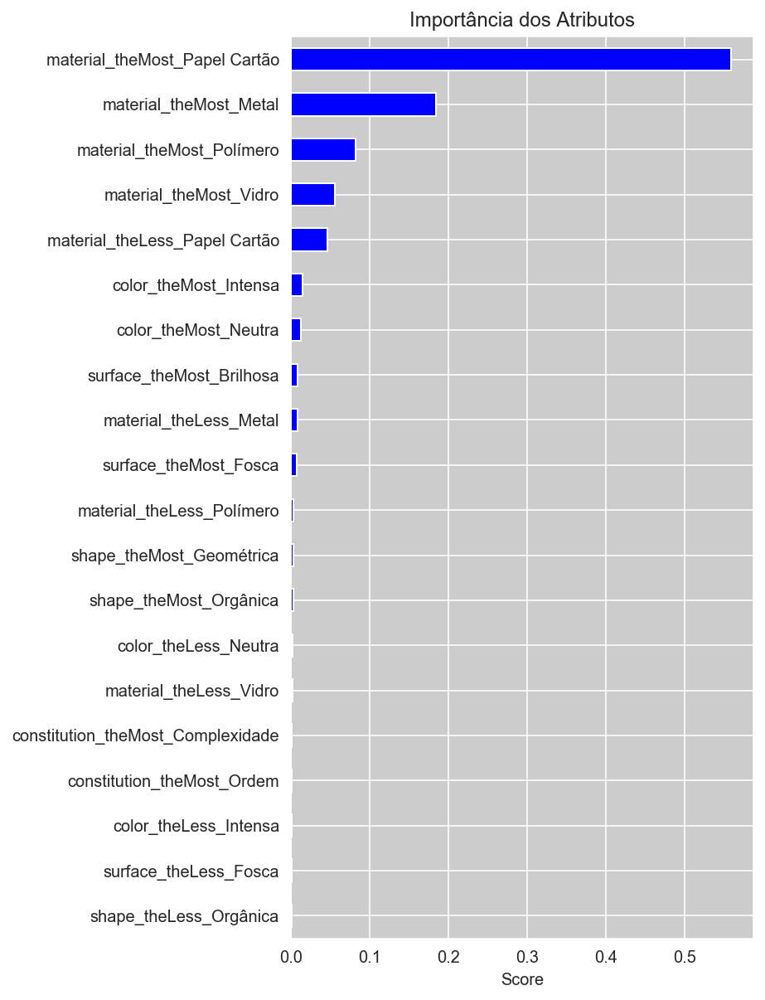

In [589]:
preditores=list(X_comparisons_train_categories_train)
feat_imp = pd.Series(gb.feature_importances_, preditores).sort_values(ascending=False)
# plot
plt.subplots(figsize=(5, 10))                       
feat_imp.head(20).plot(kind='barh', title='Importância dos Atributos', color='blue')
plt.xlabel('Score')
plt.gca().invert_yaxis()


In [590]:
# Predicão do dataset de validação
test_pred = gb.predict(comparisons_tests_categories)
# Dataset para apresentação
previsao = comparisons_tests_categories.index
previsao.columns=['Id']
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()

# Predicão do dataset de validação
#test_pred = gb.predict(df_valid)
# Dataset para apresentação
#previsao = teste.sequencial_candidato
#previsao = pd.DataFrame(previsao)
#previsao['Predicted'] = test_pred
#previsao.columns=['Id', 'Predicted']
#previsao.reset_index()
#previsao.set_index(['Id', 'Predicted'])
#previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
# Contando a predição
#previsao.Predicted.value_counts()

nao_eleito    861
eleito        201
Name: Predicted, dtype: int64

### MODELO 09 - Ensemble  BaggingClassifier

In [143]:
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn import model_selection

In [144]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_comparisons, y_comparisons, test_size=0.30, random_state=seed)

NameError: name 'X_comparisons' is not defined

In [605]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)


gb = GradientBoostingClassifier(learning_rate=0.01, n_estimators=50,max_depth=2, min_samples_split=100, 
                                      min_samples_leaf=1, subsample=0.75,max_features=2, random_state=10)
#gb = GradientBoostingClassifier(learning_rate=0.01, n_estimators=500,max_depth=2, min_samples_split=20, 
#                                      min_samples_leaf=7, subsample=0.9,max_features=7, random_state=10)

num_trees = 100

ens = BaggingClassifier(base_estimator=gb, n_estimators=num_trees, random_state=seed)

In [606]:
# Fitando o modelo
ens.fit(X_comparisons_train_categories_train, y_train_comparisons_train)


BaggingClassifier(base_estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                            init=None,
                                                            learning_rate=0.01,
                                                            loss='deviance',
                                                            max_depth=2,
                                                            max_features=2,
                                                            max_leaf_nodes=None,
                                                            min_impurity_decrease=0.0,
                                                            min_impurity_split=None,
                                                            min_samples_leaf=1,
                                                            min_samples_split=100,
                                                            min_weight_fraction_leaf=0.0,
                               

In [609]:
# Predições
ens_pred = ens.predict(X_comparisons_train_categories_valid)

Acurácia do modelo: 0.71
Precision: 0.78
F1 do modelo: 0.67
Recall do modelo: 0.58
AUC ROC: 0.71

Relatório de Classificação
              precision    recall  f1-score   support

           0       0.66      0.83      0.74      1896
           1       0.78      0.58      0.67      1944

    accuracy                           0.71      3840
   macro avg       0.72      0.71      0.70      3840
weighted avg       0.72      0.71      0.70      3840


Matriz de confusão
[[1583  313]
 [ 810 1134]]


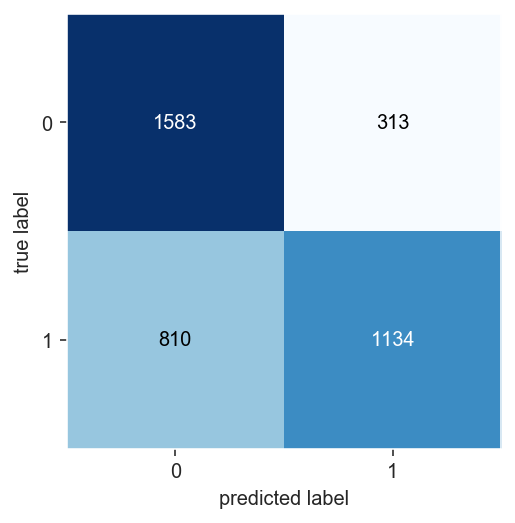

In [610]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(y_train_comparisons_valid,ens_pred),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(y_train_comparisons_valid,ens_pred),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(y_train_comparisons_valid,ens_pred),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(y_train_comparisons_valid,ens_pred),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(y_train_comparisons_valid,ens_pred),2)))

# Print do relatório de classificação
cr = classification_report(y_train_comparisons_valid,ens_pred)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(y_train_comparisons_valid,ens_pred)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

#### Desempenho treino/teste

In [127]:
plot_learning_curves(X_comparisons_train_categories_train,y_train_comparisons_train, X_comparisons_train_categories_valid, y_train_comparisons_valid, ens)
plt.show()

C:\Users\tclem\Anaconda3\lib\site-packages\sklearn\ensemble\_gb_losses.py:608: RuntimeWarning: divide by zero encountered in double_scalars
  return (-2 / sample_weight.sum() * np.sum(
C:\Users\tclem\Anaconda3\lib\site-packages\sklearn\ensemble\_gb_losses.py:610: RuntimeWarning: invalid value encountered in double_scalars
  np.logaddexp(0, raw_predictions))))
C:\Users\tclem\Anaconda3\lib\site-packages\sklearn\ensemble\_gb_losses.py:608: RuntimeWarning: divide by zero encountered in double_scalars
  return (-2 / sample_weight.sum() * np.sum(
C:\Users\tclem\Anaconda3\lib\site-packages\sklearn\ensemble\_gb_losses.py:610: RuntimeWarning: invalid value encountered in double_scalars
  np.logaddexp(0, raw_predictions))))
C:\Users\tclem\Anaconda3\lib\site-packages\sklearn\ensemble\_gb_losses.py:608: RuntimeWarning: divide by zero encountered in double_scalars
  return (-2 / sample_weight.sum() * np.sum(
C:\Users\tclem\Anaconda3\lib\site-packages\sklearn\ensemble\_gb_losses.py:610: RuntimeWarni

ValueError: y contains 1 class after sample_weight trimmed classes with zero weights, while a minimum of 2 classes are required.

O  modelo parece ter generalizado bem, mas com o aumento do tamanho do conjunto de treinamento vemos que o erro, mesmo sendo baixo, vai crescendo.

#### Predicão do dataset de validação

In [128]:
# Predicão do dataset de validação
test_pred = ens.predict(comparisons_tests_categories)
# Dataset para apresentação
previsao = comparisons_tests_categories.index
previsao.columns=['Id']
previsao = pd.DataFrame(previsao)
previsao['Predicted'] = test_pred
previsao.columns=['Id', 'Predicted']
previsao.reset_index()
previsao.set_index(['Id', 'Predicted'])
previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
#previsao.head(10)
# Contando a predição
previsao.Predicted.value_counts()

# Predicão do dataset de validação
#test_pred = ens.predict(df_valid)
# Dataset para apresentação
#previsao = teste.sequencial_candidato
#previsao = pd.DataFrame(previsao)
#previsao['Predicted'] = test_pred
#previsao.columns=['Id', 'Predicted']
#previsao.reset_index()
#previsao.set_index(['Id', 'Predicted'])
#previsao['Predicted'] = np.where(previsao['Predicted']==1, 'eleito','nao_eleito')
# Salvando dataset
#previsao.to_csv('predicoes/predicted_ens_tunning.csv', index=False)
# Contando a predição
#previsao.Predicted.value_counts()

nao_eleito    36
Name: Predicted, dtype: int64

#### OBSERVAÇÕES

Os parâmetros utilizados no GradientBoostingClassifier foram obtidos entre as melhores combinações feitas através do GridSearch que foi interrompido devido ao tempo que levaria para finalizar.
Entres as combinações a com melhor score foi:

[CV]  learning_rate=0.01, max_depth=2, max_features=7, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.9, score=0.9251968503937008, total=   0.7s

##### Parâmetros utilizados no GridSearch
    param_grid = {'learning_rate':[0.01,0.05,0.1], 'n_estimators':[50,100,250,500],
              'max_depth':[2,3,4,5,7,9], 'min_samples_split':[2,4,6,8,10,20,40,60,100], 
              'min_samples_leaf':[1,3,5,7,9],'subsample':[0.7,0.75,0.8,0.85,0.9,0.95,1],
             'max_features':[2,3,4,5,6,7]} 
             
             
###### GridSearch

    from sklearn.model_selection import GridSearchCV
    grid = GridSearchCV(GradientBoostingClassifier(),param_grid,refit=True,verbose=3)
    grid.fit(X_train,y_train)

In [388]:
param_grid = {'learning_rate':[0.01,0.05,0.1], 'n_estimators':[50,100,250,500],
              'max_depth':[2,3,4,5,7,9], 'min_samples_split':[2,4,6,8,10,20,40,60,100], 
              'min_samples_leaf':[1,3,5,7,9],'subsample':[0.7,0.75,0.8,0.85,0.9,0.95,1],
              'max_features':[2,3,4,5,6,7]} 

In [389]:
from sklearn.model_selection import GridSearchCV


grid = GridSearchCV(GradientBoostingClassifier(),param_grid,refit=True,verbose=3)
grid.fit(X_comparisons_train_categories_train,y_train_comparisons_train)

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 3 folds for each of 136080 candidates, totalling 408240 fits
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.7, score=0.704, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.7 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s


[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.7, score=0.687, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.7, score=0.691, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.75, score=0.697, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.75, score=0.704, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.85, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.85, score=0.697, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.9, score=0.705, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.9, score=0.705, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=1, score=0.708, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=1, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=1, score=0.696, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.7, score=0.705, total=   1.0s
[C

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.75, score=0.684, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.8, score=0.706, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.8, score=0.698, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.8, score=0.682, total=   0.1

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.9, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.95, score=0.712, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.95, score=0.701, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.95, score=0.692, 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.7, score=0.705, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.7, score=0.698, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.75, score=0.704, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.75, score=0.703, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.85, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.85, score=0.695, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.9, score=0.705, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.9, score=0.710, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=1, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=1, score=0.690, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.704, total=   0.6

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.8, score=0.707, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.8, score=0.705, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.8, score=0.699, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.705, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.9, score=0.689, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.694, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.692, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.7, score=0.701, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.7, score=0.693, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.708, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.85, score=0.705, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.85, score=0.706, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.85, score=0.698, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.95, score=0.687, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=1, score=0.701, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=1, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=1, score=0.684, total=   0.2s
[CV

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.75, score=0.701, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.75, score=0.689, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.705, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.9, score=0.705, total=   2.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.9, score=0.703, total=   1.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.9, score=0.695, total=   2.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.7, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.7, score=0.701, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.7, score=0.688, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.8, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.85, score=0.709, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.85, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.85, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.95, score=0.703, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.95, score=0.697, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=1, score=0.707, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=1, score=0.706, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.75, score=0.697, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.75, score=0.710, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.75, score=0.694, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.85, score=0.693, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.698

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=1, score=0.700, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=1, score=0.698, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.704, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.692, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.8, score=0.709, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.8, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.8, score=0.696, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.9, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.95, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.95, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.7, score=0.695, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.7, score=0.690, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.715, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.85, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.85, score=0.694, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.9, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.9, sc

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=1, score=0.705, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=1, score=0.705, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=1, score=0.696, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.706, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.75, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.8, score=0.705, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.8, score=0.708, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.8, score=0.692, total=   0.1

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.9, score=0.686, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.702, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.689, 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.7, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.7, score=0.698, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.709, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.706, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.85, score=0.701, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.85, score=0.707, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.85, score=0.697, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.701, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=1, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=1, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=1, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.706, total=   0.5s
[C

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.75, score=0.696, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.704, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.701, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.693, total

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.9, score=0.698, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.705, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.694, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.690, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.708, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.703, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.706, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.696, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.707, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.688, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1, score=0.707, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1, score=0.696, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1, score=0.697, total=   0.1s
[CV] learn

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.709, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.706, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.700, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.697, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.708, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.688, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.69

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.698, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.705, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.691, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1, score=0.708, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.700, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.85, score=0.690, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.697, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.690

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=1, score=0.704, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=1, score=0.697, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.701, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.696, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.710, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.691, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.691, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.704, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.690, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.702, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.705, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.688, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.9, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.95, score=0.689, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1, score=0.707, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1, score=0.705, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1, score=0.695, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.698, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.704, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.695, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.686

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.9, score=0.695, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.9, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95, s

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.708, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.699, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.75, sco

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.688, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.683, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.701, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1, score=0.708, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1, score=0.705, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1, score=0.695, total=   0.1s
[CV

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.696, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.708, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.705, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.704, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.688, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.699, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.699, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.686, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.706, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.694, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.704, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.700, 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.692, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.694, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=1, score=0.704, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=1, score=0.703, total=   0.1s
[CV]

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.707, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.697, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.706, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.704, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.696, total

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.705, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.690, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.702, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.694, 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.703, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.695, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=1, score=0.709, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=1, score=0.707, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.709, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.697, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.687, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.693

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=1, score=0.706, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=1, score=0.695, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.696, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.699, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.701, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.690, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.95, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.95, score=0.701, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.695, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.692, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.705, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.697, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.696, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.6

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=1, score=0.706, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=1, score=0.698, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=1, score=0.692, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.705, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.701, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.708, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.686, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.691, total

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.9, score=0.690, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.696, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.695, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.703, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.695, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.706, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=1, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=1, score=0.696, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.708, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.704

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.704, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.695, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.85, sco

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.691, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.705, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.707, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.699, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.704, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.701, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.707, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.704, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.697, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.705, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.695, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1, score=0.703, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1, score=0.706, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1, score=0.699, total=   0.1s
[CV] learn

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.710, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.703, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.707, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.698, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.706, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.702, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.709, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.691, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.692, 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.707, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.695, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1, score=0.707, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1, score=0.703, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.698, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.697, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.691, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.703, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=1, score=0.696, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.712, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.695, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.691, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.701, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=1, score=0.713

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.699, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.697, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.694, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.703, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.700, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=1, score=0.696, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.694, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.699, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.689, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.705, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.695, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.710, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=1, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=1, score=0.698, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.698, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.679, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.709, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.707, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.690, total

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=1, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.708, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.687, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.695, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.705, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.707, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.690, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1, score=0.695

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75,

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.698, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.708, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9, sc

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=1, score=0.684, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.700, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.695, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.706, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.708, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.704, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.696, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=1, score=0.705, total

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.697, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.700, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.688, 

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.693, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.700, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1, score=0.706, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1, score=0.704, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1, score=0.696, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.703, total=   0.1s
[CV]

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.688, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.702, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.695, total

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.708, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.698, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.708, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.686, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.703, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.689, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.696, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.700, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1, score=0.709, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1, score=0.702, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1, score=0.694, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.708, total=   1.0s
[C

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.701, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.704, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.708, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.690, total

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.699, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.706, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.703, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.698, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.702, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.9, score=0.704, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.689, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=1, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=1, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=1, score=0.693, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.700, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.709, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.696, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.95, score=0.699, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.95, score=0.705, to

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=0.75, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.696, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.708, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.704, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.85, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.697, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.696, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=1, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=1, score=0.698, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.701, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.699, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.706, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.704, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.694

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=1, score=0.697, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=1, score=0.692, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=0.7, score=0.705, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=0.7, score=0.705, t

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.691, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.85, sco

[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.694, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.95, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.95, score=0.706, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=2, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.95,

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.690, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.75, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.75, score=0.704, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.709, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.698, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.9, score=0.708, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.699, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=1, score=0.705, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=1, score=0.706, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=1, score=0.701, total=   0.8s
[CV

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.693, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.95, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.95, score=0.702, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.698, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.75, score=0.708, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=0.75, score=0.686, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.712, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.696, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.9, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=1, score=0.708, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=1, score=0.703, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=1, score=0.697, total=   0.4s
[CV

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.693, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.8, score=0.712, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.8, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.8, score=0.685, total=   0.1

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.700, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.694, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.95, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.95, score=0.699, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.706, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.704, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.700, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.75, score=0.706, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.687, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.85, score=0.711, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.85, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.85, score=0.695, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.697, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=1, score=0.708, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=1, score=0.701, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.706, total=   1.8s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.704, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.697, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.695, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.9, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.9, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.9, score=0.699, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=1, score=0.699, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=1, score=0.687, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.7, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.7, score=0.703, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.708, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.704, total=   2.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.697, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.95, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.95, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.95, score=0.695, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.699, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.696, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.75, score=0.708, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.706, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.698, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.9, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.691, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=1, score=0.690, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=1, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=1, score=0.699, total=   0.2s
[CV

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.698, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.695, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.8, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.8, score=0.6

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.706, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.704, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.699, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.95, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=1, score=0.692, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.7, score=0.705, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.7, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.7, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.699, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.85, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.85, s

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.95, score=0.703, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.95, score=0.704, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.95, score=0.698, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=1, scor

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.691, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.75, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.75, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.75, score=0.696, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.694, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.9, score=0.705, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.9, score=0.701, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=1, score=0.706, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=1, score=0.704, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=1, score=0.698, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.7, score=0.710, total=   0.3s
[CV]

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.688, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.710, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.690, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.706, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.696, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.95, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.95, score=0.696, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.686, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.692, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.75, score=0.707, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.703, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.698, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.691, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.703, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.698, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=1, score=0.708, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=1, score=0.701, total=   1.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.684, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.8, score=0.709, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.687, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.709, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.694, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=1, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=1, score=0.698, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.709, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.705, total=   2.5

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.712, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.690, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.85, score=0.696, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.689, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.709, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.698, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.707, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.695, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.9, score=0.707, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=1, score=0.706, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=1, score=0.706, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=1, score=0.697, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.702, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.701, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.706, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.712, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.689, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.95, score=0.702, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=1, score=0.695, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.706, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.699, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.697, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.702, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.699, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.705, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.695, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=1, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.697, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.707, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.705, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.75, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.707, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.701, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.705, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=1, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=1, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=1, score=0.701, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.7, score=0.702, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.698, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.705, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.701, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.8, scor

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.703, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.698, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.95, score=0.706, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.95, s

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.708, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.694, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.75, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.695, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.704, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.694, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.703, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.699, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=1, score=0.707, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=1, score=0.701, total=   2.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.710, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.696, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.696, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.708, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.708, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.695, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.95, score=0.709, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=1, score=0.697, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.705, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.709, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.688, total=   0.3s


[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.696, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.705, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.707, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.701, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.694, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=1, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.687, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.690, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.698, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=1, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=1, score=0.698, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=1, score=0.694, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.706, total=   2.7s
[C

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.692, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.85, score=0.705, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.704, total=   1.8s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.699, total=   2.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.9, score=0.703, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=1, score=0.705, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=1, score=0.698, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=1, score=0.699, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.702, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.699, total=   1.8s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.708, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.8, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.688, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.95, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=1, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.702, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.698, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.697, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.707, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.709, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.689, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=1, score=0.705, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.694, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.708, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.703, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.75, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.707, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.697, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.706, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.9, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=1, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=1, score=0.695, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=1, score=0.685, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.7, score=0.708, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.698, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.708, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.705, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.8, scor

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.702, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.697, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.95, score=0.705, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.95, s

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.699, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.692, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.75, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.699, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.701, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.697, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.703, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.697, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=1, score=0.706, total=   1.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=1, score=0.707, total=   2.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.706, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.8, score=0.709, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.705, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.701, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.694, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.95, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=1, score=0.699, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.711, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.687, total=   0.3s


[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.697, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.85, score=0.698, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.700, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.698, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=1, score=0.709, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.687, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.688, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.9, score=0.708, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=1, score=0.708, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=1, score=0.701, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=1, score=0.695, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.7, score=0.705, total=   1.8s
[C

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.692, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.694, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.689, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.701, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.95, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.701, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.697, total=   1.8s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.75, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.704, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.703, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.683, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=1, score=0.708, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=1, score=0.706, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.700, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.698, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.687, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.683, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.694, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=1, score=0.704, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=1, score=0.699, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.7, score=0.701, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.702, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.700, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.713, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.697, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.708, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.697, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.705, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.705, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.702, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.696, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.9, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=1, score=0.694, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.699, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.8, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.8, sc

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.705, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.697, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.95, sco

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=1, score=0.693, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.698, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.701, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.695, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.85, score=0.703, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.706, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.703, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.699, total=   1.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=1, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.692, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.705, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.695, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.696, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.9, score=0.706, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1, score=0.706, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1, score=0.704, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=1, score=0.698, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=50, subsample=0.7, score=0.691, total=   0.3s
[CV]

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.697, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.698, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.698, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.696, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.697, to

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.687, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=50, subsample=0.75, score=0.703, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.708, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.689, 

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.704, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.702, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=1, score=0.700, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.690, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.700, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.700

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=1, score=0.702, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=1, score=0.700, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.707, total

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.682, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.708, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.698, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.697, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.695, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.708, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=1, score=0.704, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=1, score=0.702, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=1, score=0.698, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.698, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.706, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.699, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=1, score=0.692, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.708, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.704, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.694, t

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.705, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.698, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.705, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=1, score=0.709

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.698, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.705, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.700, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=250, subsample=0.75,

[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.708, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.697, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.705, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=3, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.9, sc

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=1, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=1, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=1, score=0.697, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.708, total=   0.6s
[CV] le

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.702, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.697, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.705, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.699, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.704, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.704, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.703, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.708, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.693, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.702, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.697, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.700, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=1, score=0.706, total=   2.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=1, score=0.705, total=   2.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.704, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.694, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.704, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.708, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.704, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=1, score=0.701, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.701, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.695, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.699, total=   0.1s


[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.693, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=1, score=0.710, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.702, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.697, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.700, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=50, subsample=0.8, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.694, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.705, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.699

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=1, score=0.705, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=1, score=0.699, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.705, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.85, score=0.698, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.694, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.698, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.703, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.695, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.704, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.690, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.9, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.693, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=1, score=0.702, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=1, score=0.703, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=1, score=0.699, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.702, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.705, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=40, n_estimators=500, subsample=0.8, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.692, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.95, score=0.703, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=1, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.696, t

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.706, total=   1.9s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.700, total=   2.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.692, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=1, score=0.709

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.704, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.700, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=250, subsample=0.75,

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.698, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.9, score=0.705, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.9, sc

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=1, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=1, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=1, score=0.684, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=0.7, score=0.708, total=   0.6s
[CV] le

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.700, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.705, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.698, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.707, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.700, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.706, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.695, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=100, subsample=0.75, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.697, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.705, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.697, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.706, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.699, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=1, score=0.706, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=1, score=0.705, total=   2.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.701, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.690, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=100, subsample=0.8, score=0.707, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.700, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.95, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=1, score=0.700, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.699, total=   0.3s


[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.688, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.85, score=0.697, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.703, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=1, score=0.704, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.699, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.702, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.9, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=1, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=1, score=0.706, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=1, score=0.699, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.7, score=0.705, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.696, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.691, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.95, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.706, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.704, total=   1.9s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.699, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=0.75, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.698, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.701, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=1, score=0.706, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=1, score=0.703, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.707, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.707, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.698, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=40, n_estimators=500, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.689, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.695, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.695, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=1, score=0.703, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=1, score=0.697, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.707, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=0.7, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.699, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.696, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.75, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=250, subsample=0.75, s

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.701, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.9, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.686, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=1, score=0.697, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=1, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=1, score=0.689, total=   0.2s
[CV] learn

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.697, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.705, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=250, subsample=0.8, score=0.697, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.700, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.95, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=1, score=0.696, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.705, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.696, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.701, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.695, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.705, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.85, score=0.699, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.706, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.707, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.698, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=1, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.688, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.696, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.696, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.702, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.699, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.9, score=0.701, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=1, score=0.706, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=1, score=0.704, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=1, score=0.700, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.7, score=0.708, total=   0.3s
[CV]

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.694, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.702, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.699, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.690, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.706, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=0.75, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.692, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.85, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.700, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=1, score=0.709, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=1, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=50, subsample=0.8, score=0.701, t

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.85, score=0.686, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.695

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=1, score=0.707, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=1, score=0.697, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.706, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.703, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.85, score=0.702, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.697, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.708, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.705, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.705, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.689, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.9, score=0.704, t

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.694, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=1, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=1, score=0.708, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=1, score=0.694, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.703, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=60, n_estimators=500, subsample=0.8, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.704, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.95, score=0.69

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=1, score=0.694, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.703, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=0.7, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.701, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.85, score=0.705, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.85, s

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.705, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=1, score=0.708, total=   0.2

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.701, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.700, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.701, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.703, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.706, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1, score=0.702, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=1, score=0.694, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.7, score=0.707, total=   0.6s
[CV] le

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.695, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.700, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.699, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.705, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.698, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.704, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.704, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.701, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=0.75, score=0.703, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.699, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.708, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.700, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.698, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.706, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.699, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1, score=0.704, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=1, score=0.702, total=   2.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.690, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.702, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=100, subsample=0.8, score=0.703, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.706, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.699, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.699, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.95, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=1, score=0.699, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.690, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.705, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.693, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.704, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=1, score=0.703

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.687, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.695, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.85, score=0.701, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.85, score=0.700, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.9, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=1, score=0.706, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=1, score=0.706, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=1, score=0.696, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.7, score=0.703, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.689, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.693, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.698, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.695, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.710, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.95, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.706, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=0.75, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.709, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.696, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.698, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.693, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=1, score=0.705, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=1, score=0.696, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.706, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.707, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.701, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=60, n_estimators=500, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.705, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.692, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.9, score=0.699

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=1, score=0.703, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=1, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.705, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.7, score=0.703

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.706, total=   1.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.701, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=7, min_samples_split=100, n_estimators=500, subsample=0.85, sco

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.695, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.699, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.694, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.708, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=250, subsample=0.75, score=0.701, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.705, total=   2.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.700, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=2, n_estimators=500, subsample=0.9, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=50, subsample=1, score=0.704, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=50, subsample=1, score=0.700, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=50, subsample=1, score=0.698, total=   0.2s
[CV] learn

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.697, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.704, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=250, subsample=0.8, score=0.707, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.705, total=   2.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.698, total=   1.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=4, n_estimators=500, subsample=0.95, score=0.706, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=50, subsample=1, score=0.698, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.704, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.697, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.709, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.708, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=250, subsample=0.85, score=0.704, to

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.707, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.698, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=6, n_estimators=500, subsample=1, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.701, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.687, 

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.700, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.699, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=250, subsample=0.9, score=0.704, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=500, subsample=1, score=0.706, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=500, subsample=1, score=0.704, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=8, n_estimators=500, subsample=1, score=0.698, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=50, subsample=0.7, score=0.702, total=   0.1s
[C

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.690, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.706, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.708, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=100, subsample=0.8, score=0.696

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.697, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=10, n_estimators=250, subsample=0.95, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.705, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=50, subsample=0.75, score=0.704, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.85, score=0.695, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.85, score=0.701, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=100, subsample=0.85, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=250, subsample=0.95, score=0.703, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=250, subsample=0.95, score=0.695, total=   0.9s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=250, subsample=1, score=0.706, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=20, n_estimators=250, subsample=1, score=0.705, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=50, subsample=0.8, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=100, subsample=0.9, score=0.693

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=1, score=0.705, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=250, subsample=1, score=0.700, total=   0.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=40, n_estimators=500, subsample=0.7, score=0.706, total

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=50, subsample=0.85, score=0.709, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=0.9, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.709, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.701, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=100, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=60, n_estimators=500, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=50, subsample=0.9, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=0.95, score=0.693, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=1, score=0.707, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=1, score=0.699, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=100, subsample=1, score=0.691, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.75, score=0.706, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.75, score=0.701, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.8, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=4, min_samples_leaf=9, min_samples_split=100, n_estimators=500, subsample=0.8, sc

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=50, subsample=0.95, score=0.695, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=100, subsample=1, score=0.695, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.702, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.706, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.696, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.706, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.698, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.705, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=2, n_estimators=500, subsample=0.85, score=0.706, to

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50, subsample=1, score=0.698, total=   0.2

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.695, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.706, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.703, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.698, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.701, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.703, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=4, n_estimators=500, subsample=0.9, score=0.706, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=1, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=1, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=50, subsample=1, score=0.697, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=100, subsample=0.7, score=0.701, total=   0.6s
[CV] le

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.698, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.701, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.697, total

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.696, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.705, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500, subsample=0.95, score=0.707, to

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.701, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.700, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.701, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=100, subsample=0.75, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.702, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.701, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.698, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.706, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.698, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=1, score=0.703, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=8, n_estimators=500, subsample=1, score=0.702, total=   1.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.693, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=100, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.696, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.707, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=250, subsample=0.9, score=0.695

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=1, score=0.706, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=10, n_estimators=500, subsample=1, score=0.698, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=50, subsample=0.7, score=0.701, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.705, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.694, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.696, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=100, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.696, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.95, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.95, score=0.700, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=20, n_estimators=250, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.710, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=50, subsample=0.75, score=0.694, to

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.694, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=100, subsample=0.9, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.697, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=1, score=0.702, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=1, score=0.701, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=40, n_estimators=250, subsample=1, score=0.698, total=   1

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.700, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=50, subsample=0.8, score=0.698, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.9, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.9, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.9, score=0.693, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=100, subsample=0.95, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=250, subsample=1, score=0.696, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.703, total=   3.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.704, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.700, t

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.689, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=50, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.95, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.95, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=0.95, score=0.692, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=100, subsample=1, scor

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.700, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.75, score=0.706, total=   3.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.75, score=0.704, total=   3.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=1, min_samples_split=100, n_estimators=500, subsample=0.75,

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.713, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.691, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50, subsample=0.9, score=0.703, total=   0

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=1, score=0.705, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=1, score=0.701, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=100, subsample=1, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=250, subsample=0.7, score=0.708, total=   1.5s
[C

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.700, total=   3.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.706, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.702, total=   3.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.697, total

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.703, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.690, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.699, total=   0.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=50, subsample=0.95, score=0.697, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.706, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.706, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.697, total=   0.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=250, subsample=0.75, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.698, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.703, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.707, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.697, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=1, score=0.697, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=50, subsample=1, score=0.694, total=   0.3s
[CV]

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.700, total=   1.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=250, subsample=0.8, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.698, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.706, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.706, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.701, total

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=50, subsample=1, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=0.7, score=0.698, total=   0.6s
[

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.706, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.703, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=250, subsample=0.85, score=0.707, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.700, total=   1.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.703, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.698, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.699, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.705, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=100, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=250, subsample=0.9, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.698, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1, score=0.704, total=   1.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1, score=0.707, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=10, n_estimators=500, subsample=1, score=0.697, total=   2

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.693, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=100, subsample=0.8, score=0.6

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.704, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.704, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.698, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=250, subsample=0.95, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=20, n_estimators=500, subsample=1, score=0.698, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.707, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.695, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.695, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.693, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=100, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.708, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=40, n_estimators=250, subsample=1, score=0.706

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.687, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.691, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.703, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.697, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.693, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.9, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=100, subsample=0.9, score=0.6

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1, score=0.704, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1, score=0.703, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=250, subsample=1, score=0.699, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=60, n_estimators=500, subsample=0.7, score=0.705, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=50, subsample=0.8, score=0.685

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.9, score=0.701, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.9, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=100, subsample=0.95, s

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.703, total=   2.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.704, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.700, total=   3.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=3, min_samples_split=100, n_estimators=500, subsample=0.75, sco

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.8, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.698, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.698, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.692, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100, subsample=1, score=0.697, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.706, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.704, total=   2.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.699, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=500, subsample=0.8, score=0.706, t

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.85, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.688, total=   0.3

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=1, score=0.703, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=100, subsample=1, score=0.699, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.703, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=250, subsample=0.7, score=0.703, total=   1.5

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.704, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.704, total=   1.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.699, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=4, n_estimators=500, subsample=0.85, score=0.705, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.9, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.700, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.692, total= 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.702, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.699, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.705, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=250, subsample=0.75, score=0.701, to

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.706, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.704, total=   2.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.698, total=   2.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=6, n_estimators=500, subsample=0.9, score=0.703, t

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=1, score=0.702, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=1, score=0.703, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=50, subsample=1, score=0.682, total=   0.2s
[CV] learn

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.701, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.697, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.702, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=250, subsample=0.8, score=0.704, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.702, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.704, total=   1.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=8, n_estimators=500, subsample=0.95, score=0.706, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=50, subsample=1, score=0.699, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.699, to

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.701, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.695, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.704, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=250, subsample=0.85, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.704, total=   2.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.707, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.701, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=10, n_estimators=500, subsample=1, score=0.703

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.7, score=0.687, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.709, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.704, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=100, subsample=0.75, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.85, score=0.700, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.85, score=0.696, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.706, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=250, subsample=0.9, score=0.7

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=1, score=0.705, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=1, score=0.704, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=20, n_estimators=500, subsample=1, score=0.702, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=50, subsample=0.7, score=0.702, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.75, score=0.695, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.709, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=100, subsample=0.8, score=0.692

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.703, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.695, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.708, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=40, n_estimators=250, subsample=0.95, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.701, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.691, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.697, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=50, subsample=0.75, score=0.708, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.8, score=0.695, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.702, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.707, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=100, subsample=0.85, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.95, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=0.95, score=0.697, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=1, score=0.707, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=60, n_estimators=250, subsample=1, score=0.703, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=50, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.85, score=0.692, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.9, score=0.709, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.9, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=100, subsample=0.9, scor

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=1, score=0.706, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=250, subsample=1, score=0.697, total=   1.1s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.706, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=5, min_samples_split=100, n_estimators=500, subsample=0.7, score=0.707

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.8, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.8, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.8, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=50, subsample=0.85, score=0.703, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.9, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.706, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.708, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=100, subsample=0.95, score=0.694, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.7, score=0.707, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.7, score=0.697, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.703, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=2, n_estimators=500, subsample=0.75, score=0.705, to

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.85, score=0.705, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.85, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.85, score=0.699, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=50, subsample=0.9, score=0.708, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=0.95, score=0.700, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=1, score=0.706, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=1, score=0.696, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=100, subsample=1, score=0.695, total=   0.5s
[CV

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.75, score=0.704, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.75, score=0.697, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.703, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=4, n_estimators=500, subsample=0.8, score=0.706, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.9, score=0.708, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.9, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.9, score=0.694, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=50, subsample=0.95, score=0.699, total=   0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=100, subsample=1, score=0.695, total=   0.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.704, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.700, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=250, subsample=0.7, score=0.696, total=  

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.8, score=0.704, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.8, score=0.698, total=   2.9s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=6, n_estimators=500, subsample=0.85, score=0.707, to

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.702, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.694, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=0.95, score=0.693, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=50, subsample=1, score=0.706, total=   0.2

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.7, score=0.697, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.702, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.698, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=250, subsample=0.75, score=0.698, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.85, score=0.705, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.85, score=0.698, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.703, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=8, n_estimators=500, subsample=0.9, score=0.704, tot

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=1, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=1, score=0.707, total=   0.2s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=50, subsample=1, score=0.698, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=100, subsample=0.7, score=0.707, total=   0.6s


[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.75, score=0.693, total=   1.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.702, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=250, subsample=0.8, score=0.699

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.9, score=0.704, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.9, score=0.700, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.704, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=10, n_estimators=500, subsample=0.95, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.7, score=0.702, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.7, score=0.688, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.7, score=0.690, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=100, subsample=0.75, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=0.8, score=0.697, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=0.85, score=0.704, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=0.85, score=0.701, total=   1.0s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=250, subsample=0.85, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.95, score=0.704, total=   2.7s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=0.95, score=0.701, total=   2.8s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=1, score=0.704, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=20, n_estimators=500, subsample=1, score=0.705, tota

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.75, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.75, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.75, score=0.695, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=100, subsample=0.8, score=0

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.85, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.703, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=250, subsample=0.9, score=0.698

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=1, score=0.707, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=1 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=40, n_estimators=500, subsample=1, score=0.697, total=   2.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.702, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=50, subsample=0.7, score=0.694, total=   

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.8, score=0.702, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.8, score=0.703, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.8 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.8, score=0.699, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=100, subsample=0.85, score=0.70

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.9, score=0.694, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.95, score=0.706, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.95, score=0.698, total=   1.4s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.95 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=60, n_estimators=250, subsample=0.95, score=

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.7, score=0.692, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.7 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.7, score=0.696, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.706, total=   0.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.75 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=50, subsample=0.75, score=0.

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=0.85, score=0.704, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=0.85, score=0.707, total=   0.5s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=0.85 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=0.85, score=0.697, total=   0.6s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=0.9 
[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=100, subsample=0.9, 

[CV]  learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=0.95, score=0.697, total=   1.3s
[CV] learning_rate=0.01, max_depth=2, max_features=5, min_samples_leaf=7, min_samples_split=100, n_estimators=250, subsample=1 


KeyboardInterrupt: 

In [130]:
grid.best_params_

{'C': 1, 'gamma': 0.1, 'kernel': 'rbf'}

In [131]:
grid.best_estimator_

SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=0.1, kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

In [132]:
grid_pred = grid.predict(X_train_comparisons_valid)

ValueError: could not convert string to float: 'Ordem'

In [133]:
# Acurácia
print(color.BOLD + 'Acurácia do modelo: '  + color.END + str(round(accuracy_score(X_train_comparisons_valid,grid_pred),2)))
print(color.BOLD + 'Precision: ' + color.END + str(round(precision_score(X_train_comparisons_valid,grid_pred),2)))
print(color.BOLD + 'F1 do modelo: ' + color.END + str(round(f1_score(X_train_comparisons_valid,grid_pred),2)))
print(color.BOLD + 'Recall do modelo: ' + color.END + str(round(recall_score(X_train_comparisons_valid,grid_pred),2)))
print(color.BOLD + 'AUC ROC: ' + color.END + str(round(roc_auc_score(X_train_comparisons_valid,grid_pred),2)))

# Print do relatório de classificação
cr = classification_report(X_train_comparisons_valid,grid_pred)
print(color.BOLD + '\nRelatório de Classificação' + color.END)
print(str(cr))

# adicionando resultado na matriz de confusão
cm = confusion_matrix(X_train_comparisons_valid,grid_pred)
print(color.BOLD + '\nMatriz de confusão' + color.END)
print(str(cm))
plot_confusion_matrix(cm)

plt.show()

ValueError: Classification metrics can't handle a mix of multiclass-multioutput and binary targets

#### Predição Pontual

In [134]:
def def_packaging(packagings,columns,values,index):
#def def_packaging(packagings,columns,values):
    result = packagings.copy()
    #elimine as colunas que devem ser preservadas, id e URL
    #result.drop(columns, axis=1, inplace=True)
    ##result.drop(["id"], axis=1, inplace=True)
    ##result_chosen = result.loc[index:index].copy().drop(["URL"], axis=1, inplace=False)
    result_chosen = result.loc[index:index].copy()
    result.drop(index, axis=0, inplace=True)
    ##valid_columns = list(set(packagings.columns) - (set(["id","URL"])) - (set(columns)))
    valid_columns = list(set(packagings.columns) - (set(columns)))
    #remova as duplicatas 
    result.drop_duplicates(subset = valid_columns, keep = "first", inplace = True)
    #readicione aquelas que devem ser preservadas com os valores definidos
    #packagings_aux = pd.DataFrame()
    #for i in range(len(columns)):
    #    packagings_aux[columns[i]] = [values[i]]
    #packagings_aux_2 = packagings_aux.copy()
    for i in range(len(result)-1):
        #packagings_aux = packagings_aux.append(packagings_aux_2)
        if(np.array_equal(result.loc[i:i,valid_columns].values[0],result_chosen[valid_columns].values[0])):
            result.drop(i, axis=0, inplace=True)
    #    else:
    #        packagings_aux = packagings_aux.append(packagings_aux_2)
    #result = pd.concat([result.reset_index(drop=True),packagings_aux.reset_index(drop=True)],axis=1)
    #reinicie o index
    result.reset_index(drop=True,inplace=True)
    return result
    
#packagings_aux = pd.DataFrame()
#packagings_aux["shape"] = [packagings.loc[0:0,["shape","material"]].values[0][0]]
#packagings_aux

#packagings_chosen = packagings.loc[11:11]#aleatório

#def_packaging(packagings.drop(11,axis=0),["shape","material"],packagings.loc[11:11,["shape","material"]].values[0],11)
#packagings_temp = def_packaging(packagings,["shape","material"],packagings.loc[11:11,["shape","material"]].values[0],11)

In [137]:
packagings.columns
packaging_test = packagings.copy()#.loc[11:11]#aleatório

packaging_test.columns = packaging_test.columns.str.cat(["_theMost" if x != 'id' and x != 'URL' else "" for x in packaging_test.columns], sep ="")

#packaging_tests = packagings.loc[packagings['URL'] != packaging_test['URL'], 'URL']

packaging_tests = packagings.copy()#.drop(11,axis=0)#aleatório
packaging_tests

,id,URL,shape,material,surface,color,constitution
0,63,https://drive.google.com/uc?export=view&id=1hw...,Orgânica,Vidro,Fosca,Neutra,Ordem
1,62,https://drive.google.com/uc?export=view&id=1V6...,Orgânica,Vidro,Fosca,Neutra,Complexidade
2,61,https://drive.google.com/uc?export=view&id=1_2...,Orgânica,Vidro,Fosca,Intensa,Ordem
3,60,https://drive.google.com/uc?export=view&id=1vz...,Orgânica,Vidro,Fosca,Intensa,Complexidade
4,59,https://drive.google.com/uc?export=view&id=12X...,Orgânica,Vidro,Brilhosa,Neutra,Ordem
...,...,...,...,...,...,...,...
59,4,https://drive.google.com/uc?export=view&id=1_w...,Geométrica,Metal,Fosca,Intensa,Complexidade
60,3,https://drive.google.com/uc?export=view&id=1X2...,Geométrica,Metal,Brilhosa,Neutra,Ordem
61,2,https://drive.google.com/uc?export=view&id=1Ko...,Geométrica,Metal,Brilhosa,Neutra,Complexidade
62,1,https://drive.google.com/uc?export=view&id=1zx...,Geométrica,Metal,Brilhosa,Intensa,Ordem


In [138]:
index = 11

packaging_tests.columns = packaging_tests.columns.str.cat(["_theLess" if x != 'id' and x != 'URL' else "" for x in packaging_tests.columns], sep ="")

packaging_tests = packaging_tests.drop(['id','URL'],axis=1)
packaging_test = packaging_test.drop(['id','URL'],axis=1)

packaging_tests_dummied = pd.get_dummies(packaging_tests[['shape_theLess', 'material_theLess', 'surface_theLess', 'color_theLess', 
                                          'constitution_theLess']], drop_first=False)

packaging_test_dummied = pd.get_dummies(packaging_test[['shape_theMost', 'material_theMost', 'surface_theMost', 'color_theMost', 
                                          'constitution_theMost']], drop_first=False)
packaging_tests_2 = packaging_tests
packaging_test_2 = packaging_test

packaging_test_2 = packaging_test_2.loc[index:index]#aleatório
#packaging_tests_2 = packaging_tests_2.drop(index,axis=0)#aleatório

packaging_test_dummied = packaging_test_dummied.loc[index:index]#aleatório
#packaging_tests_dummied = packaging_tests_dummied.drop(index,axis=0)#aleatório


packaging_test_3 = packaging_test_2
packaging_test_dummied_3 = packaging_test_dummied
for i in range(len(packaging_tests_2)-1):
    packaging_test_3 = packaging_test_3.append(packaging_test_2)
    packaging_test_dummied_3 = packaging_test_dummied_3.append(packaging_test_dummied)

packaging = pd.concat([packaging_tests_2.reset_index(drop=True),packaging_test_3.reset_index(drop=True)],axis=1)
packaging_2 = pd.concat([packaging_tests_dummied.reset_index(drop=True),packaging_test_dummied_3.reset_index(drop=True)],axis=1)

#packaging_2 = pd.get_dummies(packaging, drop_first=True)
#packaging_2 = pd.get_dummies(packaging, drop_first=True)

packaging_temp = def_packaging(packaging,["shape_theLess","material_theLess"],packaging.loc[0:0,["shape_theMost","material_theMost"]].values[0],index)

packaging_2_temp = def_packaging(packaging_2,["shape_theLess_Geométrica", "shape_theLess_Orgânica","material_theLess_Metal", "material_theLess_Papel Cartão", "material_theLess_Polímero", "material_theLess_Vidro"],packaging_2.loc[0:0,["shape_theMost_Geométrica", "shape_theMost_Orgânica","material_theMost_Metal", "material_theMost_Papel Cartão", "material_theMost_Polímero", "material_theMost_Vidro"]].values[0],index)

packaging

,shape_theLess,material_theLess,surface_theLess,color_theLess,constitution_theLess,shape_theMost,material_theMost,surface_theMost,color_theMost,constitution_theMost
0,Orgânica,Vidro,Fosca,Neutra,Ordem,Orgânica,Polímero,Fosca,Intensa,Complexidade
1,Orgânica,Vidro,Fosca,Neutra,Complexidade,Orgânica,Polímero,Fosca,Intensa,Complexidade
2,Orgânica,Vidro,Fosca,Intensa,Ordem,Orgânica,Polímero,Fosca,Intensa,Complexidade
3,Orgânica,Vidro,Fosca,Intensa,Complexidade,Orgânica,Polímero,Fosca,Intensa,Complexidade
4,Orgânica,Vidro,Brilhosa,Neutra,Ordem,Orgânica,Polímero,Fosca,Intensa,Complexidade
...,...,...,...,...,...,...,...,...,...,...
59,Geométrica,Metal,Fosca,Intensa,Complexidade,Orgânica,Polímero,Fosca,Intensa,Complexidade
60,Geométrica,Metal,Brilhosa,Neutra,Ordem,Orgânica,Polímero,Fosca,Intensa,Complexidade
61,Geométrica,Metal,Brilhosa,Neutra,Complexidade,Orgânica,Polímero,Fosca,Intensa,Complexidade
62,Geométrica,Metal,Brilhosa,Intensa,Ordem,Orgânica,Polímero,Fosca,Intensa,Complexidade


In [141]:
packaging_2_temp.columns

Index(['shape_theLess_Geométrica', 'shape_theLess_Orgânica',
       'material_theLess_Metal', 'material_theLess_Papel Cartão',
       'material_theLess_Polímero', 'material_theLess_Vidro',
       'surface_theLess_Brilhosa', 'surface_theLess_Fosca',
       'color_theLess_Intensa', 'color_theLess_Neutra',
       'constitution_theLess_Complexidade', 'constitution_theLess_Ordem',
       'shape_theMost_Geométrica', 'shape_theMost_Orgânica',
       'material_theMost_Metal', 'material_theMost_Papel Cartão',
       'material_theMost_Polímero', 'material_theMost_Vidro',
       'surface_theMost_Brilhosa', 'surface_theMost_Fosca',
       'color_theMost_Intensa', 'color_theMost_Neutra',
       'constitution_theMost_Complexidade', 'constitution_theMost_Ordem'],
      dtype='object')

In [142]:
gb_pred = gb.predict(packaging_2_temp)

NameError: name 'gb' is not defined

In [110]:
gb_pred_2 = gb.predict_proba(packaging_2_temp)

In [118]:
from __future__ import print_function
import sklearn.datasets
import sklearn.ensemble
import lime
import lime.lime_tabular

In [119]:
features = 10
def categorical_features(data,m):
    categorical_names = {}
    categorical_features = range(m)#14
    for feature in categorical_features:
        le = sklearn.preprocessing.LabelEncoder()
        le.fit(data[:, feature])
        data[:, feature] = le.transform(data[:, feature])
        categorical_names[feature] = le.classes_
    return (categorical_names,data)

#X_train_comparisons_train, X_train_comparisons_valid, y_train_comparisons_train, y_train_comparisons_valid

#comparisons_train_categories_2_names, comparisons_train_categories_2 = categorical_features(comparisons_train_cleaned.reset_index(drop=True,inplace=False).drop(['result'], axis=1,inplace=False).values,10)
comparisons_train_categories_2_names, comparisons_train_categories_2 = categorical_features(X_train_comparisons_train.reset_index(drop=True,inplace=False).values,features)
comparisons_valid_categories_2_names, comparisons_valid_categories_2 = categorical_features(X_train_comparisons_valid.reset_index(drop=True,inplace=False).values,features)
comparisons_tests_categories_2_names, comparisons_tests_categories_2 = categorical_features(comparisons_tests_cleaned.reset_index(drop=True,inplace=False).drop(['result'], axis=1,inplace=False).values,features)
#X_comparisons_train_categories_valid
#X_comparisons_train_categories_train
#comparisons_tests_categories
#comparisons_train_categories_2_y = np.where(comparisons_train_cleaned['result']==True, 1,0)
comparisons_train_categories_2_y = y_train_comparisons_train
comparisons_valid_categories_2_y = y_train_comparisons_valid
comparisons_tests_categories_2_y = np.where(comparisons_tests_cleaned['result']==True, 1,0)



#X_train_comparisons_train_2, X_train_comparisons_valid_2, y_train_comparisons_train_2, y_train_comparisons_valid_2 = train_test_split(comparisons_train_categories_2, comparisons_train_categories_2_y, test_size=0.30,random_state=101)

In [167]:
packaging_temp_names, packaging_temp = categorical_features(packaging_temp.values,features)

In [122]:
np.random.seed(1)

In [123]:
features

10

In [124]:
encoder = sklearn.preprocessing.OneHotEncoder(categorical_features=range(features),sparse=False)

In [145]:

names, values = categorical_features(pd.concat([pd.DataFrame(comparisons_train_categories_2),pd.DataFrame(comparisons_valid_categories_2)],axis=0).values,features)
encoder.fit(values.astype(float))

c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
c:\users\tclem\anaconda3\envs\consensus\lib\site-packages\sklearn\preprocessing\_encoders.py:451: DeprecationWarning: The 'categorical_features' keyword is deprecated in version 0.20 and will be removed in 0.22. You can use the ColumnTransformer instead.
  "use the ColumnTransformer instead.", DeprecationWarning)


OneHotEncoder(categorical_features=range(0, 10), categories=None, drop=None,
              dtype=<class 'numpy.float64'>, handle_unknown='error',
              n_values=None, sparse=False)

In [146]:
  categorical_features(X_train_comparisons_train.reset_index(drop=True,inplace=False).values,features)

({0: array(['Geométrica', 'Orgânica'], dtype=object),
  1: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
  2: array(['Brilhosa', 'Fosca'], dtype=object),
  3: array(['Intensa', 'Neutra'], dtype=object),
  4: array(['Complexidade', 'Ordem'], dtype=object),
  5: array(['Geométrica', 'Orgânica'], dtype=object),
  6: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
  7: array(['Brilhosa', 'Fosca'], dtype=object),
  8: array(['Intensa', 'Neutra'], dtype=object),
  9: array(['Complexidade', 'Ordem'], dtype=object)},
 array([[1, 2, 1, ..., 0, 1, 0],
        [1, 1, 0, ..., 0, 0, 0],
        [0, 2, 0, ..., 1, 0, 0],
        ...,
        [1, 3, 1, ..., 1, 1, 0],
        [1, 2, 0, ..., 0, 1, 1],
        [1, 2, 0, ..., 1, 0, 0]], dtype=object))

In [147]:
predict_fn = lambda x: gb.predict_proba(encoder.transform(x))# x.astype(float) )
#predict_fn = lambda x: gb.predict_proba(x)

In [148]:
categorical_names = '''bell=b,conical=c,convex=x,flat=f,knobbed=k,sunken=s
fibrous=f,grooves=g,scaly=y,smooth=s
brown=n,buff=b,cinnamon=c,gray=g,green=r,pink=p,purple=u,red=e,white=w,yellow=y
bruises=t,no=f
almond=a,anise=l,creosote=c,fishy=y,foul=f,musty=m,none=n,pungent=p,spicy=s
attached=a,descending=d,free=f,notched=n
close=c,crowded=w,distant=d
broad=b,narrow=n
black=k,brown=n,buff=b,chocolate=h,gray=g,green=r,orange=o,pink=p,purple=u,red=e,white=w,yellow=y
enlarging=e,tapering=t
bulbous=b,club=c,cup=u,equal=e,rhizomorphs=z,rooted=r,missing=?
fibrous=f,scaly=y,silky=k,smooth=s
fibrous=f,scaly=y,silky=k,smooth=s
brown=n,buff=b,cinnamon=c,gray=g,orange=o,pink=p,red=e,white=w,yellow=y
brown=n,buff=b,cinnamon=c,gray=g,orange=o,pink=p,red=e,white=w,yellow=y
partial=p,universal=u
brown=n,orange=o,white=w,yellow=y
none=n,one=o,two=t
cobwebby=c,evanescent=e,flaring=f,large=l,none=n,pendant=p,sheathing=s,zone=z
black=k,brown=n,buff=b,chocolate=h,green=r,orange=o,purple=u,white=w,yellow=y
abundant=a,clustered=c,numerous=n,scattered=s,several=v,solitary=y
grasses=g,leaves=l,meadows=m,paths=p,urban=u,waste=w,woods=d'''.split('\n')
for j, names in enumerate(categorical_names):
    values = names.split(',')
    values = dict([(x.split('=')[1], x.split('=')[0]) for x in values])
    data[:,j] = np.array(list(map(lambda x: values[x], data[:,j])))

NameError: name 'data' is not defined

In [178]:
columns=X_train_comparisons_train.columns

In [179]:
columns=np.where(columns=='shape_theLess', 'forma menos sust.', columns)

In [180]:
columns=np.where(columns=='material_theLess', 'material menos sust.', columns)

In [181]:
columns=np.where(columns=='surface_theLess', 'superfície menos sust.', columns)

In [182]:
columns=np.where(columns=='color_theLess', 'cor menos sust.', columns)

In [183]:
columns=np.where(columns=='constitution_theLess', 'constituição menos sust.', columns)

In [184]:
columns=np.where(columns=='shape_theMost', 'forma mais sust.', columns)

In [185]:
columns=np.where(columns=='material_theMost', 'material mais sust.', columns)

In [186]:
columns=np.where(columns=='surface_theMost', 'superfície mais sust.', columns)

In [187]:
columns=np.where(columns=='color_theMost', 'cor mais sust.', columns)

In [188]:
columns=np.where(columns=='constitution_theMost', 'constituição mais sust.', columns)

In [189]:
columns

array(['forma menos sust.', 'material menos sust.',
       'superfície menos sust.', 'cor menos sust.',
       'constituição menos sust.', 'forma mais sust.',
       'material mais sust.', 'superfície mais sust.', 'cor mais sust.',
       'constituição mais sust.'], dtype=object)

In [198]:
explainer = lime.lime_tabular.LimeTabularExplainer(comparisons_train_categories_2,class_names=['sustentável', 'não sustentável'], feature_names = columns,
                                                   categorical_features=range(features), 
                                                   categorical_names=comparisons_train_categories_2_names, kernel_width=3, verbose=False)

In [199]:
i = 0#11
#exp = explainer.explain_instance(packaging.loc[i:i].values[0],#   X_train_comparisons_valid[i], 
#                                 predict_fn, num_features=5)
exp = explainer.explain_instance(packaging_temp[i],#   X_train_comparisons_valid[i], 
                                 predict_fn, num_features=10)
exp.show_in_notebook()

In [295]:
names, values = categorical_features(pd.concat([X_train_comparisons_train.reset_index(drop=True,inplace=False),X_train_comparisons_valid.reset_index(drop=True,inplace=False)],axis=0).values,features)

({0: array(['Geométrica', 'Orgânica'], dtype=object),
  1: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
  2: array(['Brilhosa', 'Fosca'], dtype=object),
  3: array(['Intensa', 'Neutra'], dtype=object),
  4: array(['Complexidade', 'Ordem'], dtype=object),
  5: array(['Geométrica', 'Orgânica'], dtype=object),
  6: array(['Metal', 'Papel Cartão', 'Polímero', 'Vidro'], dtype=object),
  7: array(['Brilhosa', 'Fosca'], dtype=object),
  8: array(['Intensa', 'Neutra'], dtype=object),
  9: array(['Complexidade', 'Ordem'], dtype=object)},
 array([[1, 0, 1, ..., 1, 0, 1],
        [0, 1, 0, ..., 1, 1, 1],
        [1, 0, 0, ..., 1, 1, 0],
        ...,
        [1, 3, 0, ..., 1, 0, 1],
        [0, 0, 1, ..., 0, 0, 1],
        [1, 3, 0, ..., 1, 0, 1]], dtype=object))